#  **Predicting the Price of crypto currencies data using Web scrapping with    Sklearn  Machine Learning VS Deep Neural Networks  Models**

**History of Bitcoin Prices**

*  18 August 2008, the domain name bitcoin.org was registered.
*  November 6th 2010, Bitcoin share capital reaches 1 million USD. Its exchange rate on MtGox reaches USD 0.50 per BTC.
*  June 2nd 2011, USD to BTC rate is 10 USD to the coin. For 6 days, the Bitcoin value is fixed at 31.91 USD on MtGox.
*  February 28th 2013, Bitcoin exchange rate surpasses 31.91 USD for the first time for the last 601 days.
*  April 1st,2013 Exchange rate of Bitcoin reaches 100 USD to 1 BTC.
*  January,2015 Coinbase raised 75 million USD as part of a Series C funding round, smashing the previous record for a bitcoin company.
*  February ,2015 Bitcoin price reached USD 262.
*  January 2017,After the rally for most of the second half of 2016, bitcoin broke the USD 1,000 mark for the first time in 3 years.
*  June 12th 2017, Bitcoin exchange rate exceeds USD 3000 to the BTC.
*  November 29th 2017, Bitcoin price exceeds USD 10,000.
*  December 18th 2017, Bitcoin reaches a record high, but does not reach USD 20,000.
*  December 28th 2017, The price of bitcoins fell after South Korea announced additional measures to regulate bitcoin trading, including the potential closure of exchanges, among the volatile movements in the world's third largest cryptocurrency market.
* October 31st 2018, USD 6,300, on the 10 year anniversary of Bitcoin, price holds steady above USD 6,000 during a period of historically low volatility.

![](https://en.bitcoinwiki.org/upload/en/images/c/cf/Bitcoin_history_price.jpg)

**Name:**  Ashish Verma

**Email:** averm004@odu.edu

**UIN:**  01266453



#  **Abstract**

<font face="Roboto" size=3 color='black'>
Traders and investors are interested in accurately predicting cryptocurrency prices to increase returns and minimize risk. However, due to their uncertainty, volatility, and dynamism, forecasting crypto prices is a challenging time series analysis task. Researchers have proposed predictors based on statistical, machine learning (ML), and deep learning (DL) approaches, but the literature is limited. With the help of this data project we compare the performances of widely used statistical, ML, and DL approaches in the literature for predicting the price of the popular cryptocurrencies.<font>

#  **Milestones**

* Identifying the correct data source and data volume.

* Data acquisition and Web scrapping.

* Data Pre-processing

* Exploratory Data Analysis

* Outlier Detection

* Feature Engineering

* Architecting Machine Learning Model using sklearn

* Arthitecting Deep Learning Model using Pytorch and Pytorch Ligtning

* Metric Evaluation

* Making Predictions

* Saving and Loading Models for Deployment


# **Timelines**
*Note: Project timeline is somewhat flexible, as roadblocks are to be expected and some sections may take longer than others.*

✅Abstract : 9/25/2023

✅Data acquisition and Web scrapping :10/10/223

✅ Data Pre-processing 10/14/2023

✅Exploratory Data Analysis 10/30/2023

✅Outlier Detection 10/30/2023

✅Feature Engineering 10/30/2023

⏳Architecting Machine Learning Model using sklearn

⏳Arthitecting Deep Learning Model using Pytorch and Pytorch Ligtning

⏳ Metric Evaluation

⏳Making Predictions

⏳ Saving and Loading Models for Deployment

⏳Prepare and proofread final report

⏳Create video

⏳Demo/Submit:



#  **Problem Statement**  
One of the main problems with crypto currencies is price volatility, which indicates the need for studying the underlying price model.This case study is based on Time-series forecasting of various crypto currencies prices. It proposed this as both regression and classification problem. For regression the paper was predicting prices & for classification task where an attempt was made to predict increase/decrease in price. It was performed to predict next day, 30th day & 90th day price.
In this case study, we attempt to predict next day prices based on features of previous day using machine learning & deep learning regression algorithms.

# **Data Source:**
**Website 1 :**  https://coinmarketcap.com

**Website  2:**  https://bitinfocharts.com

**Time  Period:**  1   year  as    per  the  date filter  provided in query from 01/01/2022 till current timestamp

**Historical Data Api:**  https://api.coinmarketcap.com/data-api/v3/cryptocurrency/historical

# **Install Quandl  Nasdaq Data Link**

In [2]:
%%capture
!pip install quandl

# **Install Pandas Technical Analysis**

In [3]:
%%capture
!pip install pandas_ta

# **Get Necessary Libraries**

In [399]:
# Data Manipulation
import datetime as datetime
import requests
import time
import os
from bs4 import BeautifulSoup
import pandas as pd
import json
from tqdm import tqdm
import numpy as np
import warnings
import quandl
import random
import gc

#Plots
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
import matplotlib.lines as mlines
warnings.filterwarnings("ignore")

#Google Drive
from google.colab import drive
drive.mount('/content/drive')

#EDA
import pandas_ta as ta


#Machine Learning
import sklearn.metrics as metrics
from tqdm.notebook import tqdm
from sklearn.dummy import DummyRegressor
from sklearn.svm import SVR
from sklearn.linear_model import SGDRegressor
import xgboost as xgb
from sklearn.linear_model import HuberRegressor
from sklearn.linear_model import QuantileRegressor

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Data Acquisition Class**

In [5]:
class Acquisition:

  def __init__(self):
    self.URL_array =set()
    self.clear_URL_array  =  False

  def _ColumnCleansing(self,col_name):
    #Converting the columnto  lowercase and replacing spaces,commas, full stops
    col_name = col_name.lower().replace(',','').replace(" ", "_").replace(".", "_")
    return  col_name

  def WebScrapping(self,URL,col_name,join_df,join=True):
    col_name  = self._ColumnCleansing(col_name)
    print(f'Processing for  the  column {col_name}')
    # Clear  URL append  data
    if self.clear_URL_array==True:
      self.URL_array.clear()

    #Web Scrapping
    page = requests.get(URL)
    soup = page.content
    soup = str(soup)
    scraped_output = (soup.split('[[')[1]).split('{labels')[0][0:-2]

    attr_processing = scraped_output.replace('new Date(','')
    attr_processing = attr_processing.replace(')','')
    attr_processing = attr_processing.replace('[','')
    attr_processing = attr_processing.replace(']','')
    attr_processing = attr_processing.replace('"','')

    list_attr_processing = attr_processing.split(',')
    date_list,data_list = list_attr_processing[::2],list_attr_processing[1::2]
    #validate column lengths
    if len(date_list)!=len(data_list):
        print(f'date & data length:{len(date_list),len(data_list),len(date_list)==len(data_list)}')

    if join == False:
        df = pd.DataFrame()
        df['Date'] = pd.to_datetime(date_list)
        df[col_name] = data_list
        self.URL_array.add(URL)
        return df

    elif col_name not in list(join_df.columns) and join == True:
        df = pd.DataFrame()
        df['Date'] = pd.to_datetime(date_list)
        df[col_name] = data_list
        join_df = pd.merge(join_df,df,on=['Date'],how='left')
        self.URL_array.add(URL)
        return join_df

  def get_historical_data(self,num_id,start_time,end_time):
    data =[]
    for id in range(1,num_id+1):
      api_url= 'https://api.coinmarketcap.com/data-api/v3/cryptocurrency/historical?id='+str(id)+'&convertId=2781&timeStart='+str(start_time)+'&timeEnd='+str(end_time)
      r = requests.get(api_url)
      for item in r.json()['data']['quotes']:
        close = item['quote']['close']
        open = item['quote']['open']
        volume =item['quote']['volume']
        date=item['quote']['timestamp']
        high=item['quote']['high']
        low=item['quote']['low']
        data.append([date,open,high,low,close,volume])
      cols = ["Date","opening_price","highest_price","lowest_price","closing_price","volume"]
      historical_df = pd.DataFrame(data, columns= cols)
    return historical_df

acq  =  Acquisition()


# **Get Historical Data**

In [201]:
num_id = 1 # for BitCoin
#start_time=1662015600
#end_time=1693551600
start_time = 1514793600 #  01/01/2018 00:00:00 UTC
end_time = int(time.time()) # Current Timestamp
historical_df = acq.get_historical_data(num_id,start_time,end_time)


In [202]:
historical_df['Date'] = pd.to_datetime(historical_df['Date'])
historical_df['Date'] = historical_df['Date'].dt.date
historical_df['Date'] = historical_df['Date'].astype("datetime64[ns]")
historical_df.tail()

,Date,opening_price,highest_price,lowest_price,closing_price,volume
726,2023-10-07,27946.781633,28028.092087,27870.423458,27968.838871,6.553044e+09
727,2023-10-10,27589.201102,27715.848347,27301.655078,27391.019517,9.973351e+09
728,2023-10-13,26752.879558,27092.696746,26686.322309,26862.375446,1.516531e+10
729,2023-10-16,27162.628229,29448.139037,27130.473478,28519.466679,2.783388e+10
730,2023-10-19,28332.415306,28892.473677,28177.987544,28719.806133,1.444806e+10


# **Get BitCoin Transactions Data**

In [203]:
transactions_df = acq.WebScrapping('https://bitinfocharts.com/comparison/bitcoin-transactions.html',
                   'transactions in blockchain',None,False)
transactions_df.head()


Processing for  the  column transactions_in_blockchain


,Date,transactions_in_blockchain
0,2009-01-03,null
1,2009-01-04,null
2,2009-01-05,null
3,2009-01-06,null
4,2009-01-07,null


# **Get Average Blocksize Data**

In [204]:
block_size_df =   acq.WebScrapping('https://bitinfocharts.com/comparison/size-btc.html',
                   'avg block size',transactions_df,True)
block_size_df.head()

Processing for  the  column avg_block_size


,Date,transactions_in_blockchain,avg_block_size
0,2009-01-03,null,204
1,2009-01-04,null,null
2,2009-01-05,null,null
3,2009-01-06,null,null
4,2009-01-07,null,null


# **Get Unique Address Data**

In [205]:
unique_address_df= acq.WebScrapping('https://bitinfocharts.com/comparison/sentbyaddress-btc.html',
                   'unique_address',block_size_df,True)
unique_address_df.head()

Processing for  the  column unique_address


,Date,transactions_in_blockchain,avg_block_size,unique_address
0,2009-01-03,null,204,NaN
1,2009-01-04,null,null,NaN
2,2009-01-05,null,null,NaN
3,2009-01-06,null,null,NaN
4,2009-01-07,null,null,NaN


# **Get Mininig Difficulty Data**

In [206]:
mining_difficulty_df = acq.WebScrapping('https://bitinfocharts.com/comparison/bitcoin-difficulty.html',
                   'minning_difficulty',unique_address_df,True)
mining_difficulty_df.head()

Processing for  the  column minning_difficulty


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty
0,2009-01-03,null,204,NaN,1
1,2009-01-04,null,null,NaN,null
2,2009-01-05,null,null,NaN,null
3,2009-01-06,null,null,NaN,null
4,2009-01-07,null,null,NaN,null


# **Get Hash Rate Data**

In [207]:
avg_hash_df = acq.WebScrapping('https://bitinfocharts.com/comparison/bitcoin-hashrate.html',
                   'hash_rate',mining_difficulty_df,True)
avg_hash_df.head()

Processing for  the  column hash_rate


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate
0,2009-01-03,null,204,NaN,1,null
1,2009-01-04,null,null,NaN,null,null
2,2009-01-05,null,null,NaN,null,null
3,2009-01-06,null,null,NaN,null,null
4,2009-01-07,null,null,NaN,null,null


# **Get Minning Probability Data**

In [208]:
minning_prbablitiy_df = acq.WebScrapping('https://bitinfocharts.com/comparison/bitcoin-mining_profitability.html',
                   'minning_probability',avg_hash_df,True)
minning_prbablitiy_df.head()

Processing for  the  column minning_probability


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability
0,2009-01-03,null,204,NaN,1,null,NaN
1,2009-01-04,null,null,NaN,null,null,NaN
2,2009-01-05,null,null,NaN,null,null,NaN
3,2009-01-06,null,null,NaN,null,null,NaN
4,2009-01-07,null,null,NaN,null,null,NaN


# **Get Sent in USD Data**

In [209]:
sent_in_usd_df = acq.WebScrapping('https://bitinfocharts.com/comparison/sentinusd-btc.html',
                   'sent_in_usd',minning_prbablitiy_df,True)
sent_in_usd_df.head()

Processing for  the  column sent_in_usd


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd
0,2009-01-03,null,204,NaN,1,null,NaN,NaN
1,2009-01-04,null,null,NaN,null,null,NaN,NaN
2,2009-01-05,null,null,NaN,null,null,NaN,NaN
3,2009-01-06,null,null,NaN,null,null,NaN,NaN
4,2009-01-07,null,null,NaN,null,null,NaN,NaN


# **Get Avg Transaction Fee Data**

In [210]:
avg_trx_fee_df = acq.WebScrapping('https://bitinfocharts.com/comparison/bitcoin-transactionfees.html',
                   'avg_trx_fee',sent_in_usd_df,True)
avg_trx_fee_df.head()

Processing for  the  column avg_trx_fee


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee
0,2009-01-03,null,204,NaN,1,null,NaN,NaN,NaN
1,2009-01-04,null,null,NaN,null,null,NaN,NaN,NaN
2,2009-01-05,null,null,NaN,null,null,NaN,NaN,NaN
3,2009-01-06,null,null,NaN,null,null,NaN,NaN,NaN
4,2009-01-07,null,null,NaN,null,null,NaN,NaN,NaN


# **Get Median Transaction Fee Data**

In [211]:
median_trx_fee_df = acq.WebScrapping('https://bitinfocharts.com/comparison/bitcoin-median_transaction_fee.html',
                   'median_trx_fee',avg_trx_fee_df,True)
median_trx_fee_df.head()

Processing for  the  column median_trx_fee


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee
0,2009-01-03,null,204,NaN,1,null,NaN,NaN,NaN,NaN
1,2009-01-04,null,null,NaN,null,null,NaN,NaN,NaN,NaN
2,2009-01-05,null,null,NaN,null,null,NaN,NaN,NaN,NaN
3,2009-01-06,null,null,NaN,null,null,NaN,NaN,NaN,NaN
4,2009-01-07,null,null,NaN,null,null,NaN,NaN,NaN,NaN


# **Get Average Block per Minute Data**

In [212]:
avg_block_min_df = acq.WebScrapping('https://bitinfocharts.com/comparison/bitcoin-confirmationtime.html',
                   'avg_block_min',median_trx_fee_df,True)
avg_block_min_df.head()

Processing for  the  column avg_block_min


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min
0,2009-01-03,null,204,NaN,1,null,NaN,NaN,NaN,NaN,NaN
1,2009-01-04,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN
2,2009-01-05,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN
3,2009-01-06,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN
4,2009-01-07,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN


# **Get Transaction Value Data**

In [213]:
trx_val_df = acq.WebScrapping('https://bitinfocharts.com/comparison/transactionvalue-btc.html',
                   'trx_val',avg_block_min_df,True)
trx_val_df.head()

Processing for  the  column trx_val


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val
0,2009-01-03,null,204,NaN,1,null,NaN,NaN,NaN,NaN,NaN,NaN
1,2009-01-04,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN,NaN
2,2009-01-05,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN,NaN
3,2009-01-06,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN,NaN
4,2009-01-07,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN,NaN


# **Get Median Transaction Value Data**

In [214]:
median_trx_val_df = acq.WebScrapping('https://bitinfocharts.com/comparison/mediantransactionvalue-btc.html',
                   'median_trx_val',trx_val_df,True)
median_trx_val_df.tail()

Processing for  the  column median_trx_val


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val,median_trx_val
5399,2023-10-16,299641,772107,490779,59373391582489,4.335488053427E+20,0.058,9164660393,1.913,0.804,10.213,91262,338.66
5400,2023-10-17,294095,766160,473728,61030681983176,4.6857473488682E+20,0.0625,9370724551,1.877,0.865,8.889,84007,354.758
5401,2023-10-18,271200,785823,429018,61030681983176,4.4382074154703E+20,0.0592,9679439287,2.002,0.805,9.931,86271,392.616
5402,2023-10-19,281867,761609,421829,61030681983176,4.6996136711976E+20,0.0542,8012807296,1.884,0.844,10.286,87199,372.06
5403,2023-10-20,295754,822465,321727,61030681983176,3.9872558265203E+20,0.0633,10909782126,2.004,0.864,10.746,101758,455.286


# **Get Tweets Per Day Data**

In [215]:
tweets_per_day_df = acq.WebScrapping('https://bitinfocharts.com/comparison/tweets-btc.html',
                   'tweets_per_day',median_trx_val_df,True)
tweets_per_day_df.tail()

Processing for  the  column tweets_per_day


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val,median_trx_val,tweets_per_day
5399,2023-10-16,299641,772107,490779,59373391582489,4.335488053427E+20,0.058,9164660393,1.913,0.804,10.213,91262,338.66,NaN
5400,2023-10-17,294095,766160,473728,61030681983176,4.6857473488682E+20,0.0625,9370724551,1.877,0.865,8.889,84007,354.758,NaN
5401,2023-10-18,271200,785823,429018,61030681983176,4.4382074154703E+20,0.0592,9679439287,2.002,0.805,9.931,86271,392.616,NaN
5402,2023-10-19,281867,761609,421829,61030681983176,4.6996136711976E+20,0.0542,8012807296,1.884,0.844,10.286,87199,372.06,NaN
5403,2023-10-20,295754,822465,321727,61030681983176,3.9872558265203E+20,0.0633,10909782126,2.004,0.864,10.746,101758,455.286,NaN


# **Get Google Trends Data**

In [216]:
 google_trends_df = acq.WebScrapping('https://bitinfocharts.com/comparison/google_trends-btc.html',
                   'google_trends',tweets_per_day_df,True)
 google_trends_df.head()

Processing for  the  column google_trends


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val,median_trx_val,tweets_per_day,google_trends
0,2009-01-03,null,204,NaN,1,null,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2009-01-04,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2009-01-05,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2009-01-06,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2009-01-07,null,null,NaN,null,null,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# **Get Active Address Data**

In [217]:
active_add_df =acq.WebScrapping('https://bitinfocharts.com/comparison/activeaddresses-btc.html',
                   'active_address',google_trends_df,True)
active_add_df.tail()

Processing for  the  column active_address


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val,median_trx_val,tweets_per_day,google_trends,active_address
5399,2023-10-16,299641,772107,490779,59373391582489,4.335488053427E+20,0.058,9164660393,1.913,0.804,10.213,91262,338.66,NaN,NaN,852262
5400,2023-10-17,294095,766160,473728,61030681983176,4.6857473488682E+20,0.0625,9370724551,1.877,0.865,8.889,84007,354.758,NaN,NaN,800746
5401,2023-10-18,271200,785823,429018,61030681983176,4.4382074154703E+20,0.0592,9679439287,2.002,0.805,9.931,86271,392.616,NaN,NaN,815828
5402,2023-10-19,281867,761609,421829,61030681983176,4.6996136711976E+20,0.0542,8012807296,1.884,0.844,10.286,87199,372.06,NaN,NaN,799755
5403,2023-10-20,295754,822465,321727,61030681983176,3.9872558265203E+20,0.0633,10909782126,2.004,0.864,10.746,101758,455.286,NaN,NaN,835229


# **Get Top 100 Data**

In [218]:
top_100_total_df =acq.WebScrapping('https://bitinfocharts.com/comparison/top100cap-btc.html',
                   'top_100_total_percentage',active_add_df,True)
top_100_total_df.tail()

Processing for  the  column top_100_total_percentage


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val,median_trx_val,tweets_per_day,google_trends,active_address,top_100_total_percentage
5399,2023-10-16,299641,772107,490779,59373391582489,4.335488053427E+20,0.058,9164660393,1.913,0.804,10.213,91262,338.66,NaN,NaN,852262,14.636
5400,2023-10-17,294095,766160,473728,61030681983176,4.6857473488682E+20,0.0625,9370724551,1.877,0.865,8.889,84007,354.758,NaN,NaN,800746,14.623
5401,2023-10-18,271200,785823,429018,61030681983176,4.4382074154703E+20,0.0592,9679439287,2.002,0.805,9.931,86271,392.616,NaN,NaN,815828,14.62
5402,2023-10-19,281867,761609,421829,61030681983176,4.6996136711976E+20,0.0542,8012807296,1.884,0.844,10.286,87199,372.06,NaN,NaN,799755,14.606
5403,2023-10-20,295754,822465,321727,61030681983176,3.9872558265203E+20,0.0633,10909782126,2.004,0.864,10.746,101758,455.286,NaN,NaN,835229,14.605


# **Get Avreage Fee Reward Data**

In [219]:
avg_fee_reward_df = acq.WebScrapping('https://bitinfocharts.com/comparison/fee_to_reward-btc.html',
                   'avg_fee_reward',top_100_total_df,True)
avg_fee_reward_df.tail()

Processing for  the  column avg_fee_reward


,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val,median_trx_val,tweets_per_day,google_trends,active_address,top_100_total_percentage,avg_fee_reward
5399,2023-10-16,299641,772107,490779,59373391582489,4.335488053427E+20,0.058,9164660393,1.913,0.804,10.213,91262,338.66,NaN,NaN,852262,14.636,2.279
5400,2023-10-17,294095,766160,473728,61030681983176,4.6857473488682E+20,0.0625,9370724551,1.877,0.865,8.889,84007,354.758,NaN,NaN,800746,14.623,1.885
5401,2023-10-18,271200,785823,429018,61030681983176,4.4382074154703E+20,0.0592,9679439287,2.002,0.805,9.931,86271,392.616,NaN,NaN,815828,14.62,2.066
5402,2023-10-19,281867,761609,421829,61030681983176,4.6996136711976E+20,0.0542,8012807296,1.884,0.844,10.286,87199,372.06,NaN,NaN,799755,14.606,2.088
5403,2023-10-20,295754,822465,321727,61030681983176,3.9872558265203E+20,0.0633,10909782126,2.004,0.864,10.746,101758,455.286,NaN,NaN,835229,14.605,2.35


# **Get Coins in Circulation Data**

In [220]:
btc_in_circulation_df = quandl.get("BCHAIN/TOTBC",authtoken='9ztFCcK4_e1xGo_gjzK7')
btc_in_circulation_df = btc_in_circulation_df.rename(columns={'Value': 'number_of_coins_in_circulation'})
btc_in_circulation_df.head()

,number_of_coins_in_circulation
Date,
2009-01-02,50.0
2009-01-03,50.0
2009-01-04,50.0
2009-01-05,50.0
2009-01-06,50.0


# **Get Revenue for Miner Data**

In [221]:
miners_revenue_df = quandl.get("BCHAIN/MIREV",authtoken='9ztFCcK4_e1xGo_gjzK7')
miners_revenue_df = miners_revenue_df.rename(columns={'Value': 'miner_revenue'})
miners_revenue_df.head()

,miner_revenue
Date,
2009-01-02,0.0
2009-01-03,0.0
2009-01-04,0.0
2009-01-05,0.0
2009-01-06,0.0


# **Filtering the data to get 01/01/2023 data**

In [222]:
raw_data_df = avg_fee_reward_df.copy()
raw_data_df = raw_data_df[(raw_data_df['Date'] >= '2018-01-01')].reset_index(drop=True)
raw_data_df.head()

,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val,median_trx_val,tweets_per_day,google_trends,active_address,top_100_total_percentage,avg_fee_reward
0,2018-01-01,241601,966169,356264,1922580604981,1.5048148877267E+19,2.174,13816700887,26.274,14.625,9.231,94104,2104,62044,158.04,842391,18.038,19.412
1,2018-01-02,340809,968332,527209,1931136454488,1.5957984830432E+19,2.431,21724537648,26.522,12.574,8.421,103561,3921,77723,189.385,982159,18.05,23.304
2,2018-01-03,395806,975882,583433,1931136454488,1.4891406580385E+19,2.737,21194139359,28.461,15.529,9.172,106867,4847,79086,186.3,953442,18.092,27.649
3,2018-01-04,424840,975713,653949,1931136454488,1.6436908415446E+19,2.606,21932336721,27.264,15.519,8.571,95838,5033,74534,181.447,1071574,18.021,27.047
4,2018-01-05,342564,974894,563214,1931136454488,1.5024039248099E+19,2.631,26876803227,32.515,17.298,10.07,135345,4727,76404,179.677,951484,17.964,28.188


# **Merging the Dataframes**

In [223]:
raw_data_df = pd.merge(raw_data_df,btc_in_circulation_df,on=['Date'],how='left')
raw_data_df = pd.merge(raw_data_df,miners_revenue_df,on=['Date'],how='left')
raw_data_df.tail()

"""
raw_data_df = pd.concat([raw_data_df,btc_in_circulation_df],keys=['Date'])
raw_data_df = pd.concat([raw_data_df,miners_revenue_df],keys=['Date'])
raw_data_df
"""


"\nraw_data_df = pd.concat([raw_data_df,btc_in_circulation_df],keys=['Date'])\nraw_data_df = pd.concat([raw_data_df,miners_revenue_df],keys=['Date'])\nraw_data_df\n"

# **Converting the timestamp part of Date field to Date dataype**

In [224]:
# Convert the 'date' columns to datetime64[ns]
historical_df['Date'] = pd.to_datetime(historical_df['Date'])
raw_data_df['Date'] = pd.to_datetime(raw_data_df['Date'])

#historical_df['Date'] = pd.to_datetime(historical_df['Date'], utc=True)
#raw_data_df['Date'] = pd.to_datetime(raw_data_df['Date'], utc=True)

historical_df.head()

,Date,opening_price,highest_price,lowest_price,closing_price,volume
0,2018-01-02,13625.000000,15444.599609,13163.599609,14982.099609,1.684660e+10
1,2018-01-04,15270.700195,15739.700195,14522.200195,15599.200195,2.178320e+10
2,2018-01-07,17527.300781,17579.599609,16087.700195,16477.599609,1.586600e+10
3,2018-01-10,14588.500000,14973.299805,13691.200195,14973.299805,1.850080e+10
4,2018-01-13,13952.400391,14659.500000,13952.400391,14360.200195,1.276360e+10


In [225]:
raw_data_df.head()

,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,trx_val,median_trx_val,tweets_per_day,google_trends,active_address,top_100_total_percentage,avg_fee_reward,number_of_coins_in_circulation,miner_revenue
0,2018-01-01,241601,966169,356264,1922580604981,1.5048148877267E+19,2.174,13816700887,26.274,14.625,9.231,94104,2104,62044,158.04,842391,18.038,19.412,16774887.5,3.233433e+07
1,2018-01-02,340809,968332,527209,1931136454488,1.5957984830432E+19,2.431,21724537648,26.522,12.574,8.421,103561,3921,77723,189.385,982159,18.05,23.304,16778587.5,4.055333e+07
2,2018-01-03,395806,975882,583433,1931136454488,1.4891406580385E+19,2.737,21194139359,28.461,15.529,9.172,106867,4847,79086,186.3,953442,18.092,27.649,16780450.0,4.103701e+07
3,2018-01-04,424840,975713,653949,1931136454488,1.6436908415446E+19,2.606,21932336721,27.264,15.519,8.571,95838,5033,74534,181.447,1071574,18.021,27.047,16782650.0,4.252780e+07
4,2018-01-05,342564,974894,563214,1931136454488,1.5024039248099E+19,2.631,26876803227,32.515,17.298,10.07,135345,4727,76404,179.677,951484,17.964,28.188,16784437.5,4.156996e+07


In [226]:
raw_data_with_history_df = pd.merge(raw_data_df,historical_df,on=['Date'],how='inner')
raw_data_with_history_df.head()

,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,...,active_address,top_100_total_percentage,avg_fee_reward,number_of_coins_in_circulation,miner_revenue,opening_price,highest_price,lowest_price,closing_price,volume
0,2018-01-02,340809,968332,527209,1931136454488,1.5957984830432E+19,2.431,21724537648,26.522,12.574,...,982159,18.05,23.304,16778587.5,4.055333e+07,13625.000000,15444.599609,13163.599609,14982.099609,1.684660e+10
1,2018-01-04,424840,975713,653949,1931136454488,1.6436908415446E+19,2.606,21932336721,27.264,15.519,...,1071574,18.021,27.047,16782650.0,4.252780e+07,15270.700195,15739.700195,14522.200195,15599.200195,2.178320e+10
2,2018-01-07,368025,973489,596370,1931136454488,1.5835890599768E+19,2.865,36797046211,31.195,19.153,...,994708,17.959,25.316,16788562.5,4.382667e+07,17527.300781,17579.599609,16087.700195,16477.599609,1.586600e+10
3,2018-01-10,347227,970310,591685,1931136454488,1.6501710256999E+19,2.427,21544653609,29.724,16.449,...,989424,18.053,25.778,16794762.5,4.106817e+07,14588.500000,14973.299805,13691.200195,14973.299805,1.850080e+10
4,2018-01-13,265586,947784,445886,2134254177774,1.7874872101723E+19,1.921,13351548532,28.579,16.543,...,834309,18.171,22.112,16801262.5,3.360322e+07,13952.400391,14659.500000,13952.400391,14360.200195,1.276360e+10


# **Data Preprocessing Class**

In [227]:
class PreProcessing:


  def GetTargetField(self,df):
    df['next_day_closing_price'] = df['closing_price'].shift(-1)
    return df

  def CleanNull(self,df):
    df.replace(to_replace='null', value=np.nan,inplace=True)
    df.drop(df.tail(1).index,inplace=True)
    return df

  def GetFloatFromObject(self,df):
    df = df.apply(pd.to_numeric, errors='coerce')
    return df

  def GetSummary(self,text,df):
        print(f'{text} shape: {df.shape}')
        summ = pd.DataFrame(df.dtypes, columns=['dtypes'])
        summ['null'] = df.isnull().sum()
        summ['unique'] = df.nunique()
        summ['min'] = df.min()
        summ['median'] = df.median()
        summ['max'] = df.max()
        summ['mean'] = df.mean()
        summ['std'] = df.std()
        summ['duplicate'] = df.duplicated().sum()
        return summ

  def FillMissingValues(self,df,col):
      df[col] = df[col].fillna(df[col].mean())
      return df

  def RemoveNullandIfs(self,df):
    df=df[df.replace([np.inf, -np.inf], np.nan).notnull().all(axis=1)]
    return df

  def RemoveNansfromDataframe(self,df):
    df['google_trends'].fillna(df['google_trends'].mean(), inplace=True)
    df['sma7 google_trends'].fillna(df['sma7 google_trends'].mean(), inplace=True)
    df['sma30 google_trends'].fillna(df['sma30 google_trends'].mean(), inplace=True)
    df['sma90 google_trends'].fillna(df['sma90 google_trends'].mean(), inplace=True)

    df['stdev7 google_trends'].fillna(df['stdev7 google_trends'].mean(), inplace=True)
    df['stdev30 google_trends'].fillna(df['stdev30 google_trends'].mean(), inplace=True)
    df['stdev90 google_trends'].fillna(df['stdev90 google_trends'].mean(), inplace=True)

    df['wma7 google_trends'].fillna(df['wma7 google_trends'].mean(), inplace=True)
    df['wma30 google_trends'].fillna(df['wma30 google_trends'].mean(), inplace=True)
    df['wma90 google_trends'].fillna(df['wma90 google_trends'].mean(), inplace=True)

    df['var7 google_trends'].fillna(df['var7 google_trends'].mean(), inplace=True)
    df['var30 google_trends'].fillna(df['var30 google_trends'].mean(), inplace=True)
    df['var90 google_trends'].fillna(df['var90 google_trends'].mean(), inplace=True)
    return df



preproc = PreProcessing()

# **Generating the target field**

In [228]:
raw_data_with_history_df=preproc.GetTargetField(raw_data_with_history_df)
raw_data_with_history_df.head()

,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,...,top_100_total_percentage,avg_fee_reward,number_of_coins_in_circulation,miner_revenue,opening_price,highest_price,lowest_price,closing_price,volume,next_day_closing_price
0,2018-01-02,340809,968332,527209,1931136454488,1.5957984830432E+19,2.431,21724537648,26.522,12.574,...,18.05,23.304,16778587.5,4.055333e+07,13625.000000,15444.599609,13163.599609,14982.099609,1.684660e+10,15599.200195
1,2018-01-04,424840,975713,653949,1931136454488,1.6436908415446E+19,2.606,21932336721,27.264,15.519,...,18.021,27.047,16782650.0,4.252780e+07,15270.700195,15739.700195,14522.200195,15599.200195,2.178320e+10,16477.599609
2,2018-01-07,368025,973489,596370,1931136454488,1.5835890599768E+19,2.865,36797046211,31.195,19.153,...,17.959,25.316,16788562.5,4.382667e+07,17527.300781,17579.599609,16087.700195,16477.599609,1.586600e+10,14973.299805
3,2018-01-10,347227,970310,591685,1931136454488,1.6501710256999E+19,2.427,21544653609,29.724,16.449,...,18.053,25.778,16794762.5,4.106817e+07,14588.500000,14973.299805,13691.200195,14973.299805,1.850080e+10,14360.200195
4,2018-01-13,265586,947784,445886,2134254177774,1.7874872101723E+19,1.921,13351548532,28.579,16.543,...,18.171,22.112,16801262.5,3.360322e+07,13952.400391,14659.500000,13952.400391,14360.200195,1.276360e+10,11490.500000


# **Converting the null to Nan Values**

In [229]:
clean_raw_df = preproc.CleanNull(raw_data_with_history_df)
clean_raw_df.head()

,Date,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,...,top_100_total_percentage,avg_fee_reward,number_of_coins_in_circulation,miner_revenue,opening_price,highest_price,lowest_price,closing_price,volume,next_day_closing_price
0,2018-01-02,340809,968332,527209,1931136454488,1.5957984830432E+19,2.431,21724537648,26.522,12.574,...,18.05,23.304,16778587.5,4.055333e+07,13625.000000,15444.599609,13163.599609,14982.099609,1.684660e+10,15599.200195
1,2018-01-04,424840,975713,653949,1931136454488,1.6436908415446E+19,2.606,21932336721,27.264,15.519,...,18.021,27.047,16782650.0,4.252780e+07,15270.700195,15739.700195,14522.200195,15599.200195,2.178320e+10,16477.599609
2,2018-01-07,368025,973489,596370,1931136454488,1.5835890599768E+19,2.865,36797046211,31.195,19.153,...,17.959,25.316,16788562.5,4.382667e+07,17527.300781,17579.599609,16087.700195,16477.599609,1.586600e+10,14973.299805
3,2018-01-10,347227,970310,591685,1931136454488,1.6501710256999E+19,2.427,21544653609,29.724,16.449,...,18.053,25.778,16794762.5,4.106817e+07,14588.500000,14973.299805,13691.200195,14973.299805,1.850080e+10,14360.200195
4,2018-01-13,265586,947784,445886,2134254177774,1.7874872101723E+19,1.921,13351548532,28.579,16.543,...,18.171,22.112,16801262.5,3.360322e+07,13952.400391,14659.500000,13952.400391,14360.200195,1.276360e+10,11490.500000


In [230]:
clean_raw_df.loc[:,clean_raw_df.columns != 'Date']

,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,...,top_100_total_percentage,avg_fee_reward,number_of_coins_in_circulation,miner_revenue,opening_price,highest_price,lowest_price,closing_price,volume,next_day_closing_price
0,340809,968332,527209,1931136454488,1.5957984830432E+19,2.431,21724537648,26.522,12.574,8.421,...,18.05,23.304,16778587.50,4.055333e+07,13625.000000,15444.599609,13163.599609,14982.099609,1.684660e+10,15599.200195
1,424840,975713,653949,1931136454488,1.6436908415446E+19,2.606,21932336721,27.264,15.519,8.571,...,18.021,27.047,16782650.00,4.252780e+07,15270.700195,15739.700195,14522.200195,15599.200195,2.178320e+10,16477.599609
2,368025,973489,596370,1931136454488,1.5835890599768E+19,2.865,36797046211,31.195,19.153,8.889,...,17.959,25.316,16788562.50,4.382667e+07,17527.300781,17579.599609,16087.700195,16477.599609,1.586600e+10,14973.299805
3,347227,970310,591685,1931136454488,1.6501710256999E+19,2.427,21544653609,29.724,16.449,8.675,...,18.053,25.778,16794762.50,4.106817e+07,14588.500000,14973.299805,13691.200195,14973.299805,1.850080e+10,14360.200195
4,265586,947784,445886,2134254177774,1.7874872101723E+19,1.921,13351548532,28.579,16.543,9.664,...,18.171,22.112,16801262.50,3.360322e+07,13952.400391,14659.500000,13952.400391,14360.200195,1.276360e+10,11490.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
725,287299,751511,495659,57321508229258,4.2338629198928E+20,0.0549,7968683262,2.524,1.182,10.992,...,14.606,3.12,19504125.00,2.324060e+07,27429.074995,27826.657948,27248.106247,27799.394096,1.114336e+10,27968.838871
726,244396,801706,463671,57321508229258,4.64568030595E+20,0.0668,5914094633,4.743,1.5,8.421,...,14.594,3.74,19507118.75,3.101495e+07,27946.781633,28028.092087,27870.423458,27968.838871,6.553044e+09,27391.019517
727,284898,732582,483184,57321508229258,4.7373819155134E+20,0.0598,7658920970,1.664,0.741,8.889,...,14.605,1.673,19509862.50,2.870733e+07,27589.201102,27715.848347,27301.655078,27391.019517,9.973351e+09,26862.375446
728,279380,824231,521878,57321508229258,4.294217487857E+20,0.0553,6039045182,2.124,0.862,10.435,...,14.664,2.502,19512868.75,2.408715e+07,26752.879558,27092.696746,26686.322309,26862.375446,1.516531e+10,28519.466679


# **Converting the object datatype to float**

In [231]:
clean_raw_df_float=clean_raw_df.loc[:,clean_raw_df.columns != 'Date']
clean_raw_df_float=preproc.GetFloatFromObject(clean_raw_df_float)
clean_raw_df_float['Date']= clean_raw_df['Date']
clean_raw_df_float.head()

,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,minning_probability,sent_in_usd,avg_trx_fee,median_trx_fee,avg_block_min,...,avg_fee_reward,number_of_coins_in_circulation,miner_revenue,opening_price,highest_price,lowest_price,closing_price,volume,next_day_closing_price,Date
0,340809,968332,527209,1931136454488,1.595798e+19,2.431,21724537648,26.522,12.574,8.421,...,23.304,16778587.5,4.055333e+07,13625.000000,15444.599609,13163.599609,14982.099609,1.684660e+10,15599.200195,2018-01-02
1,424840,975713,653949,1931136454488,1.643691e+19,2.606,21932336721,27.264,15.519,8.571,...,27.047,16782650.0,4.252780e+07,15270.700195,15739.700195,14522.200195,15599.200195,2.178320e+10,16477.599609,2018-01-04
2,368025,973489,596370,1931136454488,1.583589e+19,2.865,36797046211,31.195,19.153,8.889,...,25.316,16788562.5,4.382667e+07,17527.300781,17579.599609,16087.700195,16477.599609,1.586600e+10,14973.299805,2018-01-07
3,347227,970310,591685,1931136454488,1.650171e+19,2.427,21544653609,29.724,16.449,8.675,...,25.778,16794762.5,4.106817e+07,14588.500000,14973.299805,13691.200195,14973.299805,1.850080e+10,14360.200195,2018-01-10
4,265586,947784,445886,2134254177774,1.787487e+19,1.921,13351548532,28.579,16.543,9.664,...,22.112,16801262.5,3.360322e+07,13952.400391,14659.500000,13952.400391,14360.200195,1.276360e+10,11490.500000,2018-01-13


# **Removing Null and Infs**

In [232]:
#clean_raw_df_float=preproc.RemoveNullandIfs(clean_raw_df_float)

# **Get Summary of Raw DataFrame**

In [233]:
preproc.GetSummary('clean_raw_df_float',clean_raw_df_float)

clean_raw_df_float shape: (730, 26)


,dtypes,null,unique,min,median,max,mean,std,duplicate
transactions_in_blockchain,int64,0,728,121480,2.840595e+05,682099,2.921717e+05,73548.872031,0
avg_block_size,int64,0,728,375247,7.578040e+05,975713,7.459019e+05,128138.799348,0
unique_address,int64,0,728,206387,4.623510e+05,759919,4.541667e+05,89387.196832,0
minning_difficulty,int64,0,210,1931136454488,1.755799e+13,59373391582489,2.064895e+13,14245892805585.753906,0
hash_rate,float64,0,730,15835890599768000512.0,1.258595e+20,473738191551340019712.0,1.499991e+20,104224375737074909184.0,0
minning_probability,float64,0,451,0.0509,1.700000e-01,2.865,2.344062e-01,0.265775,0
sent_in_usd,int64,0,730,1458847243,7.736098e+09,383329472546,1.762580e+10,26885152691.17308,0
avg_trx_fee,float64,0,677,0.168,1.619500e+00,58.718,3.512255e+00,5.979611,0
median_trx_fee,float64,0,605,0.0309,5.845000e-01,26.889,1.585872e+00,2.957802,0
avg_block_min,float64,0,87,7.347,9.796000e+00,24.828,9.941663e+00,1.275317,0


# **Observations**
* There no duplicate values in data.
* There are 5831 rows and 26 fields.
* Tweets per day have 88 null values
* Google trends have 2  null values

# **Re-Arranging the dataframe**

In [234]:
clean_raw_data=clean_raw_df_float[['Date','opening_price','highest_price','lowest_price','closing_price','volume','transactions_in_blockchain', 'avg_block_size', 'unique_address',
       'minning_difficulty', 'hash_rate', 'minning_probability', 'sent_in_usd',
       'avg_trx_fee', 'median_trx_fee', 'avg_block_min', 'trx_val',
       'median_trx_val', 'tweets_per_day', 'google_trends', 'active_address',
       'top_100_total_percentage', 'avg_fee_reward',
       'number_of_coins_in_circulation', 'miner_revenue','next_day_closing_price']]
clean_raw_data.head()

,Date,opening_price,highest_price,lowest_price,closing_price,volume,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,...,trx_val,median_trx_val,tweets_per_day,google_trends,active_address,top_100_total_percentage,avg_fee_reward,number_of_coins_in_circulation,miner_revenue,next_day_closing_price
0,2018-01-02,13625.000000,15444.599609,13163.599609,14982.099609,1.684660e+10,340809,968332,527209,1931136454488,...,103561,3921.0,77723.0,189.385,982159,18.050,23.304,16778587.5,4.055333e+07,15599.200195
1,2018-01-04,15270.700195,15739.700195,14522.200195,15599.200195,2.178320e+10,424840,975713,653949,1931136454488,...,95838,5033.0,74534.0,181.447,1071574,18.021,27.047,16782650.0,4.252780e+07,16477.599609
2,2018-01-07,17527.300781,17579.599609,16087.700195,16477.599609,1.586600e+10,368025,973489,596370,1931136454488,...,125268,5417.0,67259.0,159.809,994708,17.959,25.316,16788562.5,4.382667e+07,14973.299805
3,2018-01-10,14588.500000,14973.299805,13691.200195,14973.299805,1.850080e+10,347227,970310,591685,1931136454488,...,89169,4016.0,82357.0,174.824,989424,18.053,25.778,16794762.5,4.106817e+07,14360.200195
4,2018-01-13,13952.400391,14659.500000,13952.400391,14360.200195,1.276360e+10,265586,947784,445886,2134254177774,...,73722,3769.0,63396.0,141.710,834309,18.171,22.112,16801262.5,3.360322e+07,11490.500000


In [235]:
clean_raw_data=preproc.FillMissingValues(clean_raw_data,'tweets_per_day')
preproc.GetSummary('clean_raw_data',clean_raw_data).T

clean_raw_data shape: (730, 26)


,Date,opening_price,highest_price,lowest_price,closing_price,volume,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,...,trx_val,median_trx_val,tweets_per_day,google_trends,active_address,top_100_total_percentage,avg_fee_reward,number_of_coins_in_circulation,miner_revenue,next_day_closing_price
dtypes,datetime64[ns],float64,float64,float64,float64,float64,int64,int64,int64,int64,...,int64,float64,float64,float64,int64,float64,float64,float64,float64,float64
null,0,0,0,0,0,0,0,0,0,0,...,0,0,0,2,0,0,0,0,0,0
unique,730,730,730,730,730,730,728,728,728,210,...,729,730,641,712,730,629,670,730,729,730
min,2018-01-02 00:00:00,3243.99754,3275.377827,3191.303562,3236.761645,3194170112.0,121480,375247,206387,1931136454488,...,7522,0.0767,13360.0,13.267,314475,13.144,0.553,16778587.5,5270463.56845,3236.761645
median,NaN,16521.245802,16623.372201,16071.115205,16499.720314,22485607115.925003,284059.5,757804.0,462351.0,17557993035167.0,...,59750.5,427.4175,72724.996885,44.0175,753048.5,15.136,1.9955,18551662.5,19108578.235785,16562.213087
max,2023-10-16 00:00:00,66002.232204,67673.739123,64180.488928,67566.830088,350967941479.059998,682099,975713,759919,59373391582489,...,2450460,5417.0,327624.0,351.403,1108800,224354.0,31.816,19515606.25,71465404.015036,67566.830088
mean,NaN,21163.589488,21660.398856,20611.174582,21162.380843,25519933710.737698,292171.730137,745901.910959,454166.653425,20648948510211.882812,...,189777.324658,488.320179,72724.996885,63.393,732245.527397,528.340708,3.992592,18388278.775685,23319449.285632,21181.199619
std,611 days 10:28:29.046302232,15982.150209,16408.692218,15496.99213,15964.211883,21251593926.147133,73548.872031,128138.799348,89387.196832,14245892805585.753906,...,280335.627196,445.249943,51419.67321,52.361831,150731.837944,8972.800573,4.598258,774344.642424,13805880.845434,15965.013565
duplicate,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


# **Observations**
* There no more null values in data

In [236]:
clean_raw_data.to_csv('/content/drive/MyDrive/Colab Notebooks/data/raw_output/clean_raw_data.csv',index=True)

# **Exploratory Data Analysis**

## **Continuous Features Analysis**

In [237]:
# Next  day closing price
clean_raw_data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/data/raw_output/clean_raw_data.csv',sep=',',encoding='UTF-8')
next_day_closing_price_df = clean_raw_data[['Date','opening_price','highest_price','lowest_price','closing_price','volume','transactions_in_blockchain', 'avg_block_size', 'unique_address',
                                                'minning_difficulty', 'hash_rate', 'minning_probability', 'sent_in_usd','avg_trx_fee', 'median_trx_fee', 'avg_block_min', 'trx_val','median_trx_val', 'tweets_per_day', 'google_trends', 'active_address',
                                                'top_100_total_percentage', 'avg_fee_reward','number_of_coins_in_circulation', 'miner_revenue','next_day_closing_price']]


In [238]:
class EDANumeric:

  def plot_data(self,df,feature_name,exclude_feature='next_day_closing_price'):
    random_color = (random.random(), random.random(), random.random())

    corr = df.corr().loc[[feature_name],:].sort_values(by=feature_name,axis=1).drop(columns=[feature_name,exclude_feature])
    plt.figure(figsize = (25,5))
    sns.heatmap(corr,cmap='Paired',square=True,annot=True,cbar=True,annot_kws={"fontsize":12},linewidths=1, linecolor='black',)
    plt.title(f'Correlation with other features')
    plt.show()

    #df.plot(kind='kde',y=feature_name,figsize=(25,5),grid=True,color=random_color)
    fig, ax = plt.subplots(figsize=(25, 5))
    sns.kdeplot(data=df,x=feature_name,ax=ax,color=random_color)
    plt.title(f'KDE-{feature_name.replace("_"," ")}')
    plt.show()


    df.plot(kind ='line',x='Date',y=feature_name,figsize=(25,5),grid=True,color=random_color)
    #sns.lineplot(data=df,x=feature_name,ax=ax,color=random_color)
    plt.title(f'Date VS {feature_name.replace("_"," ")}')
    plt.ylabel(feature_name)
    plt.show()




  def plot_scatter(self,df,scatter_list,scatter_with):
    fig,axs = plt.subplots(1,len(scatter_list),sharey=False,figsize=(7*len(scatter_list),7))
    colors = plt.rcParams["axes.prop_cycle"]()
    for i,feat in enumerate(scatter_list):
        x = sorted(list(df[scatter_with]))
        y = sorted(list(df[feat]))

        axs[i].scatter(x,y,marker=".",color=next(colors)["color"],label=feat)

        line = mlines.Line2D([0, 1], [0, 1], color='blue',linestyle=':',label='Normal Line')
        transform = axs[i].transAxes
        line.set_transform(transform)
        axs[i].add_line(line)
        axs[i].set_ylabel(feat)
        axs[i].grid()
        axs[i].set_xlabel(scatter_with)
        axs[i].legend()
    plt.show()



edanum = EDANumeric()

### **Price Motivation**



* Supply and demand determine the price of a bitcoin. When demand for bitcoins increases, the price increases, and when demand falls, the price falls.

* Currently, the Demand is outstripping the supply of Big players like the company Square, Paypal and others buying BTC massively.

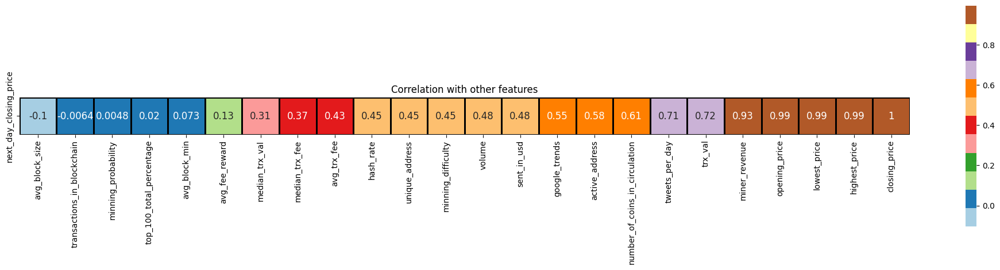

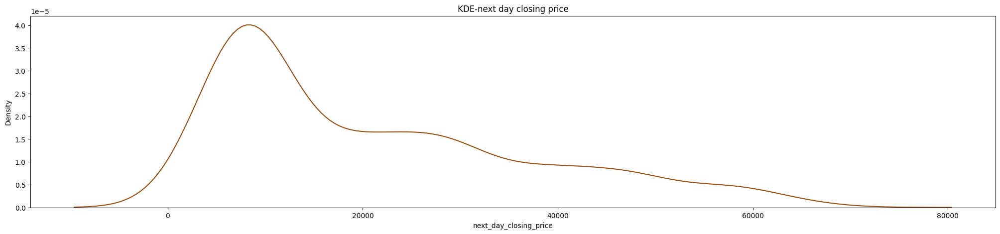

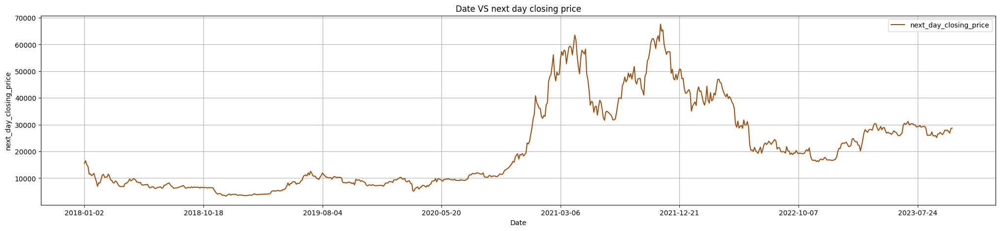

In [239]:
edanum.plot_data(next_day_closing_price_df,feature_name='next_day_closing_price')

### **Observations**

* The distribution is right skewed, which can also be observed in bar plot such that a huge chunk of prices.

* The prices are volatile.

* Miner revenue, which includes both transaction fees and rewards, is well correlated with price.

* Other features with which prices show good correlation are miner revenue, avg_transaction_value,sent_coins_in_usd, avg_mining_difficulty, avg_hashrate.

* Twitter and google trends show the effect of social media. We can interpret it as more people searched or discussed about it, more people invested, which made a positive correlation.


### **Number of transactions in blockchain per day**


* Bitcoin transactions are messages which are digitally signed using cryptography and sent to the entire Bitcoin Network for verification.
* New Blocks are added to the blockchain every 10 minutes.
* Transactions are public and can be found on the digital ledger known as the blockchain.
* The number of daily confirmed transactions highlights the value of the Bitcoin network to securely transfer funds without a third party. i.e. more the transactions, more valuable is the bitcoin network



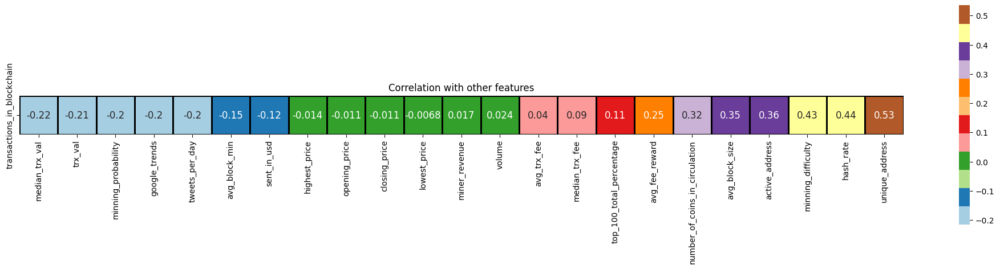

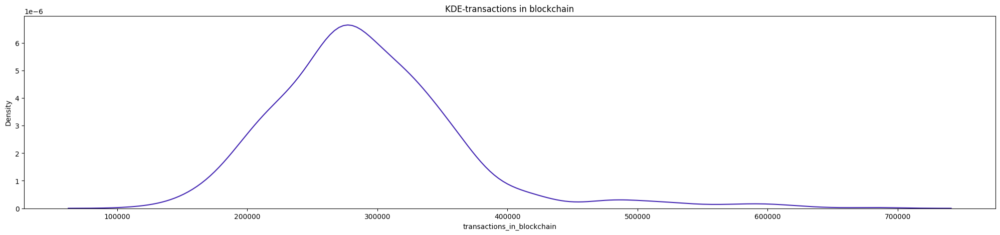

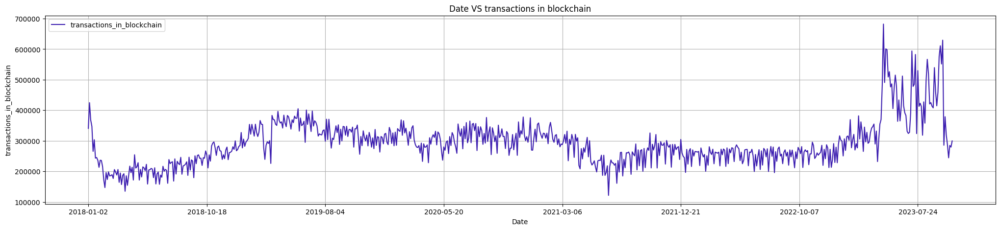

In [240]:
edanum.plot_data(next_day_closing_price_df,feature_name='transactions_in_blockchain')

### **Observations**

* As bitcoins started gaining popularity, there has been a vast increase in the number of payment transactions. ,
* As the transactions increases more blocks will be added to the network, thus increasing its size, which is visible from correlation with block size. Number of sent by address is highly correlated as the transactions are calculated by sent and received payments. \
* It has a less correlation with price of same day which implies higher number of transactions does not increase the price.

### **Average block size(Kb)**

* Blocks are files where transactional information related to the Bitcoin network is permanently recorded, i.e. once written, it cannot be altered or removed.

* It records the most recent Bitcoin transactions that have not yet entered in any prior blocks. Thus, a block is like a page of a ledger. Each time a block is ‘completed’, it gives way to the next block in the blockchain.

* The maximum block size is currently set at 1 megabyte

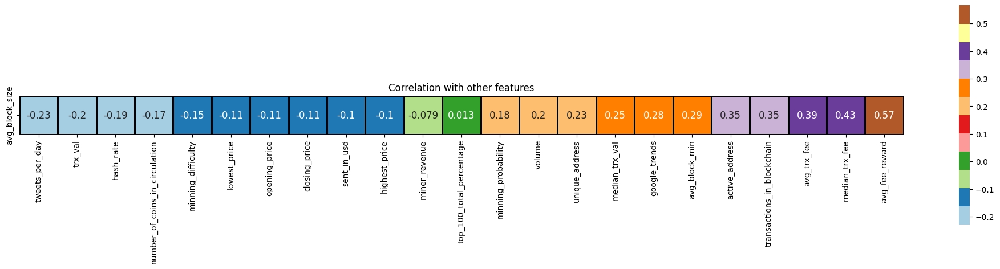

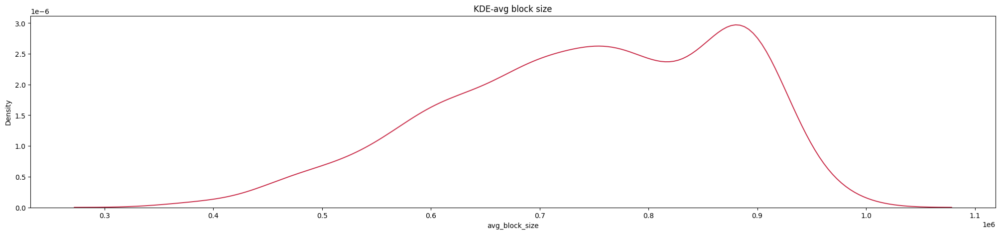

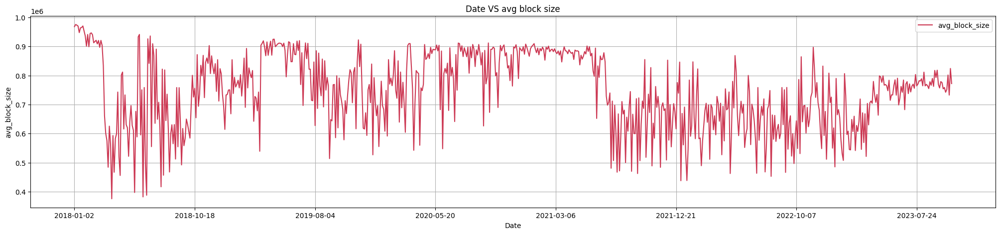

In [241]:
edanum.plot_data(next_day_closing_price_df,feature_name='avg_block_size')

### **Observations**

* Block size follows similar trends to the number of transactions. Which is also visible from its correlation with the number of transactions.

* The increase over time can be linked with gain in popularity of bitcoin

### **Number of sent by adresses and number of active address**

* Sent from addresses are distinct Bitcoin addresses from which payments are made everyday

* active address is the number of unique addresses taking part in a transaction by either sending or receiving Bitcoins

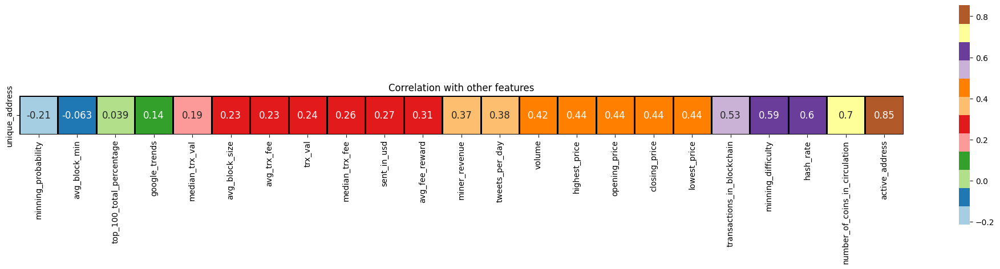

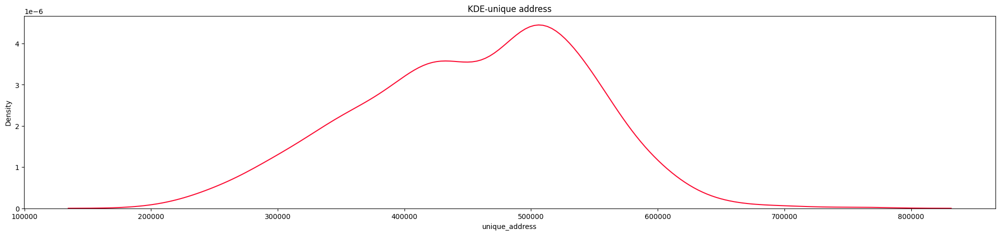

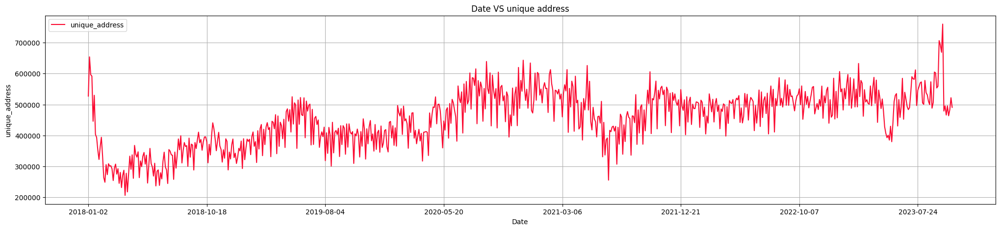

In [242]:
edanum.plot_data(next_day_closing_price_df,feature_name='unique_address')

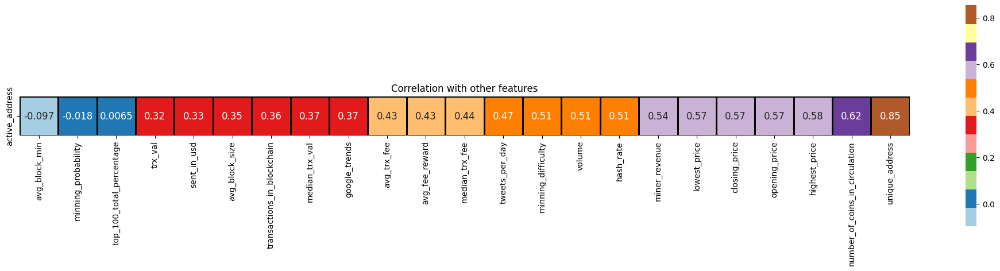

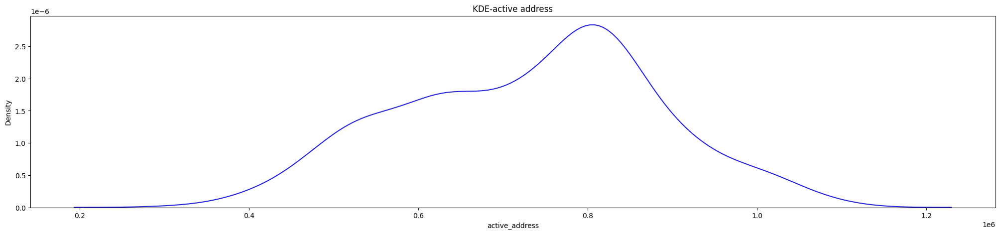

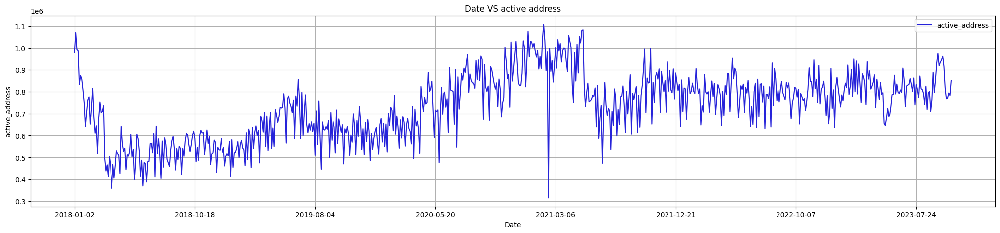

In [243]:
edanum.plot_data(next_day_closing_price_df,feature_name='active_address')

### **Obversations**

* Similar to block size and transactions, the number of sent addresses increased over time and it follows an unskewed distribution
* As sent address is a subset of active addresses, it justifies positive correlation
* Block size will increase as more number of people make a transaction


### **Average mining difficulty per day**

The difficulty level reflects how difficult the proof of work calculation with respect to the difficulty value set at the beginning, i.e., 1.

* A high difficulty means that it will take more computing power to mine the same number of blocks, making the network more secure against attacks.

* The difficulty is adjusted every 2016 blocks (every 2 weeks approximately) so that the average time between each block remains 10 minutes.

* It will be increased if more number of blocks are being created within a 2-week period and will be reduced if less  blocks are created.

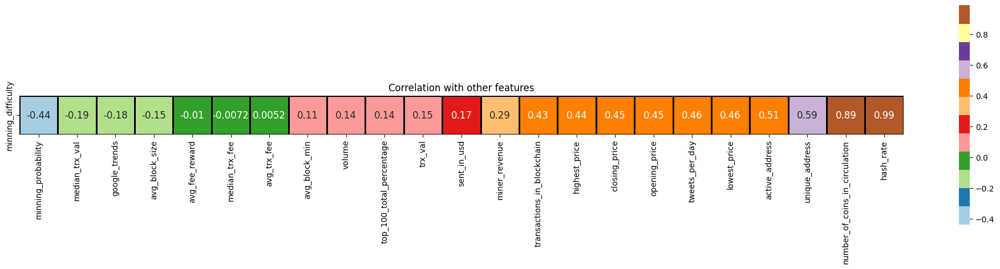

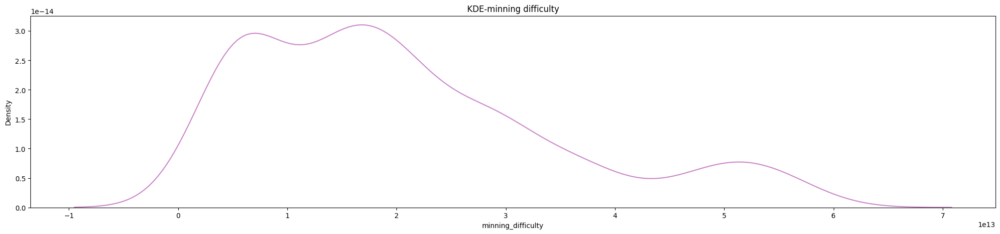

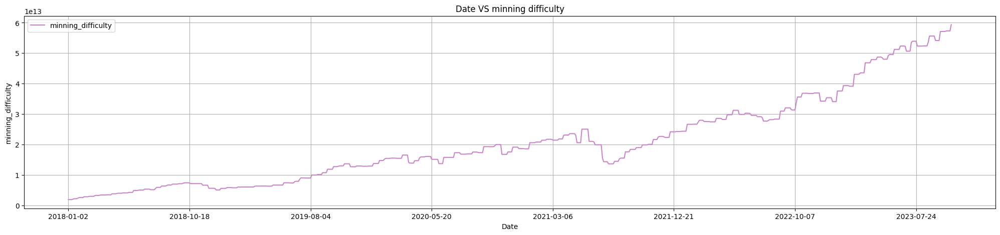

In [244]:
edanum.plot_data(next_day_closing_price_df,feature_name='minning_difficulty')

### **Observations**

* From bar chart we can observe that as bitcoin gained popularity, the number of users increased, making it harder harder to mine the coins.

* As the difficulty increase more processing power, i.e. hash rate is required thus it shows a high correlation with hash rate


### **Average hashrate per day**

* Hashrate is a measure of the computational power per second used when mining. It is measured in of hash/second, meaning how many calculations per second can be performed.

* Machines with a high hash power are highly efficient and can process a lot of data in a single second.

* Mining difficulty directly depends on hash rate

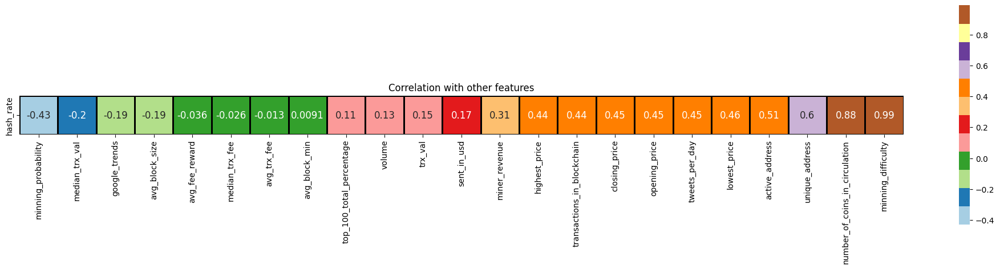

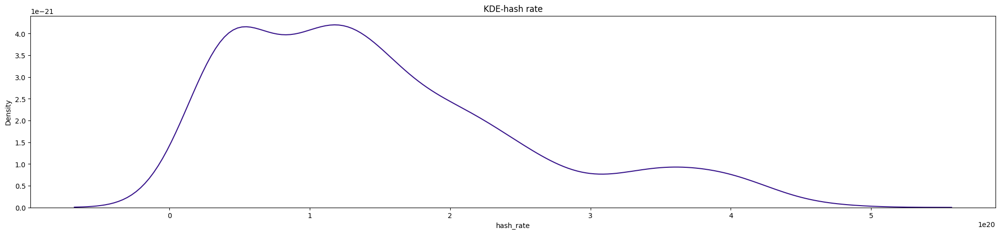

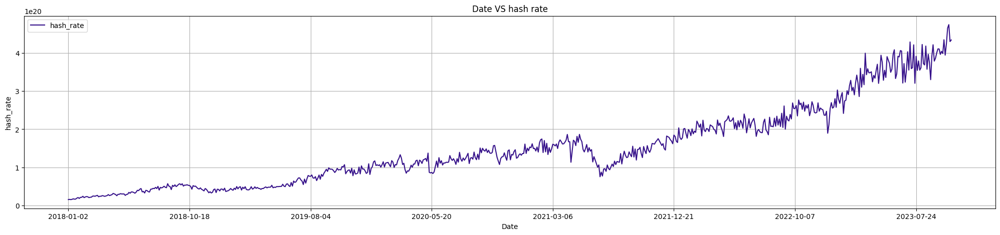

In [245]:
edanum.plot_data(next_day_closing_price_df,feature_name='hash_rate')

### **Observation**

* This follows a very similar trend to mining difficulty as mining difficulty and hashrate are correlated.
* As more people started mining the blocks, it required more hashing power per day, ultimately increasing the difficulty

### **Mining Profitability USD/Day for 1 Hash/s**

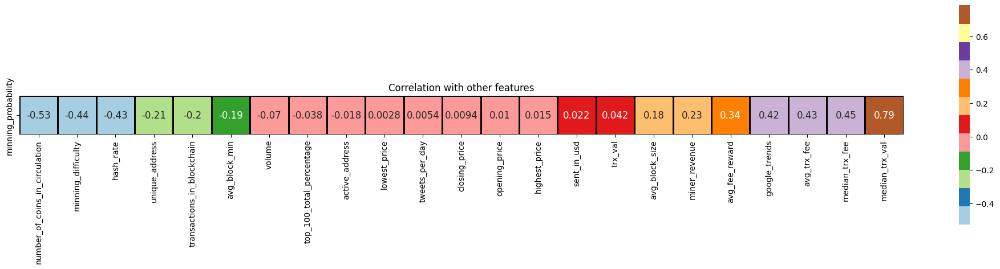

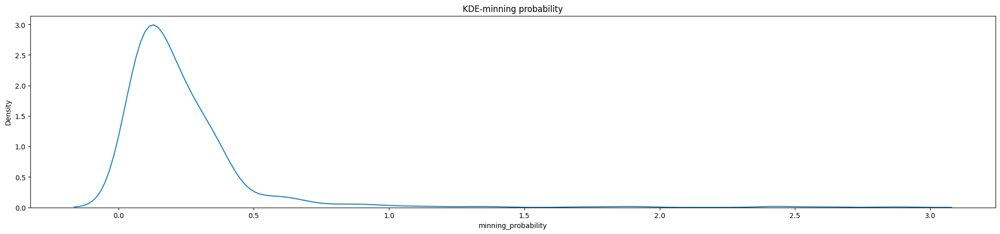

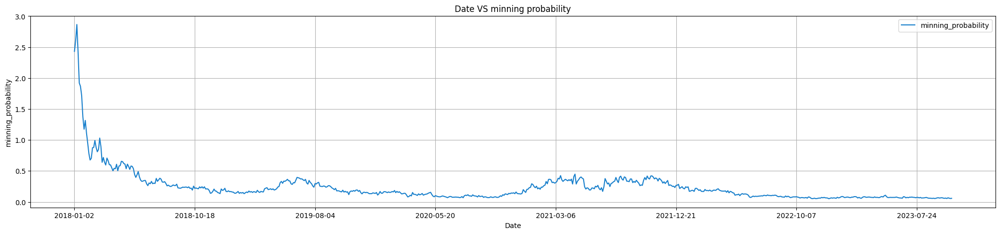

In [246]:
edanum.plot_data(next_day_closing_price_df,feature_name='minning_probability')

### **Observations**

* The distribution is almost evenly distributed.
* The profitability doesn’t have any relation with majority of features but has some positive correlation with top 100 to total ratio.

### **Sent coins in USD per day**

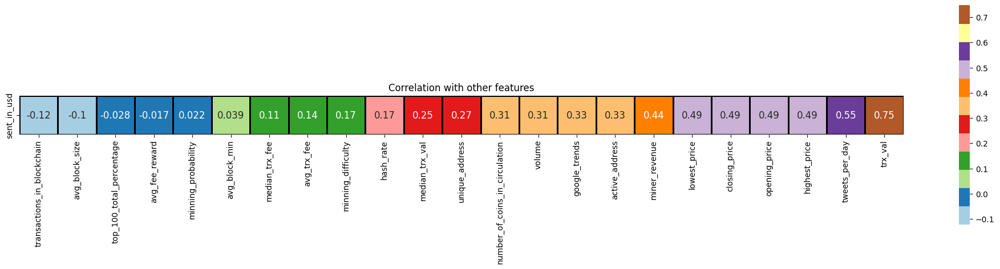

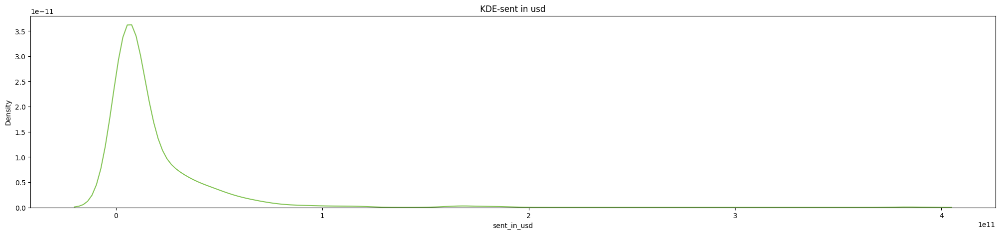

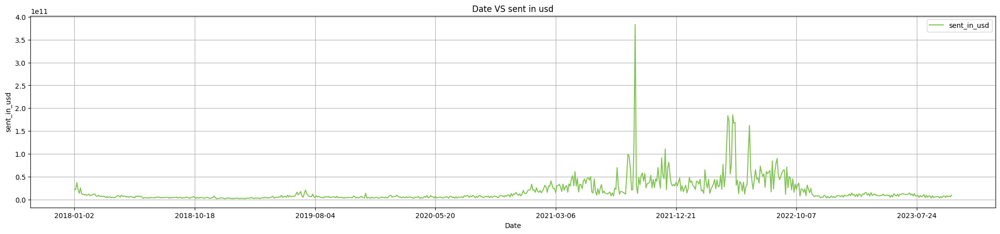

In [247]:
edanum.plot_data(next_day_closing_price_df,feature_name='sent_in_usd')

### **Observations**

* As the prices have increased, the number of transactions also have increased.

* Sent coins has a good correlation with EOD prices, transaction values and google trends.

### **Average & Median transaction fee, USD**

* Each transaction can have an associated transaction fee determined by the sender. The miners who verify the transaction receive the transaction fee.

* Transactions with higher fees reward the Bitcoin miners to process them sooner than transactions with lower fees

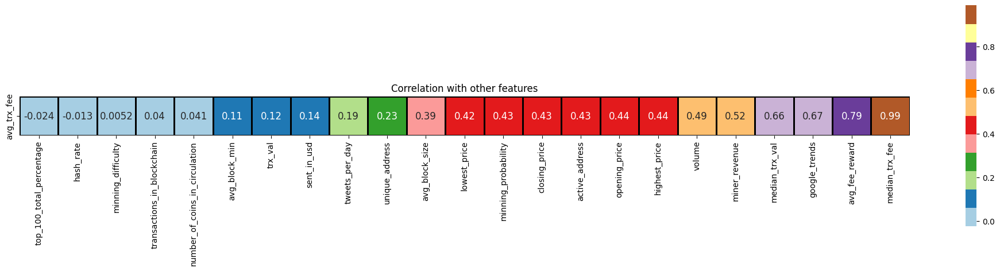

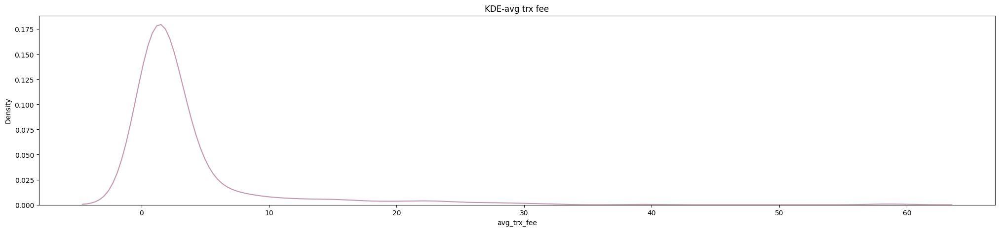

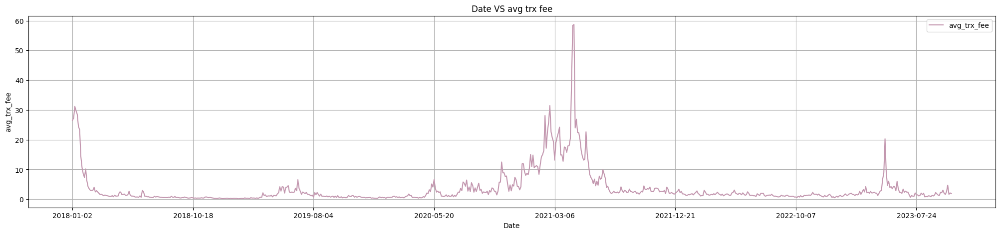

In [248]:
edanum.plot_data(next_day_closing_price_df,feature_name='avg_trx_fee')

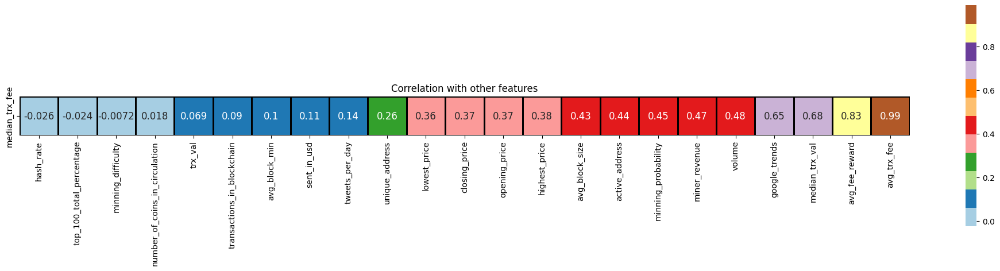

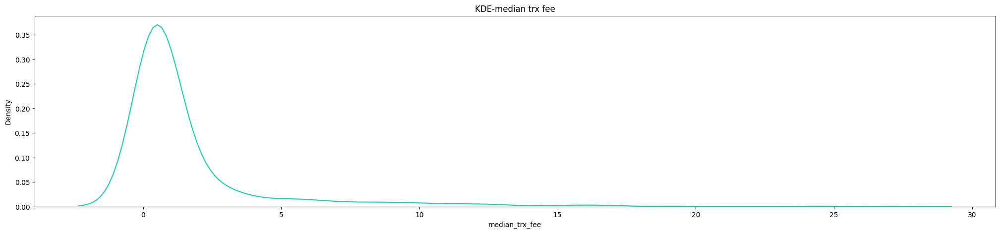

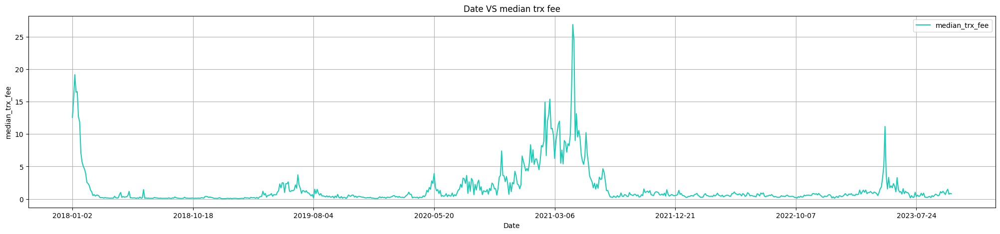

In [249]:
edanum.plot_data(next_day_closing_price_df,feature_name='median_trx_fee')

### **Observations**

* The transaction fees paid to miners has very skewed distribution.
* Intuitively, it can be understood that as prices increased, the fees also increased but with a correlation with price is less than compared to google trends, number of sent coins.

### **Average block time (minutes)**

* Block time is the time required to create the next block in a chain. It is a time taken by a blockchain miner to find a solution to the hash, the random series of characters that are associated with the block.

* For a bitcoin, usually it is around 10 minutes but can fluctuate depending on the hashrate of the network.

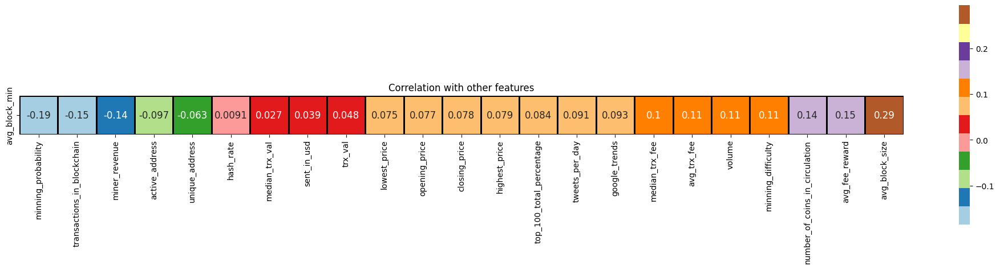

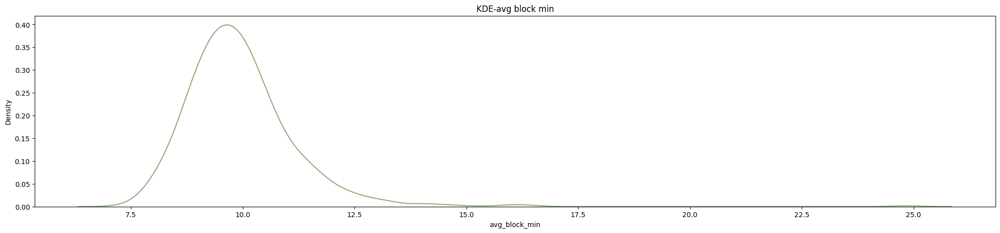

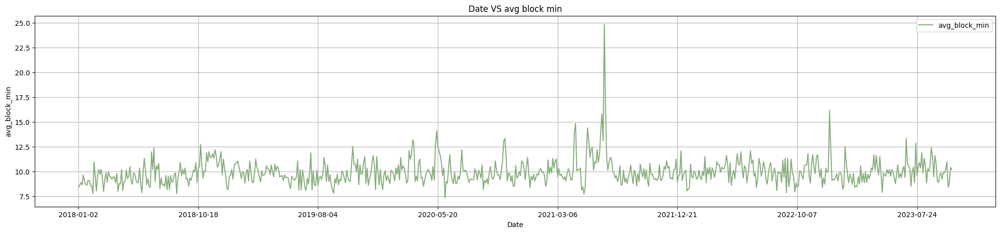

In [250]:
edanum.plot_data(next_day_closing_price_df,feature_name='avg_block_min')

### **Observations**

* The time required to mine a block mostly remains around 10 minute (IQR of 8.79 to 10.2)

* The higher block time implies higher difficulty and lower values tell lower difficulty. We can also observe this from positive correlation with mining difficulty and the number of sent by addresses.

### **Avg. Transaction Value in USD**

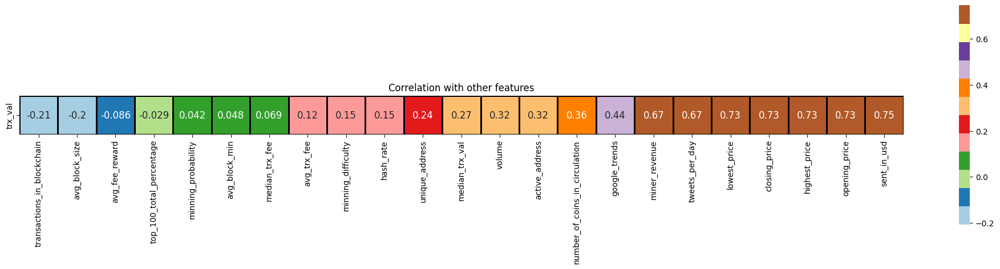

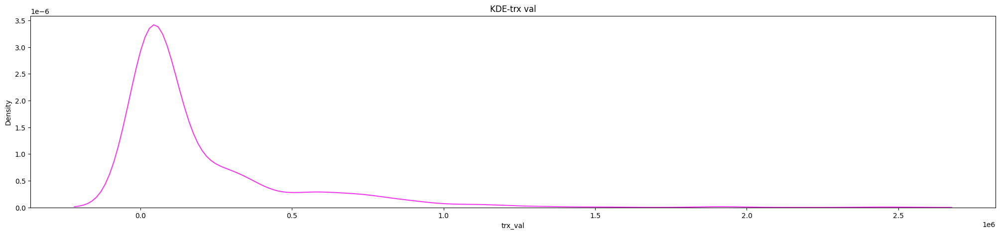

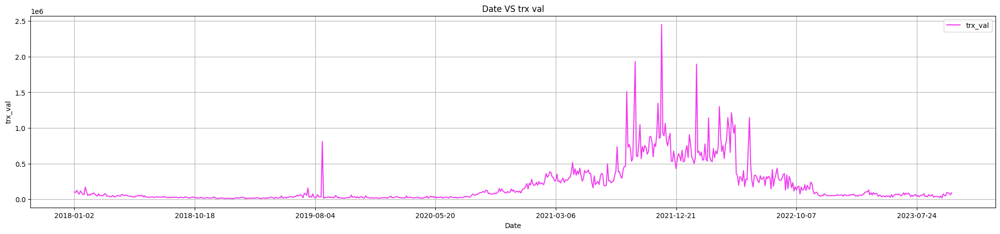

In [251]:
edanum.plot_data(next_day_closing_price_df,feature_name='trx_val')

### **Observations**

* The average transaction increase is because of Bitcoin whales and institutional investors are adding more cryptocurrency to their portfolios.

* As interest in cryptocurrencies increased and cryptocurrency market caps reached peaks, daily transactions also increased to a peak of. This is also visible from high correlation with market cap.

### **Median Transaction Value in USD**

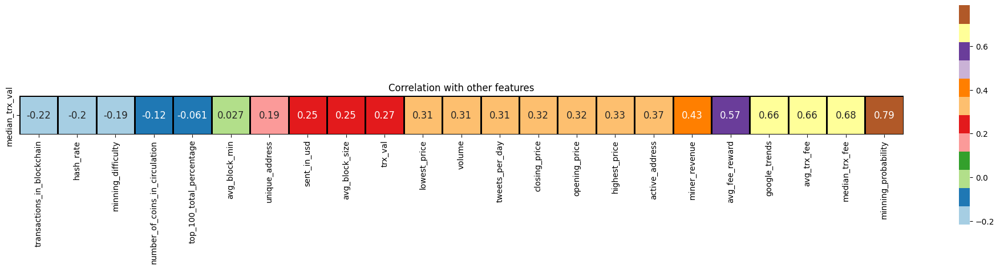

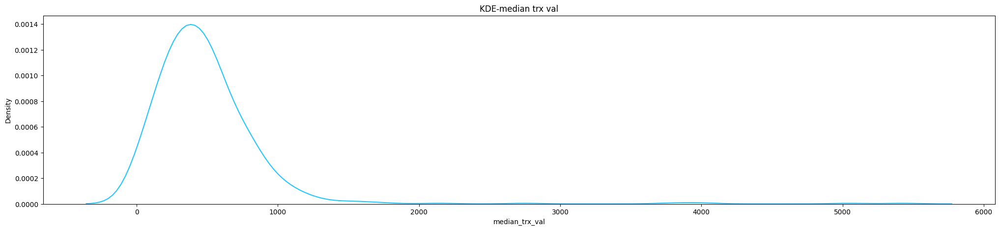

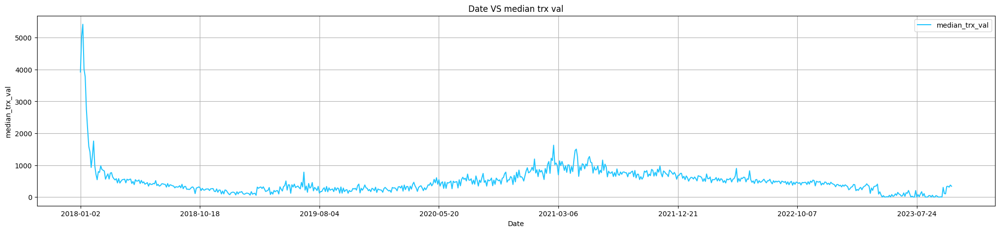

In [252]:
edanum.plot_data(next_day_closing_price_df,feature_name='median_trx_val')

### **Observations**

* Unlike transaction fees, median and avg transaction values are not highly correlated, which implies on a single day there are outliers in transaction value.

* As seen in avg transaction value, Big players are trying to buy more but those transactions are outliers, making median value less correlated to avg.

### **Number of coins in circulation**

* The total number of mined bitcoin that are currently circulating on the network.

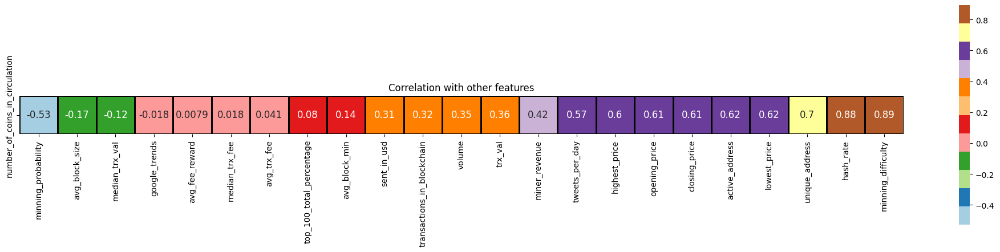

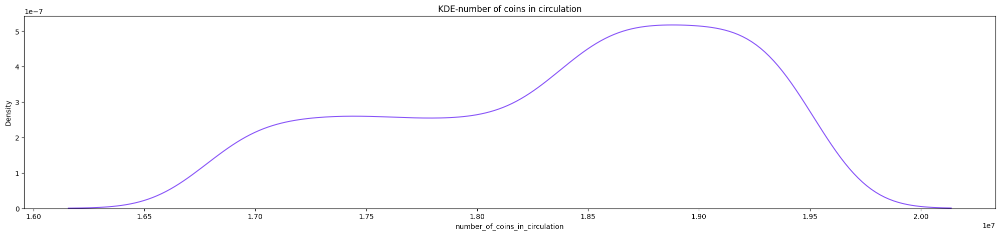

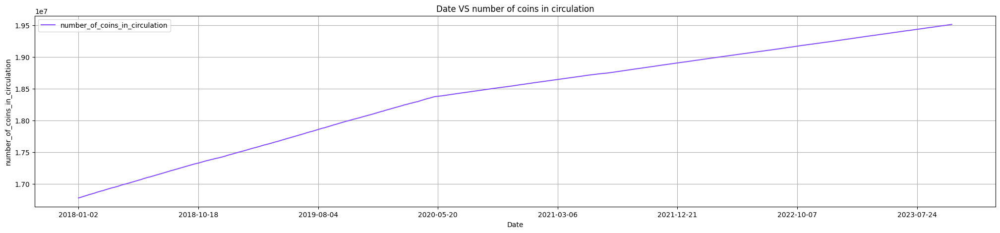

In [253]:
edanum.plot_data(next_day_closing_price_df,feature_name='number_of_coins_in_circulation')

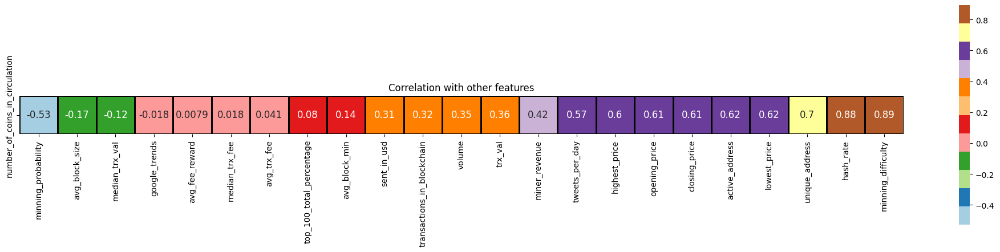

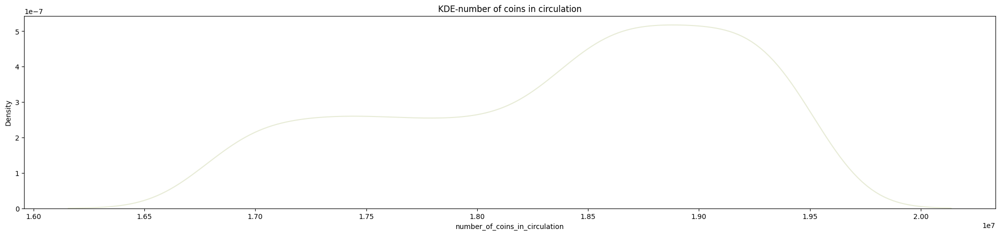

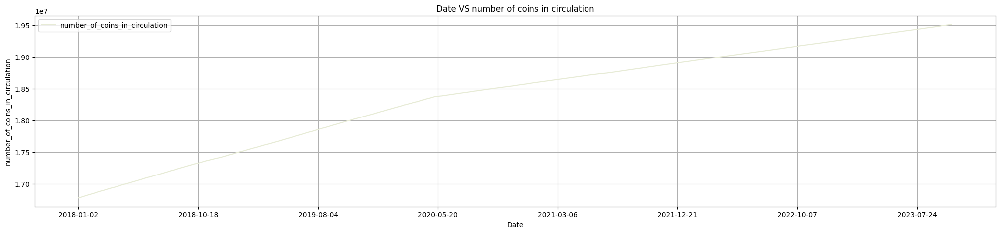

In [254]:
edanum.plot_data(next_day_closing_price_df,feature_name='number_of_coins_in_circulation')

### **Observations**

* This graph shows the supply of bitcoins in the market.

* Although the direct correlation is less, but this feature might be helpful in predicting the price as prices directly depend on supply. currently demand is higher than supply so despite higher supply the prices continue to price


### **Miner Revenue**

* Total value in USD of coinbase block rewards and transaction fees paid to miners.

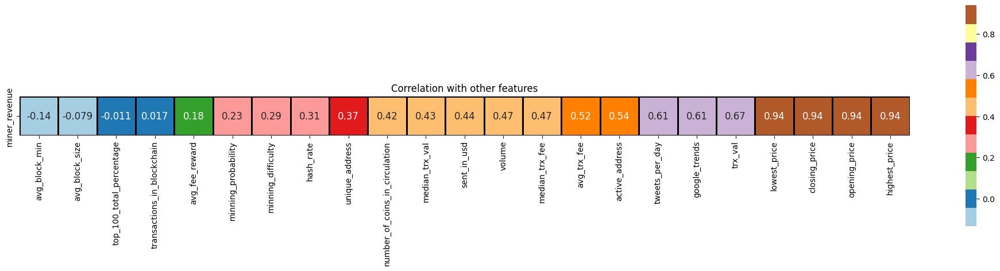

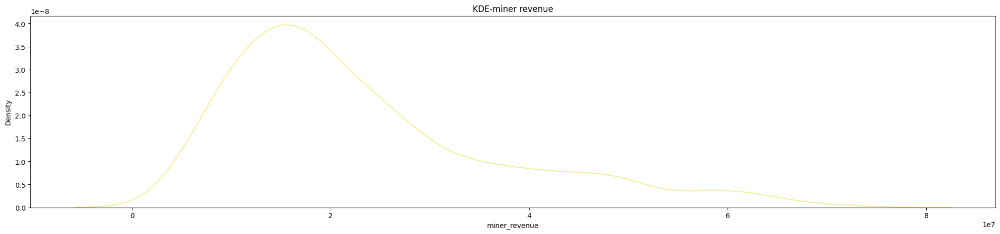

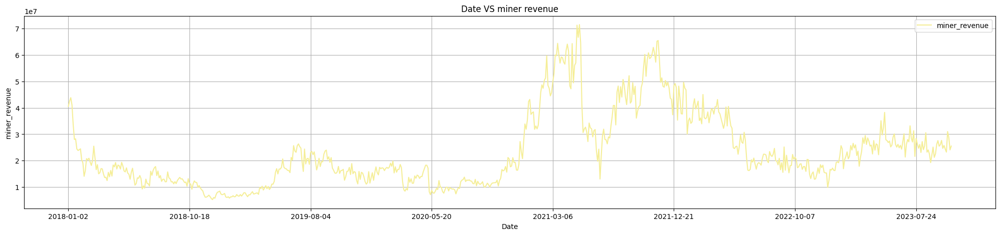

In [255]:
edanum.plot_data(next_day_closing_price_df,feature_name='miner_revenue')


### Observations

* The distribution is heavy peaked and right skewed.

* As the prices have increased, the number of transactions also have increased.

* Sent coins has a good correlation with EOD prices, transaction values and google trends.

### **Tweets & Google Trends per day**

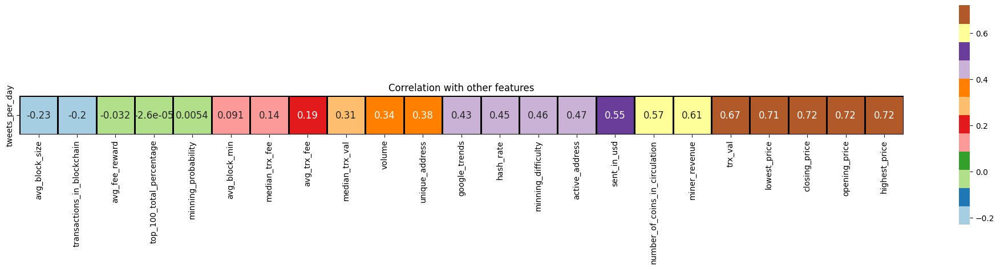

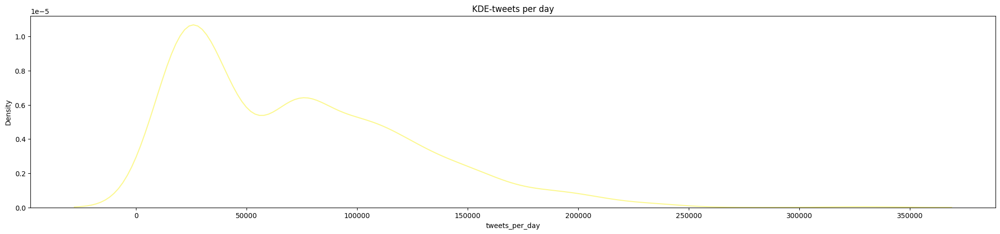

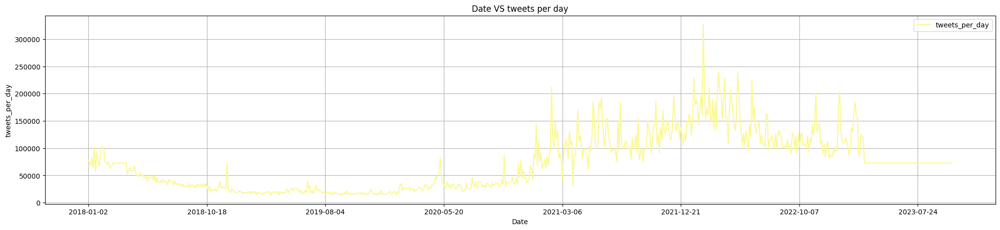

In [256]:
edanum.plot_data(next_day_closing_price_df,feature_name='tweets_per_day')


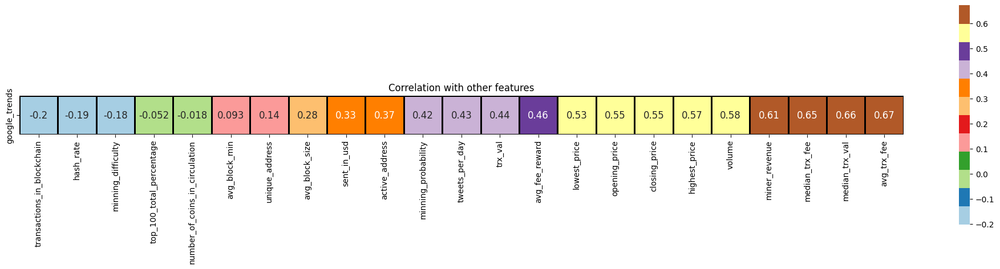

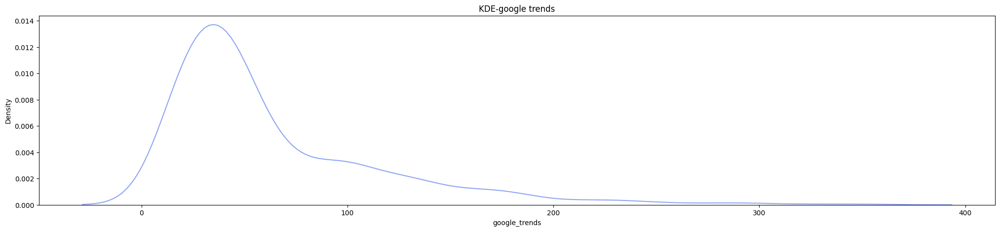

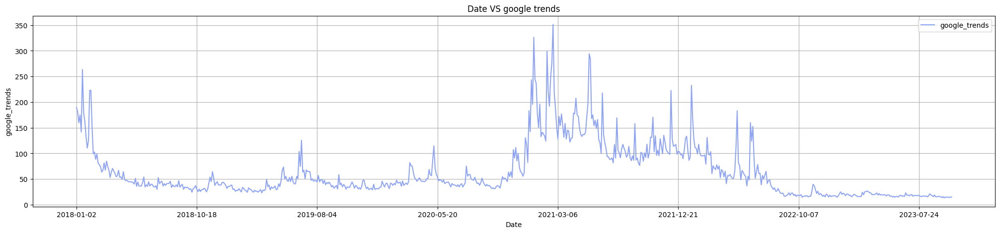

In [257]:
edanum.plot_data(next_day_closing_price_df,feature_name='google_trends')


### **Observations**

* Both social media trends seem useful for prediction as both of them show a good correlation with each other and a positive correlation with price.

* As bitcoin is a digital currency, it affects the social media such that if prices increase or as the number of sent coins increase, bitcoin trends on social media

### **Top 100 Richest Addresses**

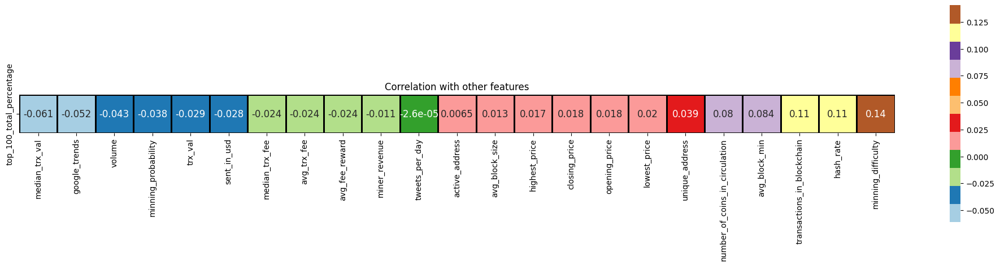

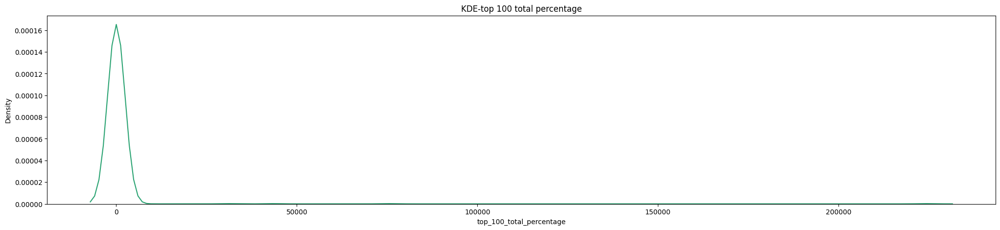

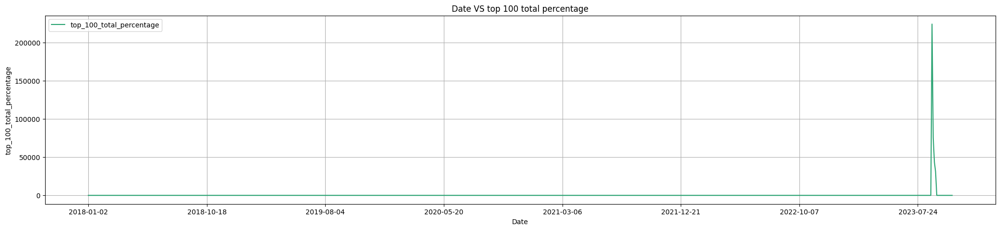

In [258]:
edanum.plot_data(next_day_closing_price_df,feature_name='top_100_total_percentage')


### **Fee Percentage in Total Block**

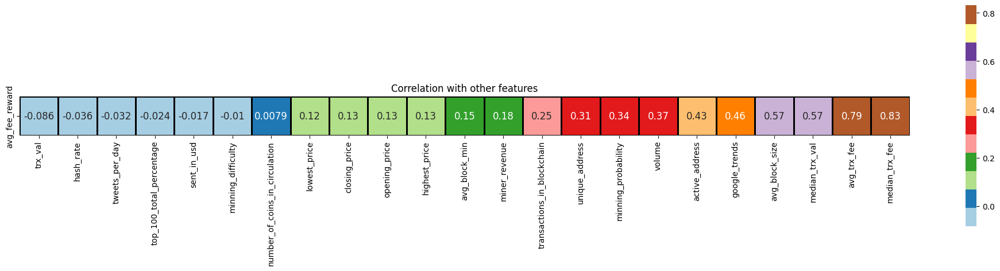

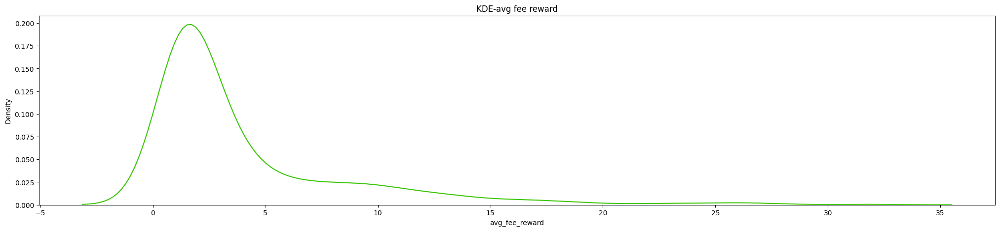

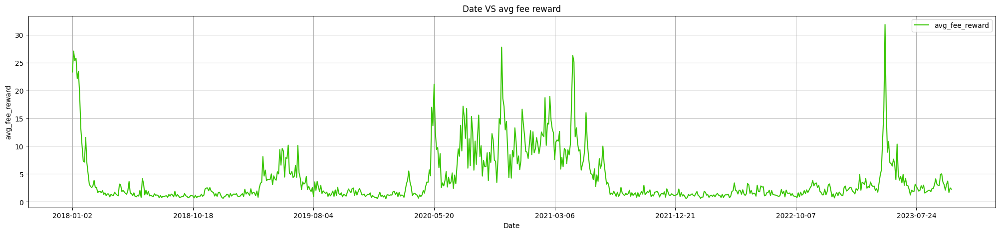

In [259]:
edanum.plot_data(next_day_closing_price_df,feature_name='avg_fee_reward')

### **Observations**

* The correlation with transaction fees is expected but also can be observed with google trends and number of sent by address.

# **Feature Engineering**

In [260]:
# https://www.investopedia.com/terms/d/data-smoothing.asp
clean_data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/data/raw_output/clean_raw_data.csv',sep=',',encoding='UTF-8',index_col=0)
clean_data.head()

,Date,opening_price,highest_price,lowest_price,closing_price,volume,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,...,trx_val,median_trx_val,tweets_per_day,google_trends,active_address,top_100_total_percentage,avg_fee_reward,number_of_coins_in_circulation,miner_revenue,next_day_closing_price
0,2018-01-02,13625.000000,15444.599609,13163.599609,14982.099609,1.684660e+10,340809,968332,527209,1931136454488,...,103561,3921.0,77723.0,189.385,982159,18.050,23.304,16778587.5,4.055333e+07,15599.200195
1,2018-01-04,15270.700195,15739.700195,14522.200195,15599.200195,2.178320e+10,424840,975713,653949,1931136454488,...,95838,5033.0,74534.0,181.447,1071574,18.021,27.047,16782650.0,4.252780e+07,16477.599609
2,2018-01-07,17527.300781,17579.599609,16087.700195,16477.599609,1.586600e+10,368025,973489,596370,1931136454488,...,125268,5417.0,67259.0,159.809,994708,17.959,25.316,16788562.5,4.382667e+07,14973.299805
3,2018-01-10,14588.500000,14973.299805,13691.200195,14973.299805,1.850080e+10,347227,970310,591685,1931136454488,...,89169,4016.0,82357.0,174.824,989424,18.053,25.778,16794762.5,4.106817e+07,14360.200195
4,2018-01-13,13952.400391,14659.500000,13952.400391,14360.200195,1.276360e+10,265586,947784,445886,2134254177774,...,73722,3769.0,63396.0,141.710,834309,18.171,22.112,16801262.5,3.360322e+07,11490.500000


In [261]:
# Data smoothing is done by using an algorithm to remove noise from a data set. This allows important patterns to more clearly stand out.
class DataSmoothing:

  def MovingAverages(self,df,feature_name,smoothening_type,show_plot=True,show_original_Feature_in_plot=False,smoothening_range=[7,30,90]):
    if smoothening_type == 'sma':
      for j in smoothening_range:
        df[f'{smoothening_type}{j} {feature_name}'] = ta.sma(df[feature_name],j)

    elif smoothening_type == 'wma':
        for j in smoothening_range:
            df[f'{smoothening_type}{j} {feature_name}'] = ta.wma(df[feature_name],j)

    elif smoothening_type == 'ema':
        for j in smoothening_range:
            df[f'{smoothening_type}{j} {feature_name}'] = ta.ema(df[feature_name],j)

    if show_plot == True and show_original_Feature_in_plot==True :
        df[[feature_name]+[i for i in list(df.columns) if i.split(" ")[-1] == feature_name and i.split(" ")[0][0:len(smoothening_type)] == smoothening_type]].plot(kind='line',figsize=(25,5))
        plt.grid()
        plt.title(f'Data Smoothening-{feature_name} by {smoothening_type}')
        plt.xticks([])
        plt.show()

    elif show_plot == True and show_original_Feature_in_plot==False :
        df[[i for i in list(df.columns) if i.split(" ")[-1] == feature_name and i.split(" ")[0][0:len(smoothening_type)] == smoothening_type]].plot(kind='line',figsize=(25,5))
        plt.grid()
        plt.title(f'Data Smoothening-{feature_name} by {smoothening_type}')
        plt.xticks([])
        plt.show()


  def StatisticalAnalysis(self,df,feature_name,smoothening_type,show_plot,show_original_Feature_in_plot,smoothening_range=[7,30,90]):
    if smoothening_type == 'var':
        for j in smoothening_range:
            df[f'{smoothening_type}{j} {feature_name}'] = ta.variance(df[feature_name],j)

    elif smoothening_type == 'stdev':
        for j in smoothening_range:
            df[f'{smoothening_type}{j} {feature_name}'] = ta.stdev(df[feature_name],j)

    if show_plot == True and show_original_Feature_in_plot==True :
        df[[feature_name]+[i for i in list(df.columns) if i.split(" ")[-1] == feature_name and i.split(" ")[0][0:len(smoothening_type)] == smoothening_type]].plot(kind='line',figsize=(25,5))
        plt.grid()
        plt.title(f'Data Smoothening-{feature_name} by {smoothening_type}')
        plt.xticks([])
        plt.show()

    elif show_plot == True and show_original_Feature_in_plot==False :
        df[[i for i in list(df.columns) if i.split(" ")[-1] == feature_name and i.split(" ")[0][0:len(smoothening_type)] == smoothening_type]].plot(kind='line',figsize=(25,5))
        plt.grid()
        plt.title(f'Data Smoothening-{feature_name} by {smoothening_type}')
        plt.xticks([])
        plt.show()


da = DataSmoothing()


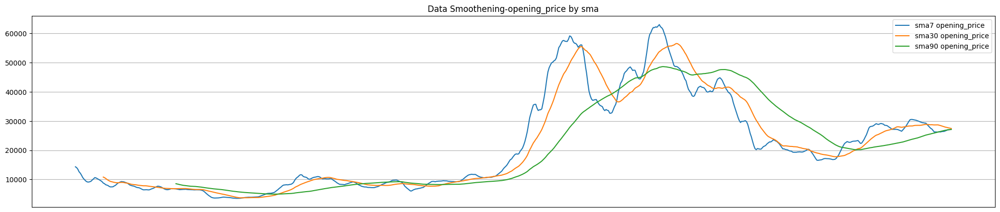

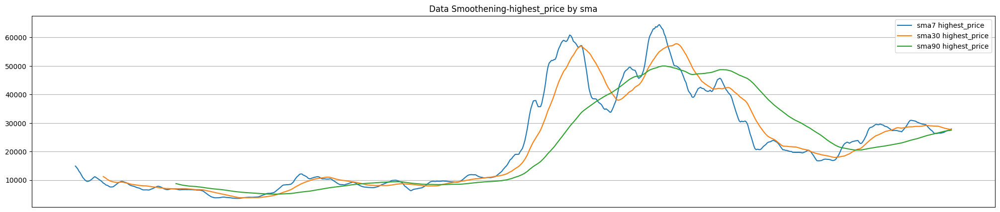

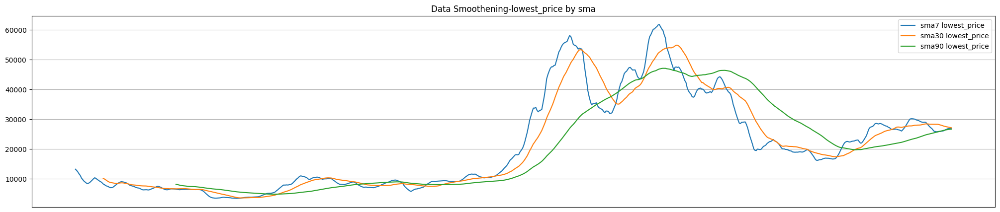

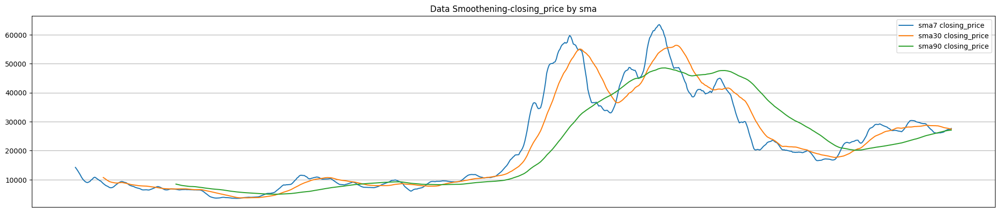

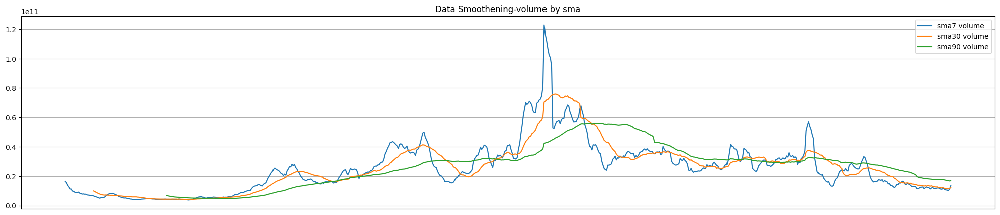

...

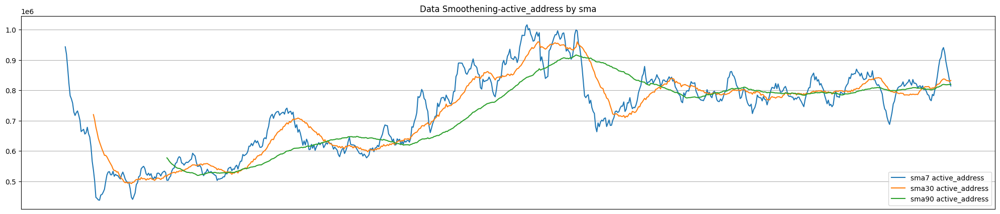

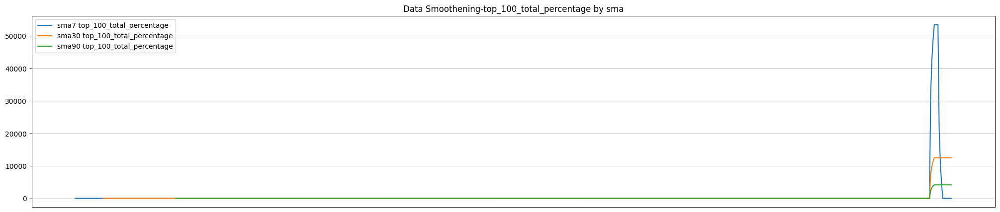

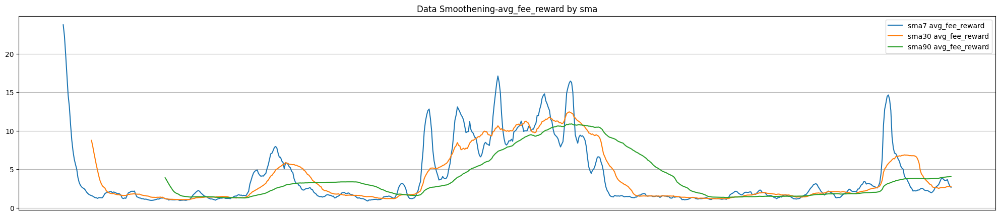

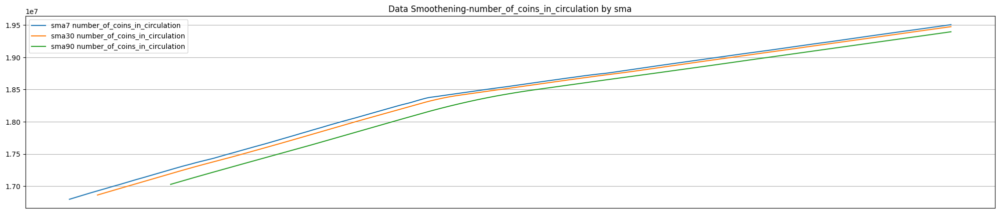

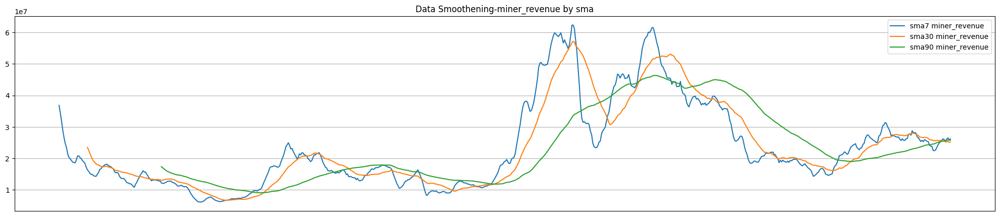

In [262]:
features = [i for i in list(clean_data.columns) if i not in ['Date','next_day_closing_price']]
#print(features)
data_smoothening = clean_data.copy()
for feature in features:
  da.MovingAverages(data_smoothening,feature,'sma',show_plot=True)

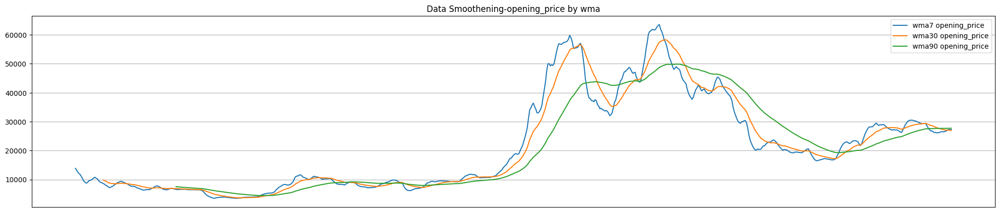

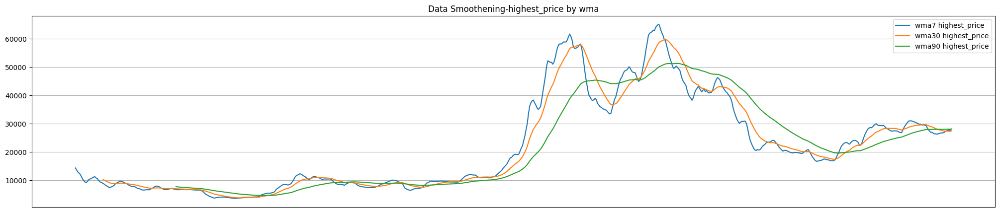

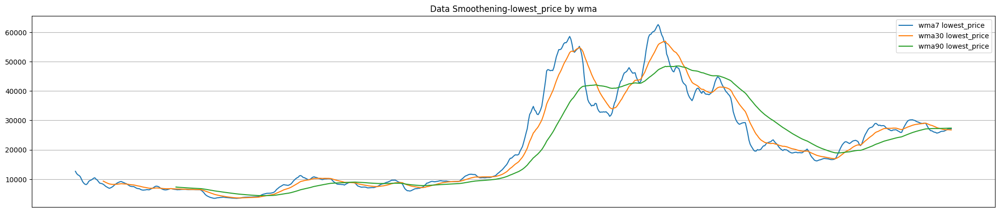

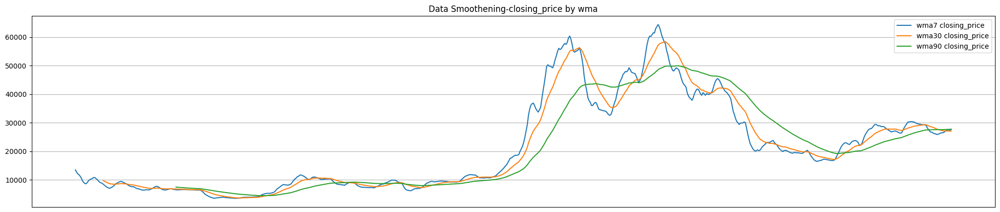

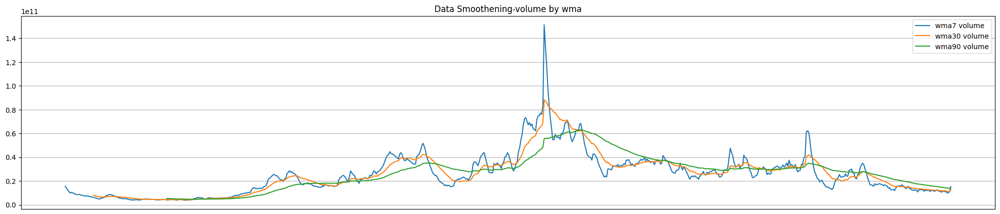

...

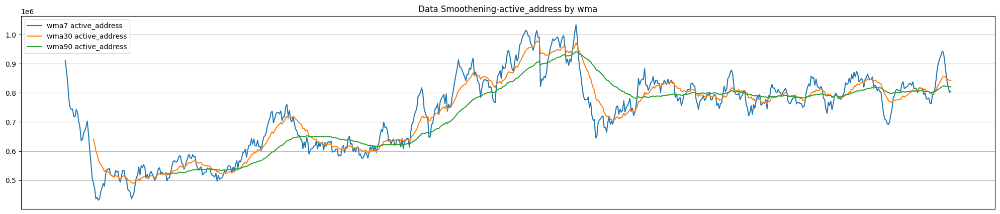

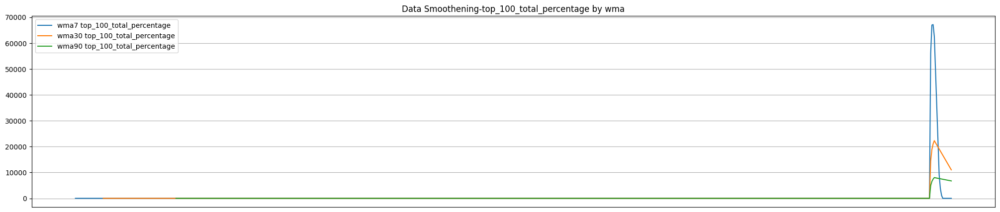

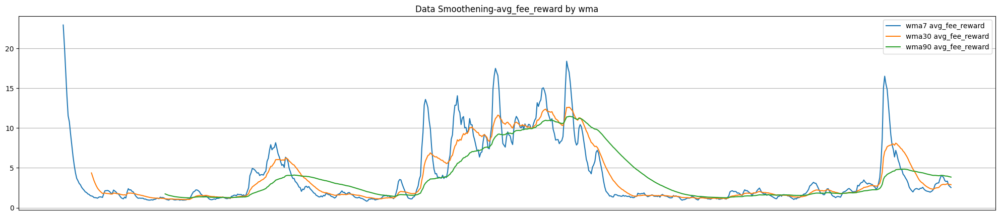

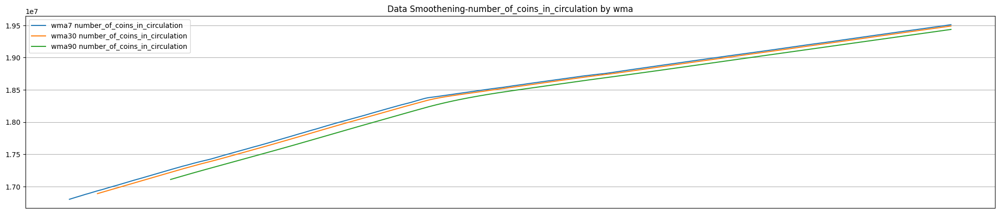

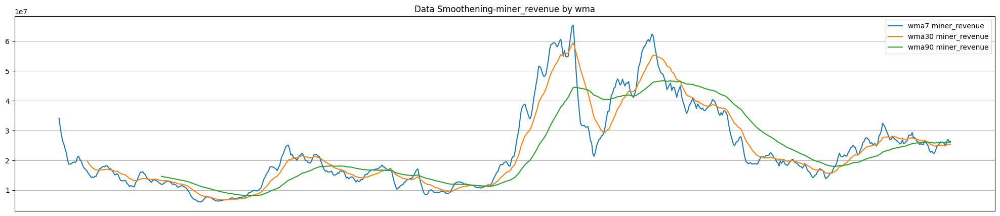

In [263]:
for feature in features:
  da.MovingAverages(data_smoothening,feature,'wma',show_plot=True)

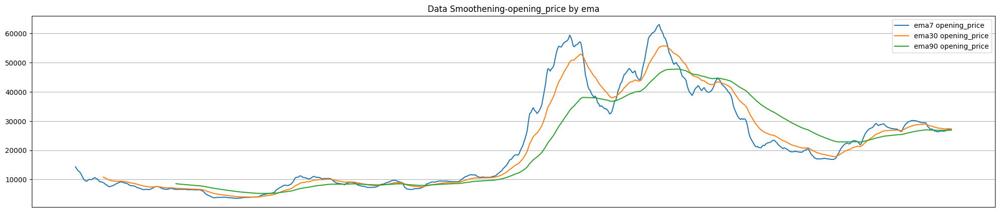

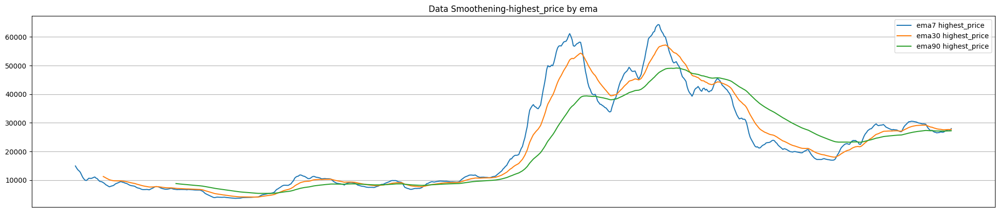

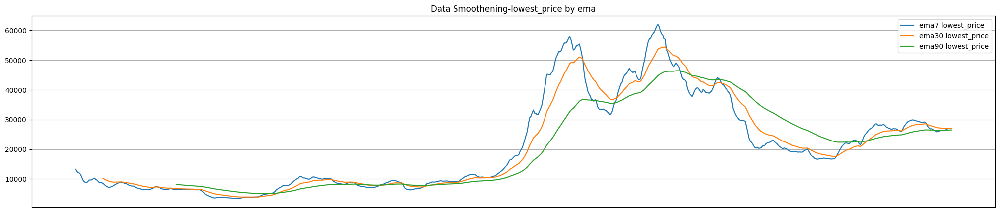

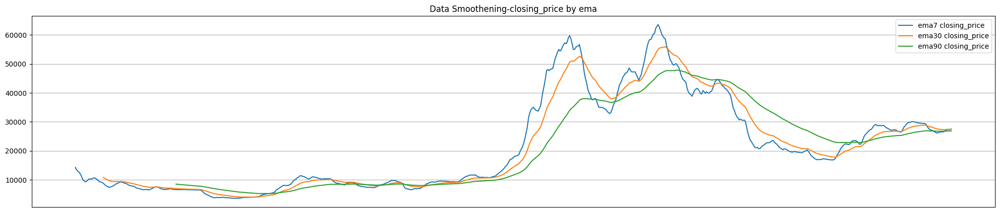

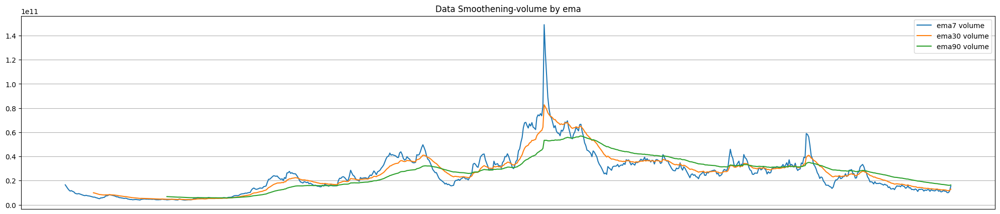

...

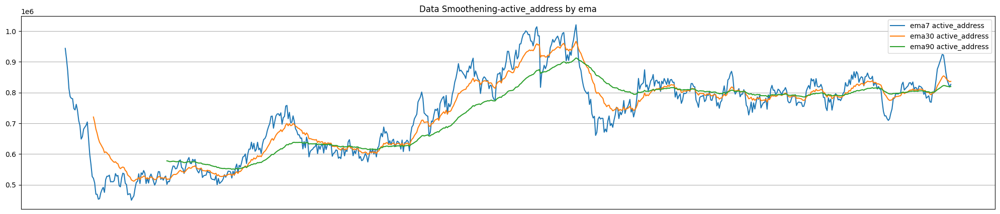

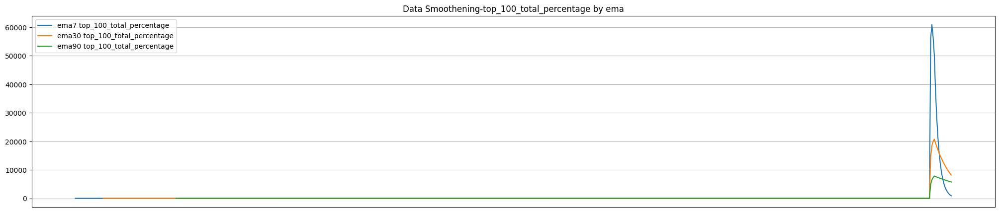

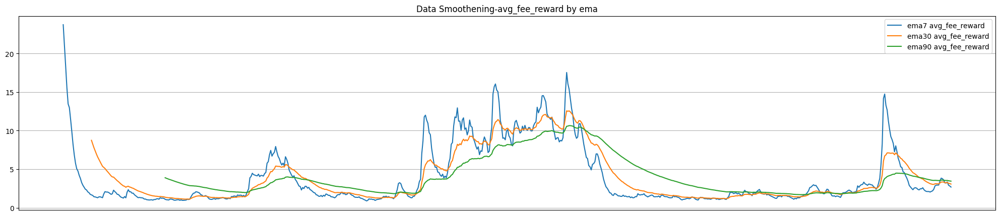

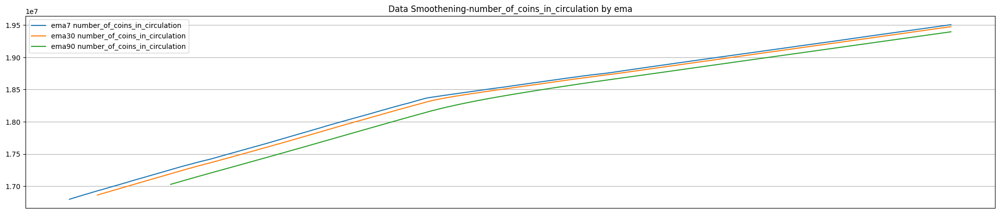

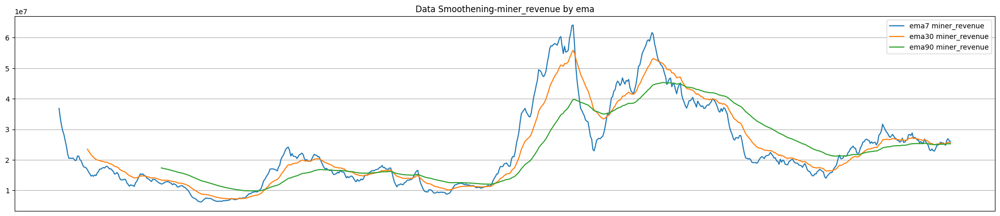

In [264]:
for feature in features:
  da.MovingAverages(data_smoothening,feature,'ema',show_plot=True)

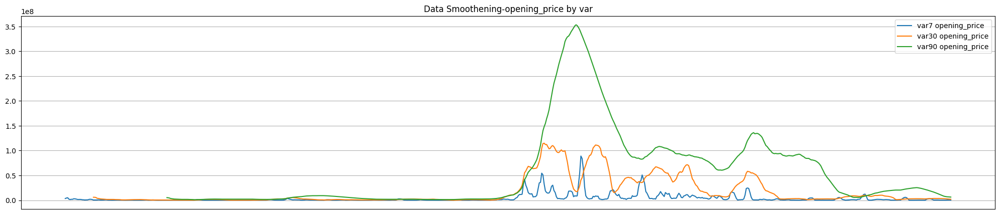

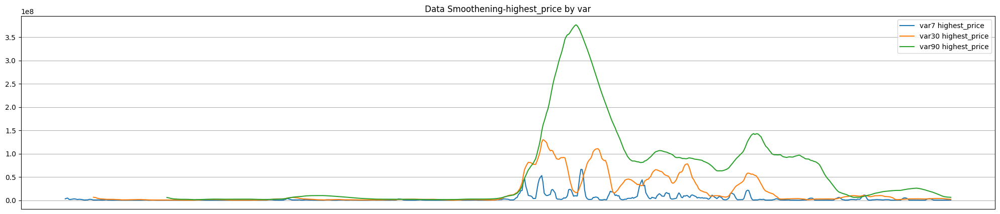

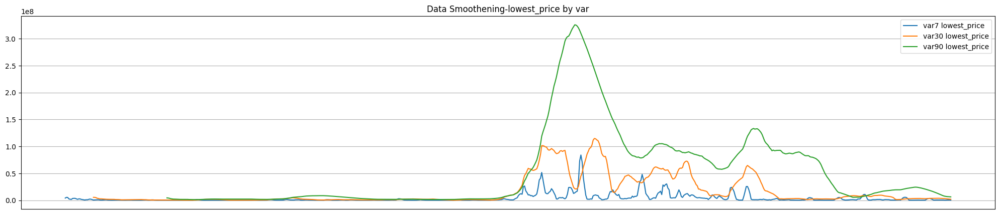

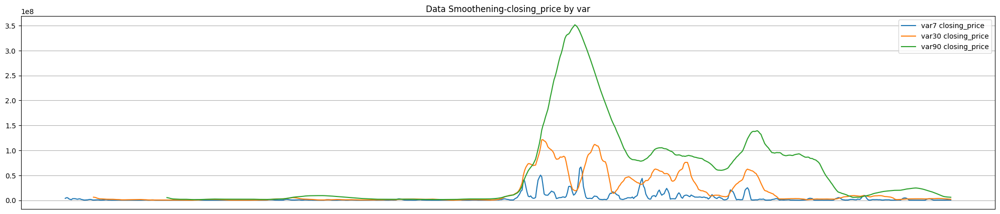

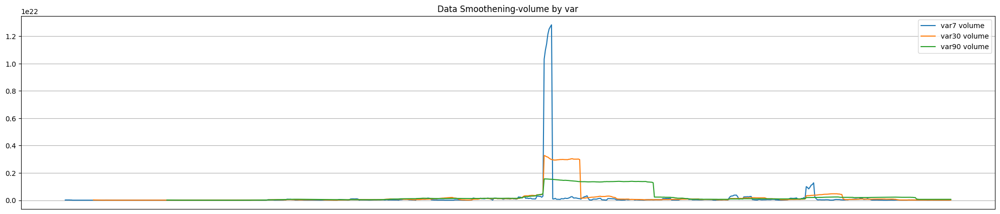

...

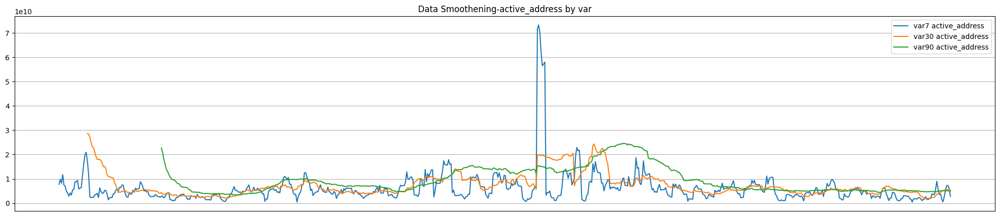

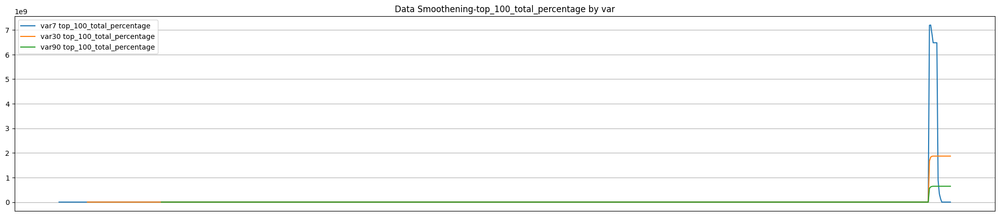

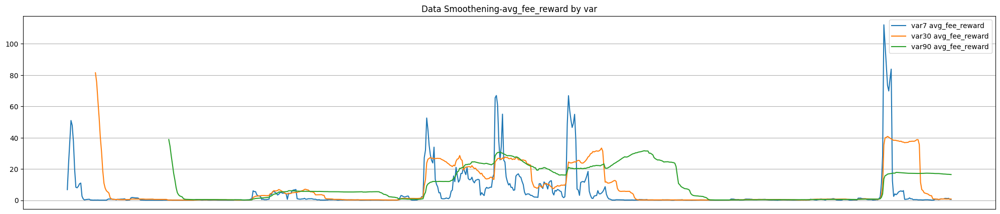

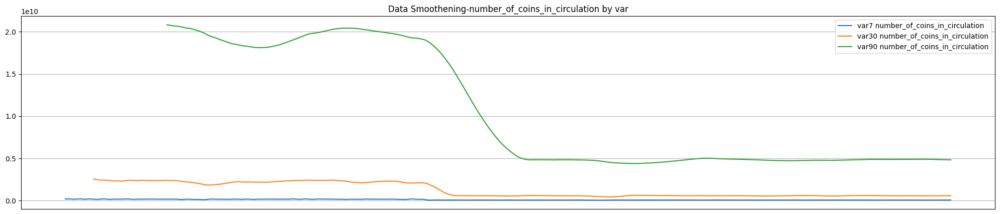

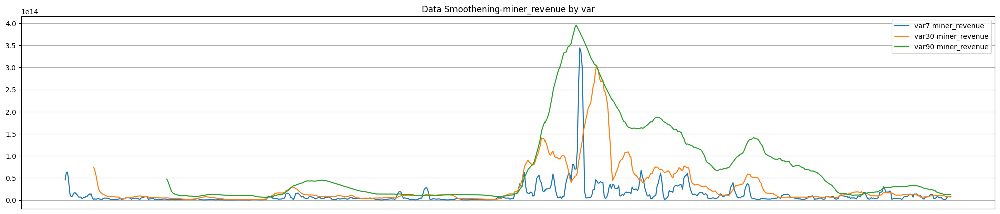

In [265]:
for feature in features:
  da.StatisticalAnalysis(data_smoothening,feature,'var',show_plot=True,show_original_Feature_in_plot=False)

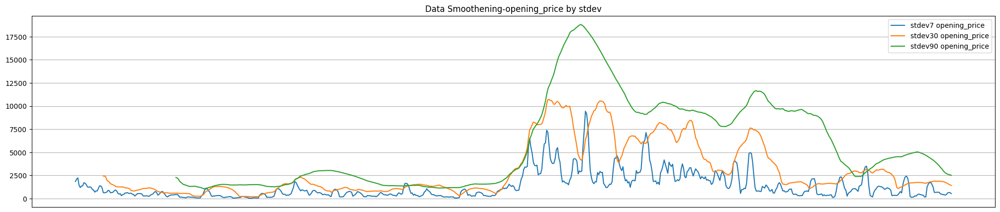

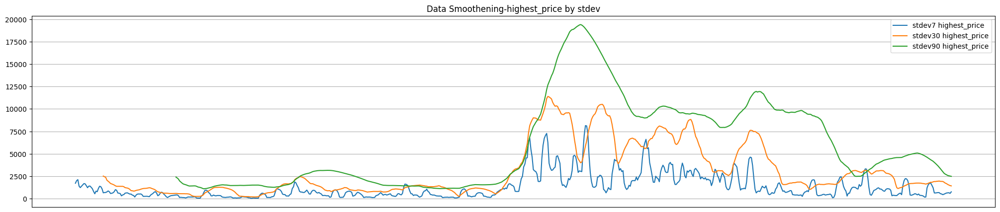

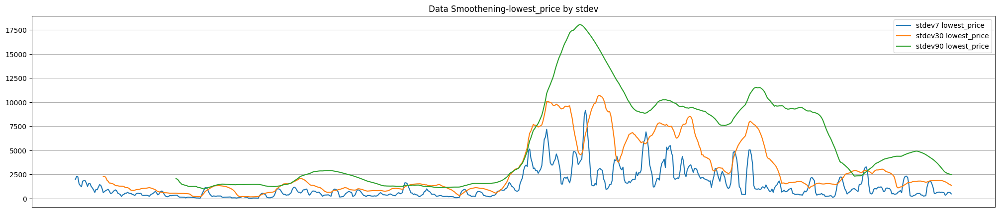

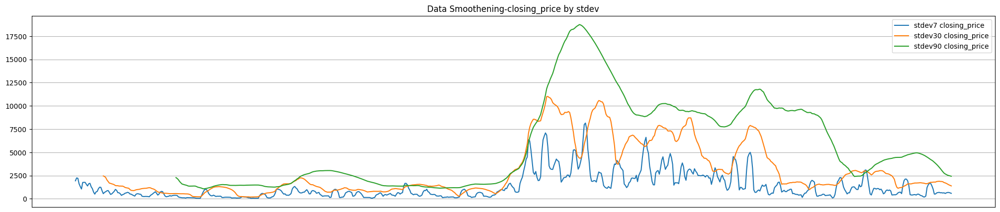

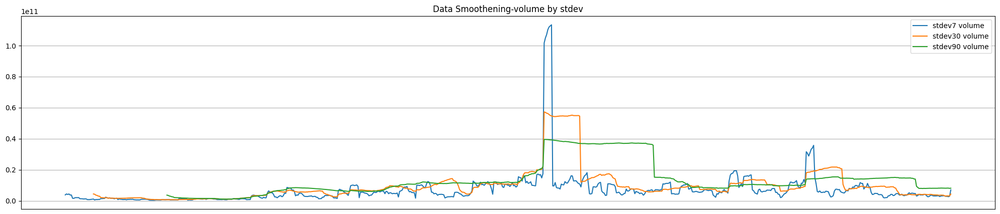

...

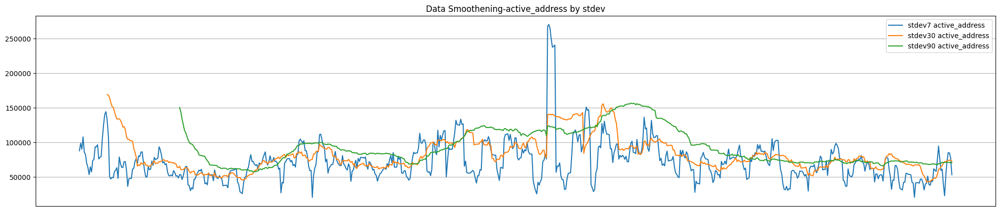

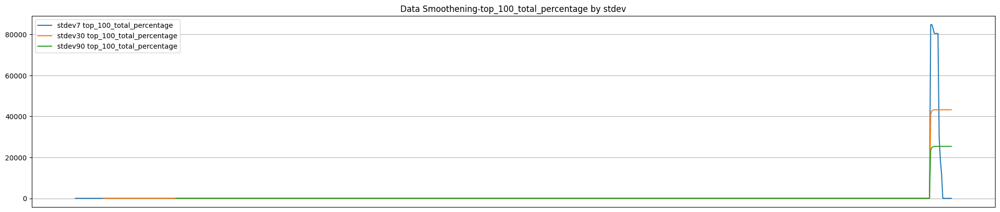

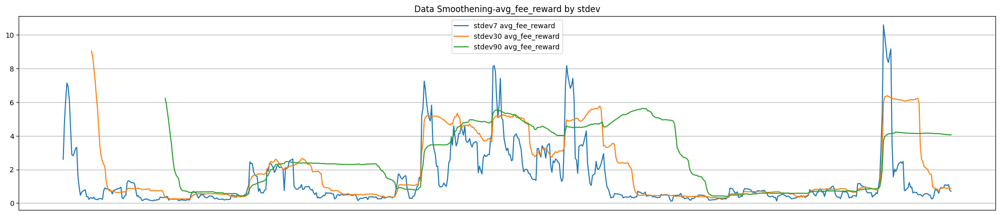

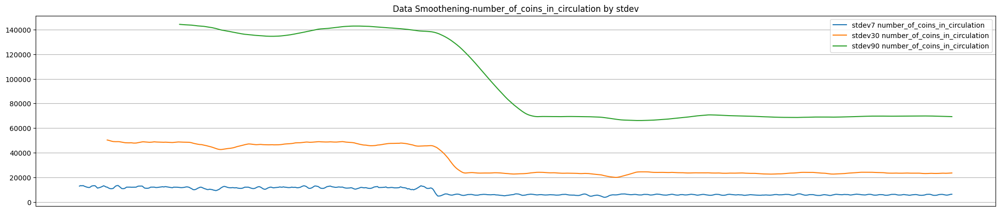

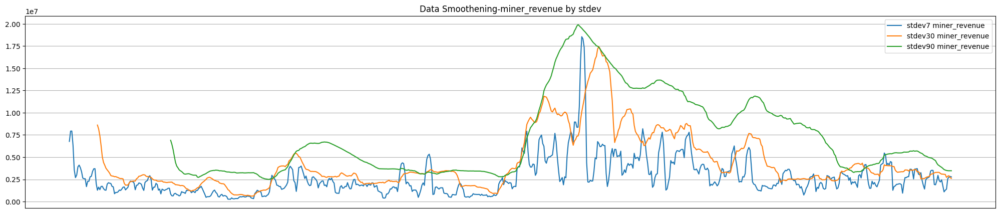

In [266]:
for feature in features:
  da.StatisticalAnalysis(data_smoothening,feature,'stdev',show_plot=True,show_original_Feature_in_plot=False)

In [267]:
data_smoothening.shape
data_smoothening = data_smoothening[(data_smoothening['Date'] >= '2020-01-01')].fillna(method='bfill')

In [268]:
data_smoothening.to_csv('/content/drive/MyDrive/Colab Notebooks/data/raw_output/data_smoothening.csv',index=True)

# **Feature Selection**

In [269]:
feature_data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/data/raw_output/data_smoothening.csv',sep=',',encoding='UTF-8',index_col=0)
feature_data=preproc.RemoveNansfromDataframe(feature_data)
feature_data.head()

,Date,opening_price,highest_price,lowest_price,closing_price,volume,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,...,stdev90 top_100_total_percentage,stdev7 avg_fee_reward,stdev30 avg_fee_reward,stdev90 avg_fee_reward,stdev7 number_of_coins_in_circulation,stdev30 number_of_coins_in_circulation,stdev90 number_of_coins_in_circulation,stdev7 miner_revenue,stdev30 miner_revenue,stdev90 miner_revenue
252,2020-01-02,7202.551122,7212.155253,6935.269972,6985.470001,2.080208e+10,295426,696127,363285,13798783827516,...,0.536079,0.328580,0.514227,2.308703,12336.086608,45954.720101,142237.286697,1.907584e+06,2.074228e+06,4.255107e+06
253,2020-01-05,7410.451694,7544.496872,7400.535561,7411.317327,1.972507e+10,287616,555135,346762,13798783827516,...,0.530861,0.344138,0.537487,2.321112,12466.692830,46177.589168,142190.159221,1.852790e+06,1.991778e+06,4.199018e+06
254,2020-01-07,7768.681891,8178.215873,7768.227719,8163.692239,2.876729e+10,343903,674910,442569,13798783827516,...,0.527476,0.208712,0.531124,2.326786,11647.430040,46238.170561,142082.179211,2.117743e+06,2.067061e+06,4.113463e+06
255,2020-01-10,7878.307538,8166.554140,7726.774989,8166.554140,2.871458e+10,330585,780409,445323,13798783827516,...,0.523324,0.374165,0.533310,2.320303,11665.009557,46334.098767,142017.539910,2.090120e+06,2.052485e+06,4.046654e+06
256,2020-01-13,8189.772064,8197.788179,8079.700741,8144.194517,2.248291e+10,291454,696517,391948,13798783827516,...,0.519856,0.371034,0.538838,2.329455,11677.867500,46472.964417,141928.656378,1.626182e+06,2.027352e+06,3.959334e+06


In [270]:
with pd.option_context('display.max_rows', None,
                       'display.max_columns', None,
                       'display.precision', 3,
                       ):

  df = feature_data.dropna(how='all').dropna(how='all', axis=1)
  print(df.isnull().any()==True) # NO Nan Values

Date                                      False
opening_price                             False
highest_price                             False
lowest_price                              False
closing_price                             False
volume                                    False
transactions_in_blockchain                False
avg_block_size                            False
unique_address                            False
minning_difficulty                        False
hash_rate                                 False
minning_probability                       False
sent_in_usd                               False
avg_trx_fee                               False
median_trx_fee                            False
avg_block_min                             False
trx_val                                   False
median_trx_val                            False
tweets_per_day                            False
google_trends                             False
active_address                          

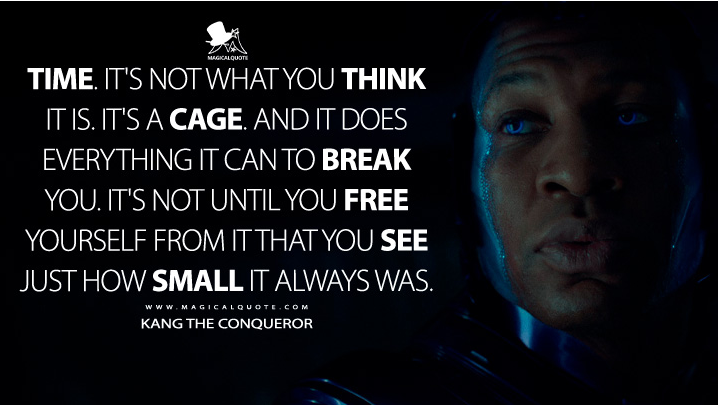

In [271]:
#https://stackoverflow.com/a/43807666

class FeaturesSelection:

  def SelectImpFeature(self,df,feature_importance,n_features):
    feature_df=pd.DataFrame(data = {"Feature Name": df.columns,"Feature Importance":feature_importance})
    feature_df = feature_df.sort_values("Feature Importance",ascending=False)[:n_features]
    fig,ax = plt.subplots(figsize=(14,12))
    ax = sns.barplot(x = "Feature Importance",y = "Feature Name",
                    data=feature_df,palette="nipy_spectral")
    plt.title('Feature Importances Selection Mappping')
    cmap = plt.get_cmap('inferno',n_features)
    minfi = min(feature_df['Feature Importance'])
    maxfi = max(feature_df['Feature Importance'])
    norm = mpl.colors.Normalize(vmin=minfi,vmax=maxfi)
    sm = plt.cm.ScalarMappable(cmap=cmap,norm=norm)
    sm.set_array([])
    ax.xaxis.grid()
    plt.show()
    return feature_df,df[feature_df['Feature Name']]


fs = FeaturesSelection()

In [272]:
from sklearn.preprocessing import RobustScaler,MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
X = feature_data.drop(['Date','next_day_closing_price'],axis=1)

scaler = RobustScaler()
X_scaled = X.copy()
X_scaled[X.columns] = scaler.fit_transform(X[X.columns])

scaler = MinMaxScaler()
X_scaled[X.columns] =  scaler.fit_transform(X_scaled[X.columns])
X_scaled

,opening_price,highest_price,lowest_price,closing_price,volume,transactions_in_blockchain,avg_block_size,unique_address,minning_difficulty,hash_rate,...,stdev90 top_100_total_percentage,stdev7 avg_fee_reward,stdev30 avg_fee_reward,stdev90 avg_fee_reward,stdev7 number_of_coins_in_circulation,stdev30 number_of_coins_in_circulation,stdev90 number_of_coins_in_circulation,stdev7 miner_revenue,stdev30 miner_revenue,stdev90 miner_revenue
252,0.036065,0.029546,0.032997,0.028623,0.041570,0.310275,0.544903,0.213459,0.002761,0.097557,...,0.000017,0.020150,0.034145,0.364395,0.920228,0.934562,1.000000,0.083553,0.070981,0.085996
253,0.039474,0.034881,0.040856,0.035451,0.038444,0.296344,0.247857,0.180693,0.002761,0.104230,...,0.000017,0.021636,0.037971,0.366774,0.934163,0.942558,0.999381,0.080536,0.065994,0.082720
254,0.045346,0.045052,0.047067,0.047515,0.064692,0.396745,0.500202,0.370682,0.002761,0.073830,...,0.000017,0.008705,0.036924,0.367862,0.846753,0.944732,0.997962,0.095125,0.070547,0.077722
255,0.047143,0.044865,0.046367,0.047561,0.064539,0.372989,0.722470,0.376143,0.002761,0.078526,...,0.000017,0.024502,0.037284,0.366619,0.848629,0.948174,0.997113,0.093604,0.069666,0.073819
256,0.052249,0.045366,0.052329,0.047202,0.046449,0.303190,0.545724,0.270298,0.002761,0.073666,...,0.000017,0.024204,0.038193,0.368373,0.850001,0.953156,0.995945,0.068059,0.068146,0.068718
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
725,0.367650,0.360425,0.376127,0.362359,0.013532,0.295778,0.661587,0.475962,0.955102,0.873511,...,1.000000,0.091570,0.093535,0.703830,0.187542,0.119976,0.042501,0.055726,0.110152,0.041850
726,0.376137,0.363658,0.386640,0.365076,0.000207,0.219251,0.767339,0.412528,0.955102,0.976964,...,1.000000,0.088612,0.095730,0.702526,0.204302,0.121895,0.042229,0.120197,0.118561,0.040651
727,0.370275,0.358646,0.377032,0.355811,0.010136,0.291496,0.621707,0.451223,0.955102,1.000000,...,1.000000,0.094110,0.097124,0.702222,0.227631,0.123608,0.041982,0.130011,0.121618,0.040012
728,0.356564,0.348644,0.366637,0.347334,0.025207,0.281653,0.814795,0.527955,0.955102,0.888672,...,1.000000,0.061410,0.094778,0.700685,0.259098,0.126153,0.041835,0.134306,0.108216,0.040286


In [273]:
y = feature_data['next_day_closing_price']
rf = RandomForestRegressor(n_estimators=100,n_jobs=-1,bootstrap=True,
                           verbose=5,random_state=1)
rf.fit(X_scaled,y)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.


building tree 1 of 100
building tree 2 of 100
building tree 3 of 100
building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100
building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100
building tree 13 of 100
building tree 14 of 100
building tree 15 of 100
building tree 16 of 100
building tree 17 of 100
building tree 18 of 100


[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    0.5s


building tree 19 of 100
building tree 20 of 100
building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100
building tree 30 of 100
building tree 31 of 100building tree 32 of 100

building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100
building tree 38 of 100
building tree 39 of 100
building tree 40 of 100
building tree 41 of 100
building tree 42 of 100
building tree 43 of 100
building tree 44 of 100
building tree 45 of 100
building tree 46 of 100
building tree 47 of 100
building tree 48 of 100
building tree 49 of 100
building tree 50 of 100
building tree 51 of 100
building tree 52 of 100
building tree 53 of 100
building tree 54 of 100
building tree 55 of 100
building tree 56 of 100
building tree 57 of 100
building tree 58 of 100
building tree 59 of 100
building tree 60

[Parallel(n_jobs=-1)]: Done  68 tasks      | elapsed:    2.4s


building tree 76 of 100
building tree 77 of 100
building tree 78 of 100
building tree 79 of 100
building tree 80 of 100
building tree 81 of 100
building tree 82 of 100
building tree 83 of 100
building tree 84 of 100
building tree 85 of 100
building tree 86 of 100
building tree 87 of 100
building tree 88 of 100
building tree 89 of 100
building tree 90 of 100
building tree 91 of 100
building tree 92 of 100
building tree 93 of 100
building tree 94 of 100
building tree 95 of 100
building tree 96 of 100
building tree 97 of 100
building tree 98 of 100
building tree 99 of 100
building tree 100 of 100


[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    3.5s finished


RandomForestRegressor(n_jobs=-1, random_state=1, verbose=5)

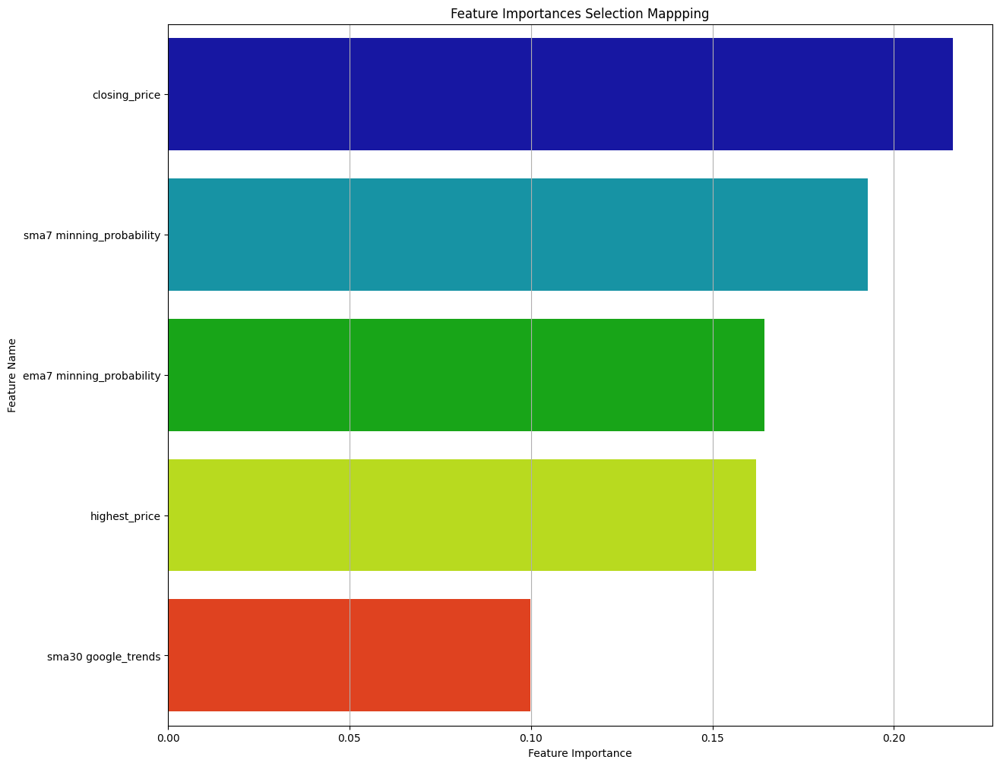

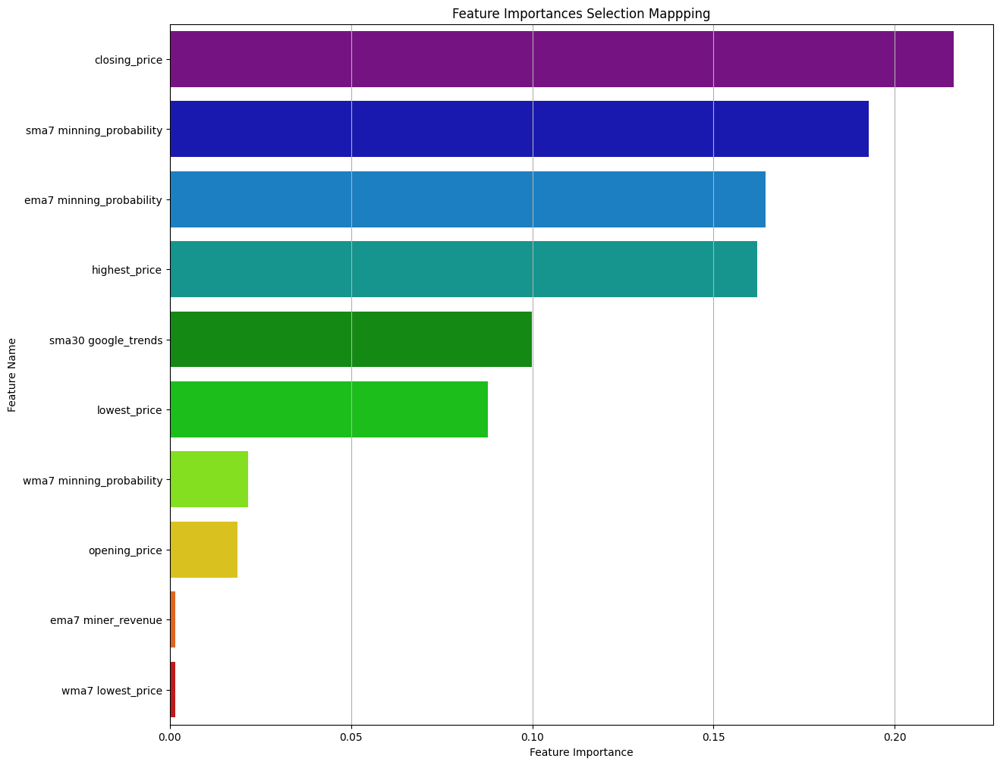

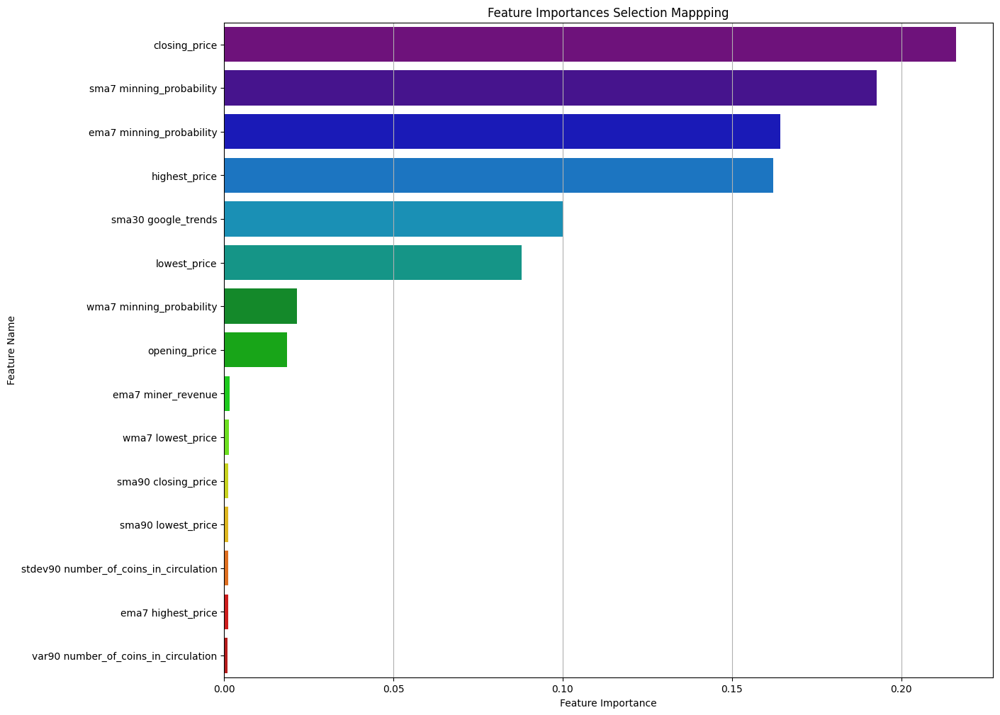

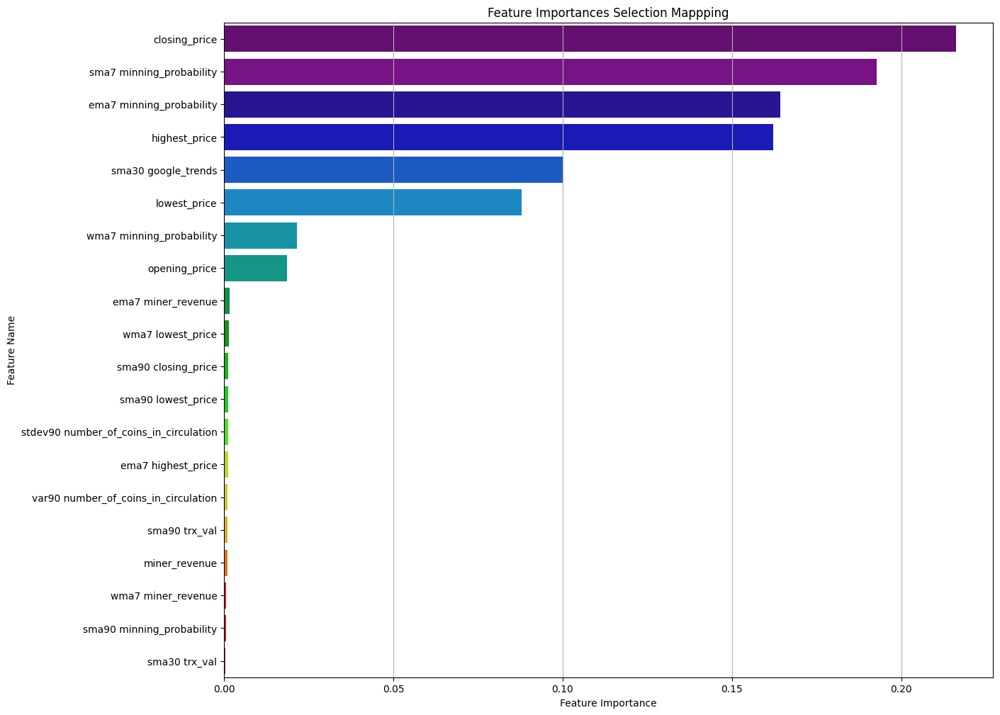

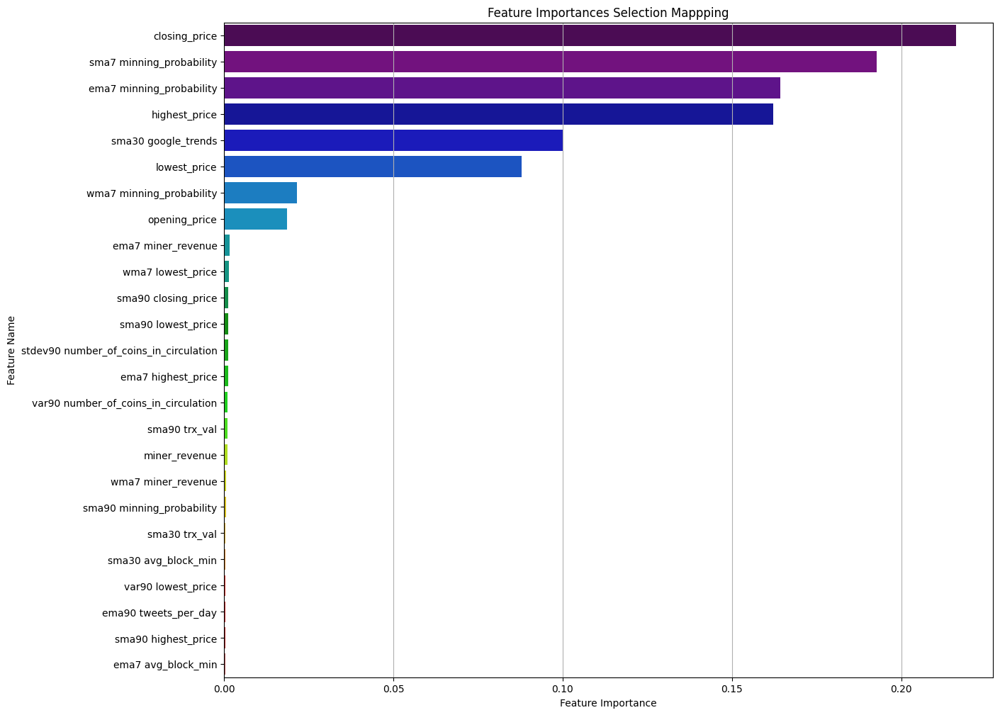

...

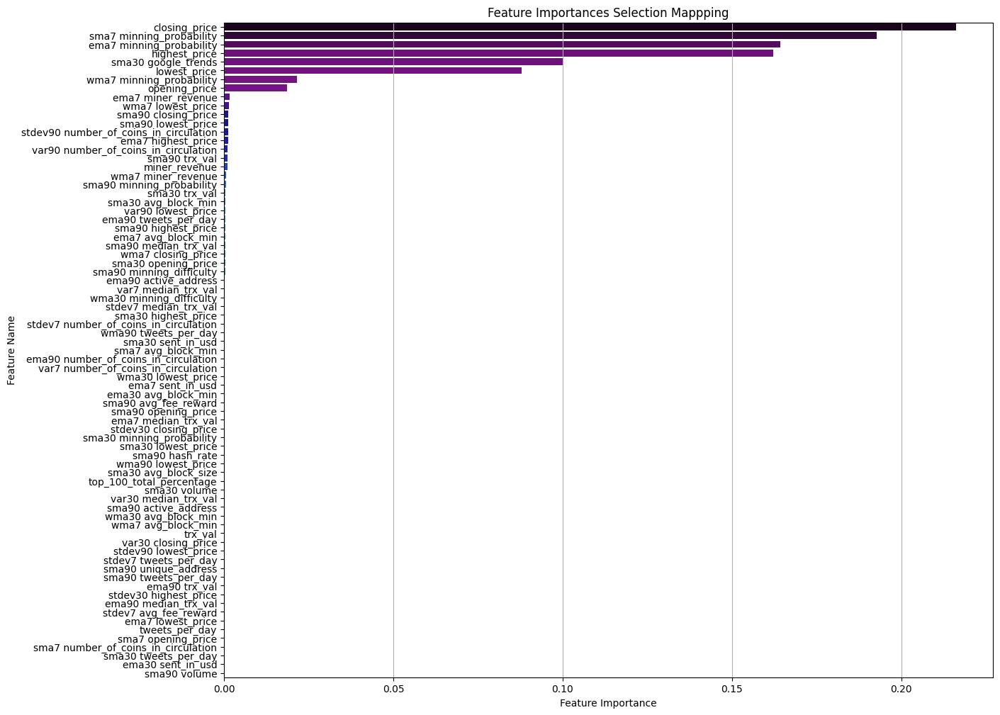

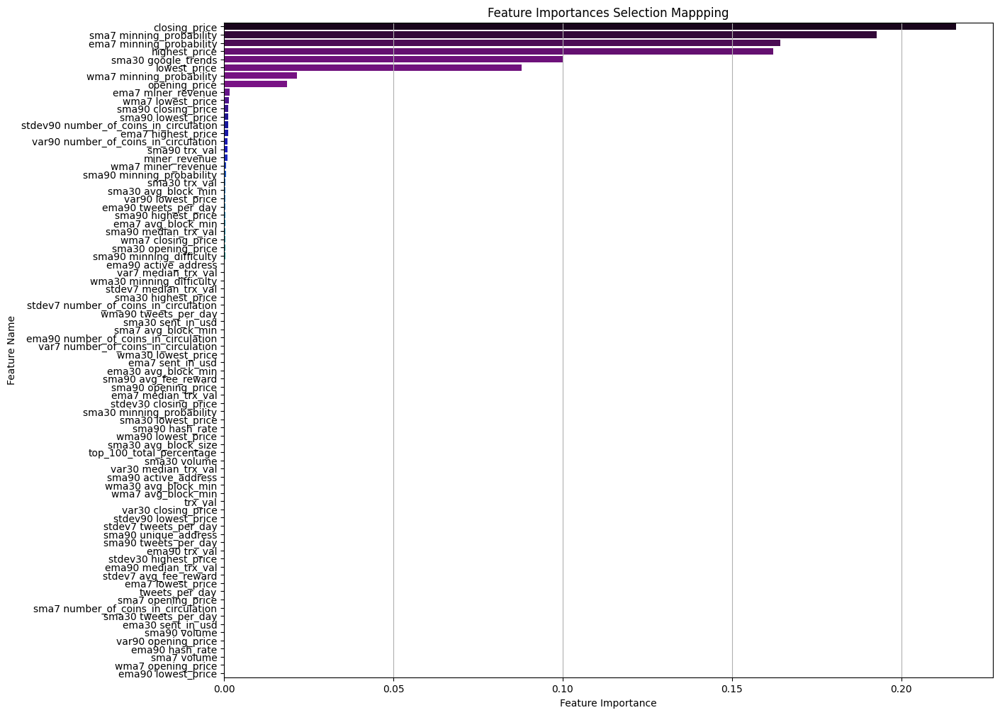

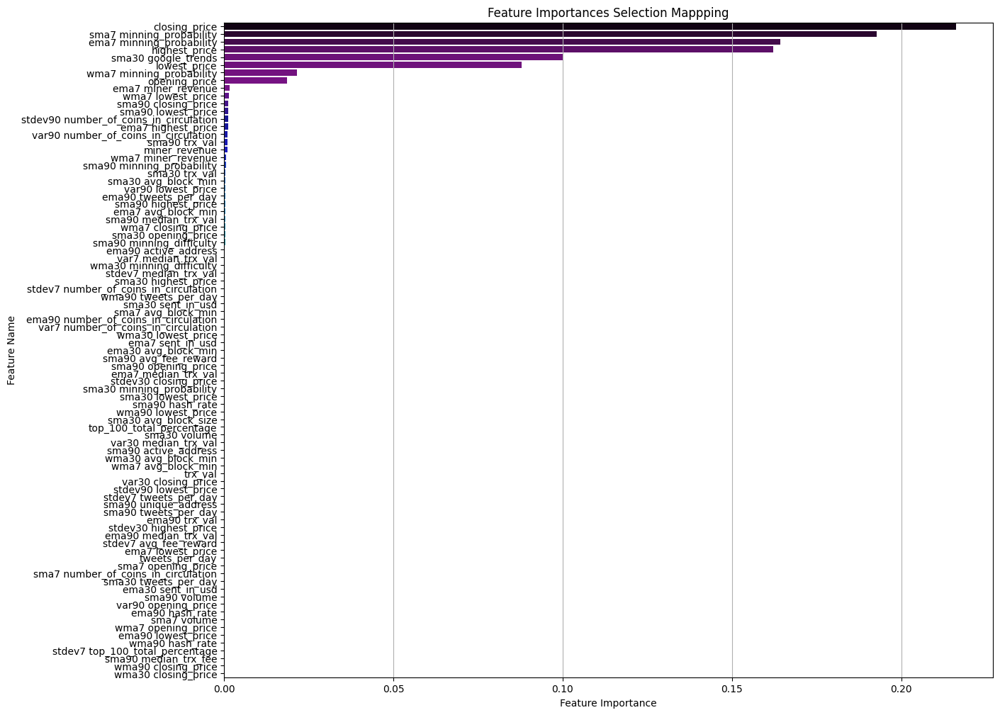

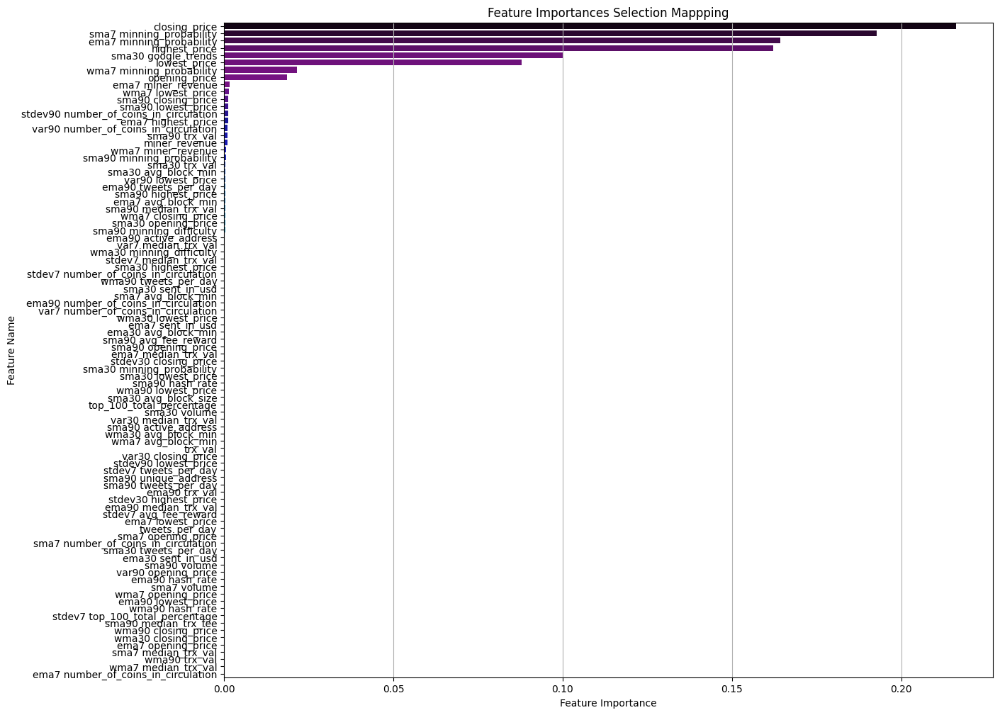

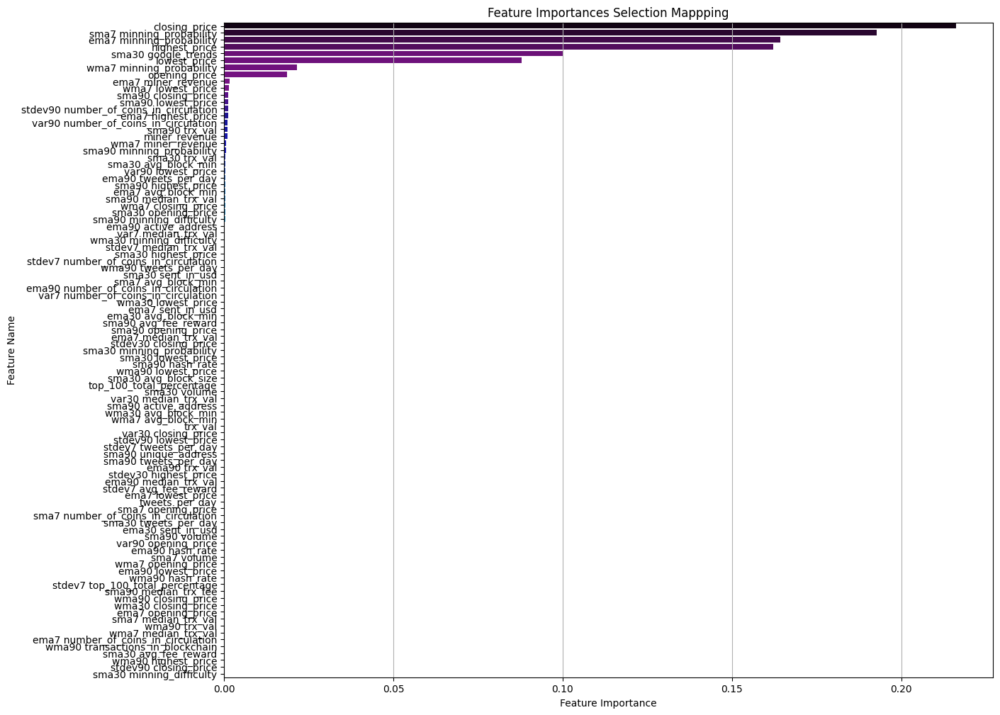

In [334]:
feat_range = list(range(5,100,5))
for i in feat_range:
    feat_imp_df,final_df_next_day = fs.SelectImpFeature(X_scaled,rf.feature_importances_,i)
    final_df_next_day.insert(loc=0, column='Date', value=feature_data['Date'])
    final_df_next_day['next_day_closing_price'] = feature_data['next_day_closing_price']
    feat_imp_df.to_csv(f'/content/drive/MyDrive/Colab Notebooks/data/feature_imp/feature_imp_20180101_{i}.csv',index=False)
    final_df_next_day.to_csv(f'/content/drive/MyDrive/Colab Notebooks/data/next_day/final_df_next_day_20180101{i}.csv',index=False)



# **Regression Modeling Using Sklearn Library**

In [336]:
final_df=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/data/next_day/final_df_next_day_2018010155.csv',sep=',',encoding='UTF-8')
final_df

,Date,closing_price,sma7 minning_probability,ema7 minning_probability,highest_price,sma30 google_trends,lowest_price,wma7 minning_probability,opening_price,ema7 miner_revenue,...,stdev30 closing_price,sma30 minning_probability,sma30 lowest_price,sma90 hash_rate,wma90 lowest_price,sma30 avg_block_size,top_100_total_percentage,sma30 volume,var30 median_trx_val,next_day_closing_price
0,2020-01-02,0.028623,0.234187,0.231479,0.029546,0.104188,0.032997,0.227890,0.036065,0.083928,...,0.047426,0.318140,0.006421,0.000000,0.019387,0.426829,0.000009,0.157059,0.049965,7411.317327
1,2020-01-05,0.035451,0.233349,0.228008,0.034881,0.103733,0.040856,0.224065,0.039474,0.092740,...,0.047177,0.311548,0.005667,0.002636,0.018758,0.411278,0.000009,0.158149,0.054510,8163.692239
2,2020-01-07,0.047515,0.248019,0.253135,0.045052,0.106625,0.047067,0.247224,0.045346,0.109487,...,0.046976,0.312571,0.005310,0.004895,0.018315,0.422981,0.000009,0.165890,0.046456,8166.554140
3,2020-01-10,0.047561,0.245924,0.251745,0.044865,0.107473,0.046367,0.247224,0.047143,0.112529,...,0.046935,0.309161,0.004989,0.007161,0.017834,0.431128,0.000009,0.172873,0.047482,8144.194517
4,2020-01-13,0.047202,0.245085,0.249953,0.045366,0.107572,0.052329,0.247017,0.052249,0.110704,...,0.047028,0.307115,0.005114,0.009355,0.017529,0.434510,0.000009,0.176408,0.044406,8723.785766
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
473,2023-10-04,0.362359,0.015509,0.005855,0.360425,0.001268,0.376127,0.011962,0.367650,0.288737,...,0.126482,0.006035,0.421969,0.973943,0.479202,0.580454,0.000007,0.004271,0.103978,27968.838871
474,2023-10-07,0.365076,0.017479,0.010674,0.363658,0.000578,0.386640,0.015612,0.376137,0.316941,...,0.119583,0.004717,0.420309,0.981155,0.479950,0.585111,0.000006,0.000000,0.145174,27391.019517
475,2023-10-10,0.355811,0.014964,0.009043,0.358646,0.000000,0.377032,0.013709,0.370275,0.327659,...,0.112411,0.003126,0.418224,0.989124,0.480347,0.580567,0.000007,0.001015,0.173212,26862.375446
476,2023-10-13,0.347334,0.009808,0.004446,0.348644,0.306987,0.366637,0.009171,0.356564,0.314803,...,0.107206,0.001068,0.416204,0.994680,0.480382,0.588837,0.000007,0.002064,0.216251,28519.466679


# **Train Test Split**

In [355]:
train_row = 400
test_row = 50
train_splits = []
test_splits = []
for i in tqdm(range(train_row, len(final_df),test_row)):
    train_split = final_df[i-train_row:i]
    test_split = final_df[i:i+test_row]
    train_splits.append(train_split)
    test_splits.append(test_split)



  0%|          | 0/2 [00:00<?, ?it/s]

In [356]:
class MetricsAndPlotting:

  def MAPE(self,y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

  def GetMetrics(self,y, ypred):
    MAE = metrics.mean_absolute_error(y, ypred)
    RMSE = metrics.mean_squared_error(y, ypred,squared=False)
    return MAE,RMSE

  def PlotMetricResults(self,y,ypred,title=None):
    plt.figure(figsize=(25,5))
    plt.plot(y,label='Actual')
    plt.plot(ypred,label='Predicted')
    plt.legend()
    plt.grid()
    plt.title(title)
    plt.show()

  def PlotDataSplits(self,batch,final_df=final_df):
    final_df.plot.line(x='Date',y='next_day_closing_price',figsize=(25,5))

    for i in range(train_splits[batch].index[0],train_splits[batch].index[-1]):
      plt.axvline(x=i,color='#ff6666',alpha=0.1)

    for i in range(test_splits[batch].index[0],test_splits[batch].index[-1]):
      plt.axvline(x=i,color='#99ccff',alpha=0.1)
    plt.grid()
    plt.legend('')
    plt.title(f'Temporal Window Split-{batch+1}')
    plt.savefig(f'/content/drive/MyDrive/Colab Notebooks/plot-{batch+1}.png')
    plt.show()



mp = MetricsAndPlotting()

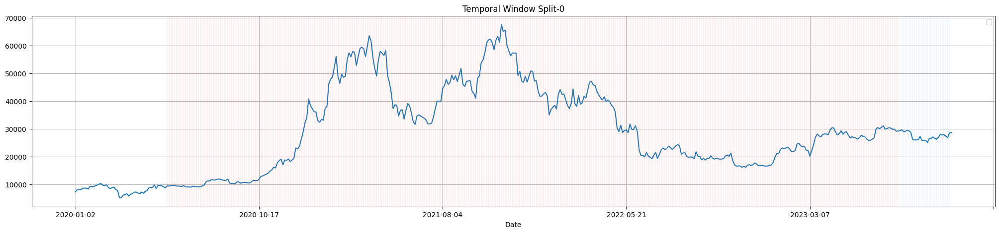

In [357]:
mp.PlotDataSplits(-1)



# **Regression Modelling :)**

## **Dummy Regressor**

In [358]:
# https://www.geeksforgeeks.org/dummy-regressor/

class DmyRegressor:

  def __init__(self):
    self.dmy_date_array = []
    self.dmy_y_test_array = []
    self.dmy_y_test_pred_array = []
    self.dmy_batch_id_array = []
    self.dmy_batch_id_array_result = []
    self.dmy_batch_mae_train_array = []
    self.dmy_batch_rmse_train_array = []
    self.dmy_batch_mae_test_array = []
    self.dmy_batch_rmse_test_array = []


  def DmyRegression(self):
    for i in tqdm(range(len(train_splits))):

      Xtrain_split = train_splits[i].drop(['next_day_closing_price','Date'],axis=1).values
      Xtest_split = test_splits[i].drop(['next_day_closing_price','Date'],axis=1).values

      ytrain_split = train_splits[i]['next_day_closing_price'].reset_index(drop=True).values
      ytest_split = test_splits[i]['next_day_closing_price'].reset_index(drop=True).values

      dmy = DummyRegressor(strategy = 'quantile',quantile=0.5)
      dmy.fit(Xtrain_split, ytrain_split)

      ytrain_pred = dmy.predict(Xtrain_split)
      ytest_pred = dmy.predict(Xtest_split)

      MAE_train,RMSE_train = mp.GetMetrics(ytrain_split,ytrain_pred)
      MAE_test,RMSE_test = mp.GetMetrics(ytest_split,ytest_pred)

      self.dmy_date_array.extend(test_splits[i]['Date'])
      self.dmy_y_test_array.extend(test_splits[i]['next_day_closing_price'])
      self.dmy_y_test_pred_array.extend((ytest_pred.flatten()))
      self.dmy_batch_id_array.extend([i]*len(test_splits[i]))

      self.dmy_batch_id_array_result.append(i)
      self.dmy_batch_mae_train_array.append(MAE_train)
      self.dmy_batch_rmse_train_array.append(RMSE_train)

      self.dmy_batch_mae_test_array.append(MAE_test)
      self.dmy_batch_rmse_test_array.append(RMSE_test)

    dmy_result_test_df = pd.DataFrame()
    dmy_result_test_df['batch_id'] = self.dmy_batch_id_array
    dmy_result_test_df['Date'] = self.dmy_date_array
    dmy_result_test_df['y_test'] = self.dmy_y_test_array
    dmy_result_test_df['y_test_pred'] = self.dmy_y_test_pred_array
    dmy_y_test_array = dmy_result_test_df['y_test']
    dmy_y_test_pred_array = dmy_result_test_df['y_test_pred']
    dmy_result_metrics_df = pd.DataFrame()
    dmy_result_metrics_df['batch_id'] = self.dmy_batch_id_array_result
    dmy_result_metrics_df['mae_train'] = self.dmy_batch_mae_train_array
    dmy_result_metrics_df['rmse_train'] = self.dmy_batch_rmse_train_array
    dmy_result_metrics_df['mae_test'] = self.dmy_batch_mae_test_array
    dmy_result_metrics_df['rmse_test'] = self.dmy_batch_rmse_test_array

    return dmy_result_metrics_df,dmy_y_test_array,dmy_y_test_pred_array


dr = DmyRegressor()


In [359]:
dmy_result_metrics_df,dmy_y_test_array,dmy_y_test_pred_array=dr.DmyRegression()

  0%|          | 0/2 [00:00<?, ?it/s]

In [360]:
dmy_result_metrics_df

,batch_id,mae_train,rmse_train,mae_test,rmse_test
0,0,14367.200421,17545.329687,5061.322566,5328.654518
1,1,12426.218715,15037.964557,1696.771480,2003.456896


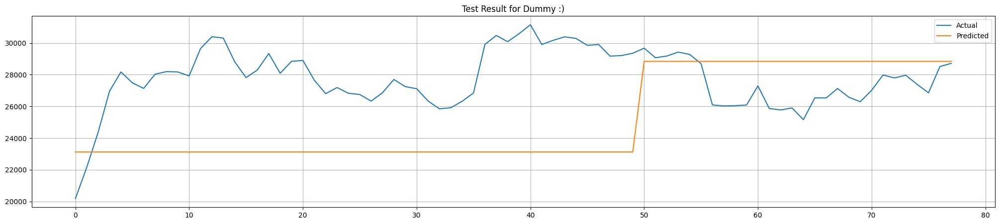

In [361]:
mp.PlotMetricResults(dmy_y_test_array,dmy_y_test_pred_array,"Test Result for Dummy :)")

In [362]:
pd.DataFrame(dmy_result_metrics_df.mean()).drop(['batch_id'],axis=0)

,0
mae_train,13396.709568
rmse_train,16291.647122
mae_test,3379.047023
rmse_test,3666.055707


In [363]:
dmy_result_metrics_df.to_csv('/content/drive/MyDrive/Colab Notebooks/data/dmy_result_metrics.csv')

## **Support Vector  Regressor**

In [364]:
class SVRRegression:

  def __init__(self):
    self.svr_date_array = []
    self.svr_y_test_array = []
    self.svr_y_test_pred_array = []
    self.svr_batch_id_array = []
    self.svr_batch_id_array_result = []
    self.svr_batch_mae_train_array = []
    self.svr_batch_rmse_train_array = []
    self.svr_batch_mae_test_array = []
    self.svr_batch_rmse_test_array = []

  def SvrRegression(self):
    for i in tqdm(range(len(train_splits))):
      Xtrain_split = train_splits[i].drop(['next_day_closing_price','Date'],axis=1).values
      Xtest_split = test_splits[i].drop(['next_day_closing_price','Date'],axis=1).values
      ytrain_split = train_splits[i]['next_day_closing_price'].reset_index(drop=True).values
      ytest_split = test_splits[i]['next_day_closing_price'].reset_index(drop=True).values
      svr = SVR(C=10000,gamma='auto',kernel='rbf')
      svr.fit(Xtrain_split, ytrain_split)
      ytrain_pred = svr.predict(Xtrain_split)
      ytest_pred = svr.predict(Xtest_split)
      MAE_train,RMSE_train = mp.GetMetrics(ytrain_split,ytrain_pred)
      MAE_test,RMSE_test = mp.GetMetrics(ytest_split,ytest_pred)
      self.svr_date_array.extend(test_splits[i]['Date'])
      self.svr_y_test_array.extend(test_splits[i]['next_day_closing_price'])
      self.svr_y_test_pred_array.extend((ytest_pred.flatten()))
      self.svr_batch_id_array.extend([i]*len(test_splits[i]))
      self.svr_batch_id_array_result.append(i)
      self.svr_batch_mae_train_array.append(MAE_train)
      self.svr_batch_rmse_train_array.append(RMSE_train)
      self.svr_batch_mae_test_array.append(MAE_test)
      self.svr_batch_rmse_test_array.append(RMSE_test)

    svr_result_test_df = pd.DataFrame()
    svr_result_test_df['batch_id'] = self.svr_batch_id_array
    svr_result_test_df['Date'] = self.svr_date_array
    svr_result_test_df['y_test'] = self.svr_y_test_array
    svr_result_test_df['y_test_pred'] = self.svr_y_test_pred_array
    svr_y_test_array = svr_result_test_df['y_test']
    svr_y_test_pred_array = svr_result_test_df['y_test_pred']
    svr_result_metrics_df = pd.DataFrame()
    svr_result_metrics_df['batch_id'] = self.svr_batch_id_array_result
    svr_result_metrics_df['mae_train'] = self.svr_batch_mae_train_array
    svr_result_metrics_df['rmse_train'] = self.svr_batch_rmse_train_array
    svr_result_metrics_df['mae_test'] = self.svr_batch_mae_test_array
    svr_result_metrics_df['rmse_test'] = self.svr_batch_rmse_test_array

    return svr_result_metrics_df,svr_y_test_array,svr_y_test_pred_array


svr = SVRRegression()

In [365]:
svr_result_metrics_df,svr_y_test_array,svr_y_test_pred_array=svr.SvrRegression()

  0%|          | 0/2 [00:00<?, ?it/s]

In [366]:
svr_result_metrics_df

,batch_id,mae_train,rmse_train,mae_test,rmse_test
0,0,1648.174560,2506.144223,2240.493102,2561.726080
1,1,1703.111908,2513.314885,739.531283,972.830214


In [367]:
svr_result_metrics_df.to_csv('/content/drive/MyDrive/Colab Notebooks/data/svr_result_metrics.csv')

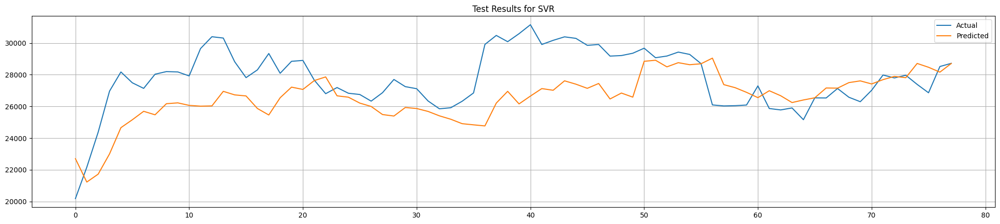

In [368]:
mp.PlotMetricResults(svr_y_test_array,svr_y_test_pred_array,"Test Results for SVR")

## **Linear Regression**

In [369]:
class Linear:

  def __init__(self):

    self.lr_date_array = []
    self.lr_y_test_array = []
    self.lr_y_test_pred_array = []
    self.lr_batch_id_array = []
    self.lr_batch_id_array_result = []
    self.lr_batch_mae_train_array = []
    self.lr_batch_rmse_train_array = []
    self.lr_batch_mae_test_array = []
    self.lr_batch_rmse_test_array = []


  def StochasticGradientDescent(self):
    for i in tqdm(range(len(train_splits))):
      Xtrain_split = train_splits[i].drop(['next_day_closing_price','Date'],axis=1)
      Xtest_split = test_splits[i].drop(['next_day_closing_price','Date'],axis=1)
      ytrain_split = train_splits[i]['next_day_closing_price'].reset_index(drop=True).values
      ytest_split = test_splits[i]['next_day_closing_price'].reset_index(drop=True).values
      sgd_reg = SGDRegressor(loss='squared_epsilon_insensitive',alpha=0.0001,penalty='elasticnet',shuffle=True,
                           tol=0.000001,l1_ratio=0.15,epsilon=0.01,learning_rate='adaptive',max_iter=1000,eta0 =0.01)
      sgd_reg.fit(Xtrain_split, ytrain_split)

    #pickle.dump(sgd_reg, open(f'/content/drive/MyDrive/Self Case studies/CS01 Bitcoin Price Forecasting/Linear Regression Model/linear_reg_10_{i}.sav', 'wb'))

      ytrain_pred = sgd_reg.predict(Xtrain_split)
      ytest_pred = sgd_reg.predict(Xtest_split)

      MAE_train,RMSE_train = mp.GetMetrics(ytrain_split,ytrain_pred)
      MAE_test,RMSE_test = mp.GetMetrics(ytest_split,ytest_pred)

      self.lr_date_array.extend(test_splits[i]['Date'])
      self.lr_y_test_array.extend(test_splits[i]['next_day_closing_price'])
      self.lr_y_test_pred_array.extend((ytest_pred.flatten()))
      self.lr_batch_id_array.extend([i]*len(test_splits[i]))

      self.lr_batch_id_array_result.append(i)
      self.lr_batch_mae_train_array.append(MAE_train)
      self.lr_batch_rmse_train_array.append(RMSE_train)
      self.lr_batch_mae_test_array.append(MAE_test)
      self.lr_batch_rmse_test_array.append(RMSE_test)

    lr_result_test_df = pd.DataFrame()
    lr_result_test_df['batch_id'] = self.lr_batch_id_array
    lr_result_test_df['Date'] = self.lr_date_array
    lr_result_test_df['y_test'] = self.lr_y_test_array
    lr_result_test_df['y_test_pred'] = self.lr_y_test_pred_array
    lr_y_test_array = lr_result_test_df['y_test']
    lr_y_test_pred_array = lr_result_test_df['y_test_pred']

    lr_result_metrics_df = pd.DataFrame()
    lr_result_metrics_df['batch_id'] = self.lr_batch_id_array_result
    lr_result_metrics_df['mae_train'] = self.lr_batch_mae_train_array
    lr_result_metrics_df['rmse_train'] = self.lr_batch_rmse_train_array
    lr_result_metrics_df['mae_test'] = self.lr_batch_mae_test_array
    lr_result_metrics_df['rmse_test'] = self.lr_batch_rmse_test_array

    return lr_result_metrics_df,lr_y_test_array,lr_y_test_pred_array

lr = Linear()



In [370]:
lr_result_metrics_df,lr_y_test_array,lr_y_test_pred_array=lr.StochasticGradientDescent()


  0%|          | 0/2 [00:00<?, ?it/s]

In [371]:
lr_result_metrics_df

,batch_id,mae_train,rmse_train,mae_test,rmse_test
0,0,1415.196786,2028.826902,2470.183243,2846.2931
1,1,1486.644467,2095.348433,715.962447,983.5675


In [372]:
lr_result_metrics_df.to_csv('/content/drive/MyDrive/Colab Notebooks/data/lr_result_metrics.csv')

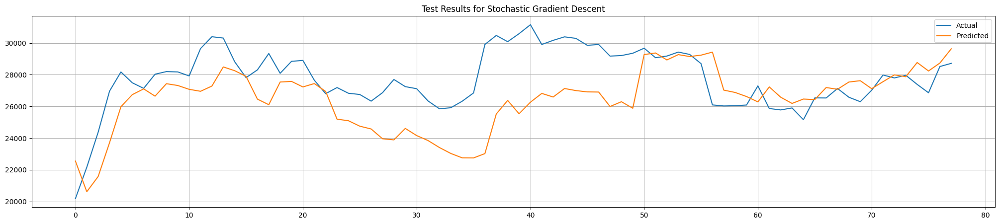

In [373]:
mp.PlotMetricResults(lr_y_test_array,lr_y_test_pred_array,"Test Results for Stochastic Gradient Descent")

## **Regression Using XGBoost Library**

In [407]:
class XGB:

  def __init__(self):

    self.xgb_date_array = []
    self.xgb_y_test_array = []
    self.xgb_y_test_pred_array = []
    self.xgb_batch_id_array = []
    self.xgb_batch_id_array_result = []
    self.xgb_batch_mae_train_array = []
    self.xgb_batch_rmse_train_array = []
    self.xgb_batch_mape_train_array = []
    self.xgb_batch_mae_test_array = []
    self.xgb_batch_rmse_test_array = []
    self.xgb_batch_mape_test_array = []



  def XGRegression(self):
    for i in tqdm(range(len(train_splits))):
      Xtrain_split = train_splits[i].drop(['next_day_closing_price','Date'],axis=1)
      Xtest_split = test_splits[i].drop(['next_day_closing_price','Date'],axis=1)
      ytrain_split = train_splits[i]['next_day_closing_price'].reset_index(drop=True).values
      ytest_split = test_splits[i]['next_day_closing_price'].reset_index(drop=True).values

      xgbm_reg = xgb.XGBRegressor(n_estimators=500,max_depth=3,objective='reg:squarederror',
                                learning_rate =0.01,n_jobs=-1)
      xgbm_reg.fit(Xtrain_split, ytrain_split)

      ytrain_pred = xgbm_reg.predict(Xtrain_split)
      ytest_pred = xgbm_reg.predict(Xtest_split)

      MAE_train,RMSE_train = mp.GetMetrics(ytrain_split,ytrain_pred)
      MAE_test,RMSE_test = mp.GetMetrics(ytest_split,ytest_pred)

      self.xgb_date_array.extend(test_splits[i]['Date'])
      self.xgb_y_test_array.extend(test_splits[i]['next_day_closing_price'])
      self.xgb_y_test_pred_array.extend((ytest_pred.flatten()))
      self.xgb_batch_id_array.extend([i]*len(test_splits[i]))

      self.xgb_batch_id_array_result.append(i)
      self.xgb_batch_mae_train_array.append(MAE_train)
      self.xgb_batch_rmse_train_array.append(RMSE_train)
      self.xgb_batch_mae_test_array.append(MAE_test)
      self.xgb_batch_rmse_test_array.append(RMSE_test)

    xgb_result_test_df = pd.DataFrame()
    xgb_result_test_df['batch_id'] = self.xgb_batch_id_array
    xgb_result_test_df['Date'] = self.xgb_date_array
    xgb_result_test_df['y_test'] = self.xgb_y_test_array
    xgb_result_test_df['y_test_pred'] =self.xgb_y_test_pred_array
    xgb_y_test_array = xgb_result_test_df['y_test']
    xgb_y_test_pred_array = xgb_result_test_df['y_test_pred']
    xgb_result_metrics_df = pd.DataFrame()
    xgb_result_metrics_df['batch_id'] = self.xgb_batch_id_array_result
    xgb_result_metrics_df['mae_train'] = self.xgb_batch_mae_train_array
    xgb_result_metrics_df['rmse_train'] = self.xgb_batch_rmse_train_array
    xgb_result_metrics_df['mae_test'] = self.xgb_batch_mae_test_array
    xgb_result_metrics_df['rmse_test'] = self.xgb_batch_rmse_test_array


    return xgb_result_metrics_df,xgb_y_test_array,xgb_y_test_pred_array



xg = XGB()

In [408]:
xgb_result_metrics_df,xgb_y_test_array,xgb_y_test_pred_array=xg.XGRegression()

  0%|          | 0/2 [00:00<?, ?it/s]

In [409]:
xgb_result_metrics_df

,batch_id,mae_train,rmse_train,mae_test,rmse_test
0,0,781.546947,1132.253379,3651.380102,3880.995911
1,1,816.814950,1146.310212,727.105216,975.826709


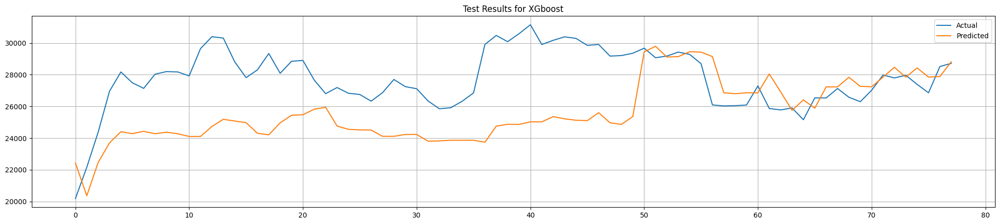

In [410]:
mp.PlotMetricResults(xgb_y_test_array,xgb_y_test_pred_array,"Test Results for XGboost")

## **Huber Regressor**

In [411]:
class Huber:

  def __init__(self):

    self.hub_date_array = []
    self.hub_y_test_array = []
    self.hub_y_test_pred_array = []
    self.hub_batch_id_array = []
    self.hub_batch_id_array_result = []
    self.hub_batch_mae_train_array = []
    self.hub_batch_rmse_train_array = []
    self.hub_batch_mape_train_array = []
    self.hub_batch_mae_test_array = []
    self.hub_batch_rmse_test_array = []
    self.hub_batch_mape_test_array = []



  def HuberRegression(self):
    for i in tqdm(range(len(train_splits))):
      Xtrain_split = train_splits[i].drop(['next_day_closing_price','Date'],axis=1)
      Xtest_split = test_splits[i].drop(['next_day_closing_price','Date'],axis=1)
      ytrain_split = train_splits[i]['next_day_closing_price'].reset_index(drop=True).values
      ytest_split = test_splits[i]['next_day_closing_price'].reset_index(drop=True).values

      hub_reg = HuberRegressor(epsilon=1.35)
      hub_reg.fit(Xtrain_split, ytrain_split)

      ytrain_pred = hub_reg.predict(Xtrain_split)
      ytest_pred = hub_reg.predict(Xtest_split)

      MAE_train,RMSE_train = mp.GetMetrics(ytrain_split,ytrain_pred)
      MAE_test,RMSE_test = mp.GetMetrics(ytest_split,ytest_pred)

      self.hub_date_array.extend(test_splits[i]['Date'])
      self.hub_y_test_array.extend(test_splits[i]['next_day_closing_price'])
      self.hub_y_test_pred_array.extend((ytest_pred.flatten()))
      self.hub_batch_id_array.extend([i]*len(test_splits[i]))

      self.hub_batch_id_array_result.append(i)
      self.hub_batch_mae_train_array.append(MAE_train)
      self.hub_batch_rmse_train_array.append(RMSE_train)
      self.hub_batch_mae_test_array.append(MAE_test)
      self.hub_batch_rmse_test_array.append(RMSE_test)

    hub_result_test_df = pd.DataFrame()
    hub_result_test_df['batch_id'] = self.hub_batch_id_array
    hub_result_test_df['Date'] = self.hub_date_array
    hub_result_test_df['y_test'] = self.hub_y_test_array
    hub_result_test_df['y_test_pred'] =self.hub_y_test_pred_array
    hub_y_test_array = hub_result_test_df['y_test']
    hub_y_test_pred_array = hub_result_test_df['y_test_pred']
    hub_result_metrics_df = pd.DataFrame()
    hub_result_metrics_df['batch_id'] = self.hub_batch_id_array_result
    hub_result_metrics_df['mae_train'] = self.hub_batch_mae_train_array
    hub_result_metrics_df['rmse_train'] = self.hub_batch_rmse_train_array
    hub_result_metrics_df['mae_test'] = self.hub_batch_mae_test_array
    hub_result_metrics_df['rmse_test'] = self.hub_batch_rmse_test_array


    return hub_result_metrics_df,hub_y_test_array,hub_y_test_pred_array



hub = Huber()

In [412]:
hub_result_metrics_df,hub_y_test_array,hub_y_test_pred_array=hub.HuberRegression()

  0%|          | 0/2 [00:00<?, ?it/s]

In [413]:
hub_result_metrics_df

,batch_id,mae_train,rmse_train,mae_test,rmse_test
0,0,1270.120867,1918.908110,1800.898340,2062.539133
1,1,1298.120429,1931.871742,730.443846,984.030890


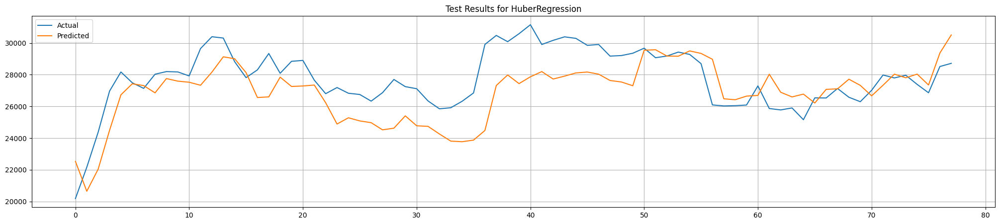

In [414]:
mp.PlotMetricResults(hub_y_test_array,hub_y_test_pred_array,"Test Results for HuberRegression")

## **QuantileRegression**



In [415]:
from sklearn.utils.fixes import sp_version, parse_version
class Quantile:

  def __init__(self):

    self.qt_date_array = []
    self.qt_y_test_array = []
    self.qt_y_test_pred_array = []
    self.qt_batch_id_array = []
    self.qt_batch_id_array_result = []
    self.qt_batch_mae_train_array = []
    self.qt_batch_rmse_train_array = []
    self.qt_batch_mape_train_array = []
    self.qt_batch_mae_test_array = []
    self.qt_batch_rmse_test_array = []
    self.qt_batch_mape_test_array = []



  def QuantileRegression(self):
    for i in tqdm(range(len(train_splits))):
      Xtrain_split = train_splits[i].drop(['next_day_closing_price','Date'],axis=1)
      Xtest_split = test_splits[i].drop(['next_day_closing_price','Date'],axis=1)
      ytrain_split = train_splits[i]['next_day_closing_price'].reset_index(drop=True).values
      ytest_split = test_splits[i]['next_day_closing_price'].reset_index(drop=True).values

      solver = "highs" if sp_version >= parse_version("1.6.0") else "interior-point"
      qt_reg =  QuantileRegressor(quantile=0.9,solver=solver)
      qt_reg.fit(Xtrain_split, ytrain_split)

      ytrain_pred = qt_reg.predict(Xtrain_split)
      ytest_pred = qt_reg.predict(Xtest_split)

      MAE_train,RMSE_train = mp.GetMetrics(ytrain_split,ytrain_pred)
      MAE_test,RMSE_test = mp.GetMetrics(ytest_split,ytest_pred)

      self.qt_date_array.extend(test_splits[i]['Date'])
      self.qt_y_test_array.extend(test_splits[i]['next_day_closing_price'])
      self.qt_y_test_pred_array.extend((ytest_pred.flatten()))
      self.qt_batch_id_array.extend([i]*len(test_splits[i]))

      self.qt_batch_id_array_result.append(i)
      self.qt_batch_mae_train_array.append(MAE_train)
      self.qt_batch_rmse_train_array.append(RMSE_train)
      self.qt_batch_mae_test_array.append(MAE_test)
      self.qt_batch_rmse_test_array.append(RMSE_test)

    qt_result_test_df = pd.DataFrame()
    qt_result_test_df['batch_id'] = self.qt_batch_id_array
    qt_result_test_df['Date'] = self.qt_date_array
    qt_result_test_df['y_test'] = self.qt_y_test_array
    qt_result_test_df['y_test_pred'] =self.qt_y_test_pred_array
    qt_y_test_array = qt_result_test_df['y_test']
    qt_y_test_pred_array = qt_result_test_df['y_test_pred']
    qt_result_metrics_df = pd.DataFrame()
    qt_result_metrics_df['batch_id'] = self.qt_batch_id_array_result
    qt_result_metrics_df['mae_train'] = self.qt_batch_mae_train_array
    qt_result_metrics_df['rmse_train'] = self.qt_batch_rmse_train_array
    qt_result_metrics_df['mae_test'] = self.qt_batch_mae_test_array
    qt_result_metrics_df['rmse_test'] = self.qt_batch_rmse_test_array


    return qt_result_metrics_df,qt_y_test_array,qt_y_test_pred_array



qt = Quantile()

In [416]:
qt_result_metrics_df,qt_y_test_array,qt_y_test_pred_array=qt.QuantileRegression()

  0%|          | 0/2 [00:00<?, ?it/s]

In [417]:
qt_result_metrics_df

,batch_id,mae_train,rmse_train,mae_test,rmse_test
0,0,25451.707593,29423.710918,24741.216069,24828.651950
1,1,22981.849914,26364.094202,25453.756416,25486.967491


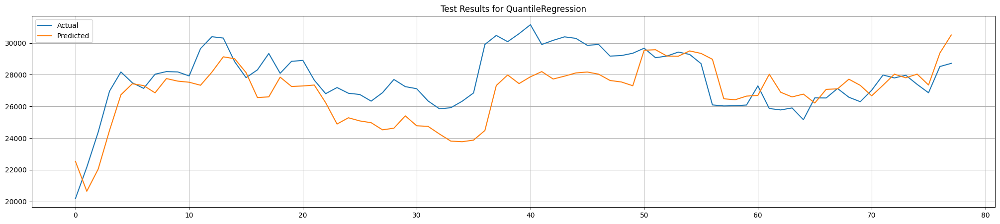

In [418]:
mp.PlotMetricResults(hub_y_test_array,hub_y_test_pred_array,"Test Results for QuantileRegression")

# **Refernce and Motivation**

https://en.bitcoinwiki.org/wiki/Main_Page

https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7256561/

https://www.mdpi.com/2571-9394/5/1/10

https://www.coindesk.com/markets/2016/12/31/not-just-bitcoin-the-top-7-cryptocurrencies-all-gained-in-2016/

https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.plot.html

https://medium.com/@HalderNilimesh/applied-data-science-for-beginners-how-to-calculate-moving-average-using-pandas-dataframe-in-7e5f7944c07a

https://stackoverflow.com/a/43807666

https://www.geeksforgeeks.org/dummy-regressor/


https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html#sklearn-ensemble-randomforestregressor


https://coinmarketcap.com/api/documentation/v1/#section/Standards-and-Conventions
